In [ ]:
from keras.datasets import cifar10
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Layer
from tensorflow.keras.layers import (Reshape,Dropout, Conv2DTranspose, Add, Conv2D, MaxPool2D, Dense,
                                     Flatten, InputLayer, BatchNormalization, Input, LeakyReLU )
from tensorflow.keras.optimizers import Adam

In [ ]:
#loading the cifar 10 dataset
cifar10_data = cifar10.load_data()
# splitting into train and test sets
(X_train, y_train), (X_test, y_test) = cifar10_data

In [ ]:
# shapes of training and testing datapoints
X_train[0].shape, y_train[0].shape, X_train.shape

((32, 32, 3), (1,), (50000, 32, 32, 3))

In [ ]:
# class names
class_names = []

/usr/local/lib/python3.10/dist-packages/matplotlib/text.py:1279: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if s != self._text:


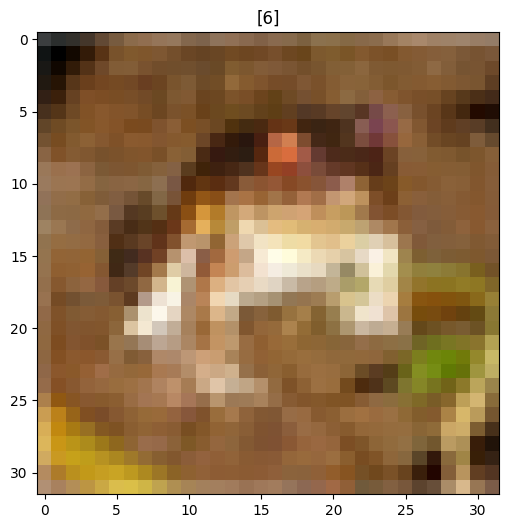

In [ ]:
# visualize the images and labels
plt.figure(figsize=(6,6))
plt.imshow(X_train[0])
plt.title(y_train[0])
plt.show()

In [ ]:
def cifar10_dcgan_generator(input_random_noise_shape, z_random_noise_vect_dim):

  # start with random_noies_vect_dim (100, or 50,...)
  # input_random_noise_shape - preferably 7 * 7 * 128
  # convert it into a 2d output of shape (32,32,3) i.e (3072) pixels

  # 256 parallel version (like feature maps) of 4 * 4 images or 16 * 16 images

  # after each block reshape from 256 * 4 * 4 ----to----- 4 * 4 *  256
  generator_input = Input(shape=z_random_noise_vect_dim)
  x = Dense(256*4*4)(generator_input)
  x = LeakyReLU(alpha=0.2)(x)
  x = Reshape(input_random_noise_shape)(x)

  # now conv2d transpose for 4 * 4 * 256 to 8 * 8* 256
  x = Conv2DTranspose(128, (4,4), strides=(2,2), padding='same')(x)
  x = LeakyReLU(alpha=0.2)(x)

  # now conv2d transpose for  8 * 8* 256 to 16 * 16 * 256
  x = Conv2DTranspose(128, (4,4), strides=(2,2), padding='same')(x)
  x = LeakyReLU(alpha=0.2)(x)

  # now conv2d transpose for 16 * 16 * 256  o 32 * 32 * 256
  x = Conv2DTranspose(128, (4,4), strides=(2,2), padding='same')(x)
  x = LeakyReLU(alpha=0.2)(x)

  # add 3 color channels
  generator_output = Conv2D(3, (3,3), activation="tanh", padding='same')(x)

  return Model(inputs=generator_input, outputs=generator_output)

In [ ]:
generator_model = cifar10_dcgan_generator(input_random_noise_shape=(4,4,256), z_random_noise_vect_dim=100)
generator_model.summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 100)]             0         
                                                                 
 dense_2 (Dense)             (None, 4096)              413696    
                                                                 
 leaky_re_lu_8 (LeakyReLU)   (None, 4096)              0         
                                                                 
 reshape_1 (Reshape)         (None, 4, 4, 256)         0         
                                                                 
 conv2d_transpose_3 (Conv2D  (None, 8, 8, 128)         524416    
 Transpose)                                                      
                                                                 
 leaky_re_lu_9 (LeakyReLU)   (None, 8, 8, 128)         0         
                                                           

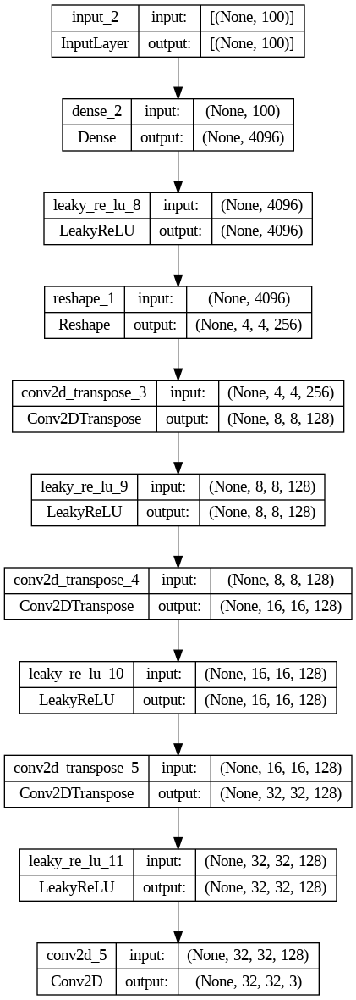

In [ ]:
from keras.utils import plot_model
plot_model(generator_model, show_shapes=True)

In [ ]:
def cifar10_dcgan_discriminator(input_img_shape):
  discriminator_model = tf.keras.Sequential([

  # 32, 32, 64
  Conv2D(64, (3,3), padding="same", input_shape=input_img_shape),
  LeakyReLU(alpha=0.2),

  # 32, 32, 64 -> 16, 16, 64
  Conv2D(128, (3,3),strides=(2,2),  padding="same"),
  LeakyReLU(alpha=0.2),

  #  16 * 16 * 128 -> 32, 32, 128
  Conv2D(128, (3,3),strides=(2,2), padding="same"),
  LeakyReLU(alpha=0.2),

  Conv2D(256, (3,3),strides=(2,2),  padding="same"),
  LeakyReLU(alpha=0.2),

  Flatten(),
  Dropout(0.4),
  Dense(1, activation="sigmoid")])

  return discriminator_model

In [ ]:
discriminator_model = cifar10_dcgan_discriminator((32,32,3))
# test_discriminator.summary()

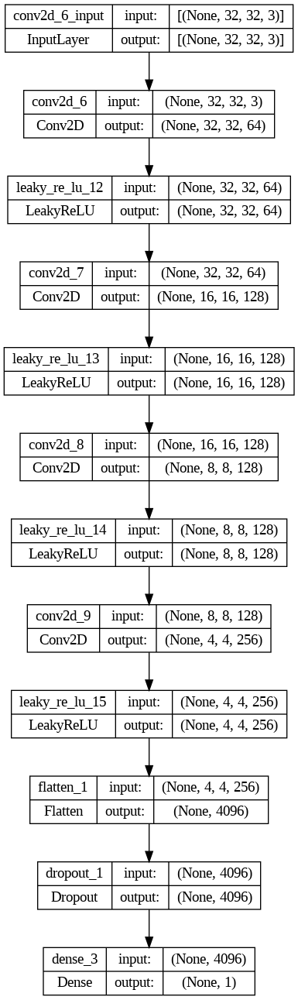

In [ ]:
plot_model(discriminator_model, show_shapes=True)

In [ ]:
def define_cifar10_dcgan(cifar10_dcgan_generator, cifar10_dcgan_discriminator):
  cifar10_dcgan_model = tf.keras.Sequential([
      cifar10_dcgan_generator,
      cifar10_dcgan_discriminator
  ])
  return cifar10_dcgan_model

In [ ]:
# compiling the gan and discriminator parameters

discriminator_model.compile(loss=tf.keras.losses.BinaryCrossentropy(),
                                    optimizer=Adam(learning_rate=1e-4, beta_1=0.5),
                                    metrics=["accuracy"])


cifar10_dcgan_discriminator.trainable = False

cifar10_dcgan_model = define_cifar10_dcgan(generator_model, discriminator_model)
# model optimizer and loss
cifar10_dcgan_model.compile(loss=tf.keras.losses.BinaryCrossentropy(),
                                    optimizer=Adam(learning_rate=1e-4, beta_1=0.5),)
cifar10_dcgan_model.summary

<bound method Model.summary of <keras.src.engine.sequential.Sequential object at 0x785da2f595d0>>

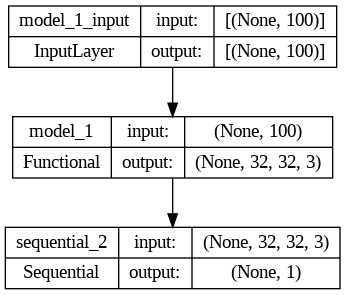

In [ ]:
plot_model(cifar10_dcgan_model, show_shapes=True)

In [ ]:
loss_list = []
accuracy_list = []
iteration_list = []

def train_dcgan():
  no_of_iterations = 20000
  batch_size = 256
  sample_gap = 50

  cifar10_data = cifar10.load_data()
  (X_train, y_train), (X_test, y_test) = cifar10_data

  X_train = X_train.astype('float32')
  X_train =( X_train / 127.5) - 1

  real_img_labels = np.ones((batch_size,1))
  fake_img_labels = np.zeros((batch_size,1))

  for no_of_iteration in range(no_of_iterations):
    random_integer = np.random.randint(0, X_train.shape[0], batch_size)
    real_image = X_train[random_integer]

    discriminator_realimg_loss_accuracy = discriminator_model.train_on_batch(real_image, real_img_labels)

    z_random_noise_vector = np.random.normal(0, 1, (batch_size,100))
    fake_generated_image = generator_model.predict(z_random_noise_vector)

    discriminator_fakeimg_loss_accuracy = discriminator_model.train_on_batch(fake_generated_image, fake_img_labels)

    discriminator_loss, discriminator_accuracy = 0.5 * np.add(discriminator_realimg_loss_accuracy, discriminator_fakeimg_loss_accuracy)

    generator_loss = cifar10_dcgan_model.train_on_batch(z_random_noise_vector, real_img_labels)

    print("Iteration: %d" %(no_of_iteration+1))

    if (no_of_iteration+1) % sample_gap == 0:
      loss_list.append((discriminator_loss, generator_loss))
      accuracy_list.append(discriminator_accuracy*100)
      iteration_list.append(no_of_iteration + 1)

      print(f"Iteration: {no_of_iteration+1}, Discriminator Accuracy: {discriminator_accuracy*100}, Generator Loss: {generator_loss}")

      plot_progress(accuracy_list, loss_list)

      sample_images(generator_model)

      # model_json = generator_model.to_json()
      # with open("content/cifar10_dcgan_model.json","w") as json_file:
      #   json_file.write(model_json)

In [ ]:
def plot_progress(accuracy_list, loss_list):
  plt.plot(accuracy_list)
  plt.plot(loss_list[0])
  plt.title("accuracy and loss vs no. of iterations")
  plt.ylabel("accuarcy and loss")
  plt.xlabel("no. of epochs")
  plt.legend(["accuracy","loss"], loc="upper left")
  plt.show()

In [ ]:
def sample_images(generator_model):
  z_random_noise_vector = np.random.normal(0 ,1, (256, 100))
  generated_images = generator_model.predict(z_random_noise_vector)
  generated_images = 0.5*generated_images + 0.5

  figure, axes = plt.subplots(4,4, figsize=(4,4), sharey=True, sharex=True)
  counter=0
  for i in range(4):
    for j in range(4):
      axes[i, j].imshow(generated_images[counter,:,:])
      axes[i, j].axis('off')
      counter += 1
  plt.show()

8/8 [==============================] - 0s 6ms/step
Iteration: 1
8/8 [==============================] - 0s 6ms/step
Iteration: 2
8/8 [==============================] - 0s 4ms/step
Iteration: 3
8/8 [==============================] - 0s 3ms/step
Iteration: 4
8/8 [==============================] - 0s 3ms/step
Iteration: 5
8/8 [==============================] - 0s 3ms/step
Iteration: 6
8/8 [==============================] - 0s 3ms/step
Iteration: 7
8/8 [==============================] - 0s 3ms/step
Iteration: 8
8/8 [==============================] - 0s 3ms/step
Iteration: 9
8/8 [==============================] - 0s 3ms/step
Iteration: 10
8/8 [==============================] - 0s 3ms/step
Iteration: 11
8/8 [==============================] - 0s 3ms/step
Iteration: 12
8/8 [==============================] - 0s 3ms/step
Iteration: 13
8/8 [==============================] - 0s 3ms/step
Iteration: 14
8/8 [==============================] - 0s 3ms/step
Iteration: 15
8/8 [=============================

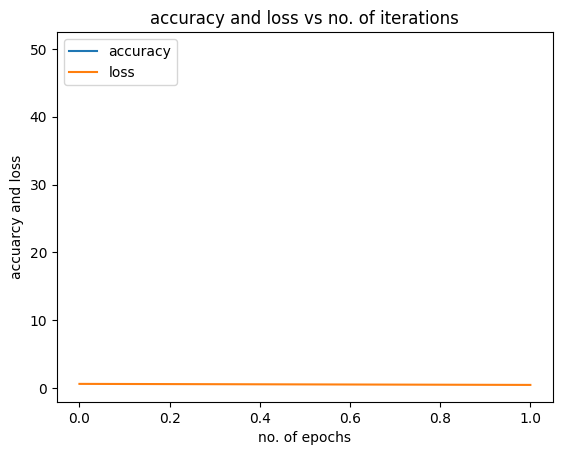

8/8 [==============================] - 0s 3ms/step


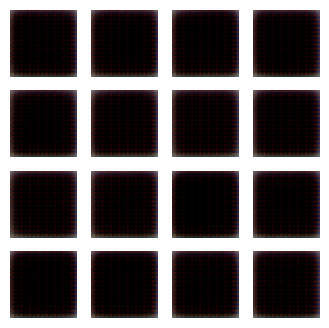

8/8 [==============================] - 0s 3ms/step
Iteration: 51
8/8 [==============================] - 0s 3ms/step
Iteration: 52
8/8 [==============================] - 0s 3ms/step
Iteration: 53
8/8 [==============================] - 0s 3ms/step
Iteration: 54
8/8 [==============================] - 0s 3ms/step
Iteration: 55
8/8 [==============================] - 0s 3ms/step
Iteration: 56
8/8 [==============================] - 0s 4ms/step
Iteration: 57
8/8 [==============================] - 0s 3ms/step
Iteration: 58
8/8 [==============================] - 0s 3ms/step
Iteration: 59
8/8 [==============================] - 0s 3ms/step
Iteration: 60
8/8 [==============================] - 0s 4ms/step
Iteration: 61
8/8 [==============================] - 0s 3ms/step
Iteration: 62
8/8 [==============================] - 0s 3ms/step
Iteration: 63
8/8 [==============================] - 0s 3ms/step
Iteration: 64
8/8 [==============================] - 0s 3ms/step
Iteration: 65
8/8 [====================

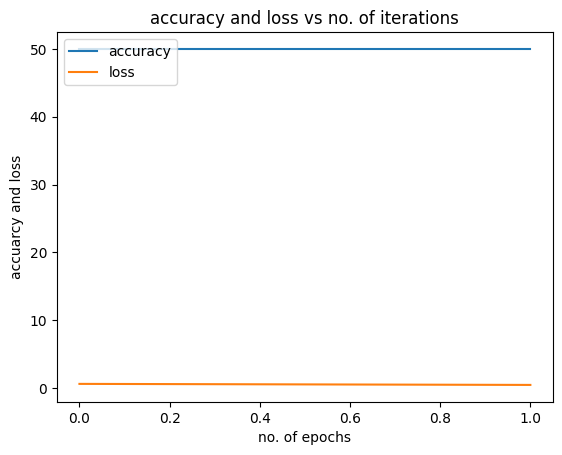

8/8 [==============================] - 0s 3ms/step


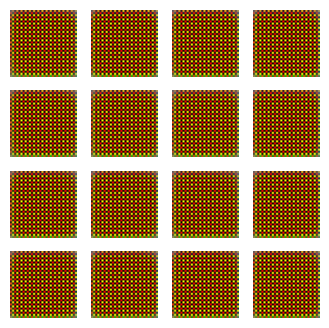

8/8 [==============================] - 0s 4ms/step
Iteration: 101
8/8 [==============================] - 0s 3ms/step
Iteration: 102
8/8 [==============================] - 0s 4ms/step
Iteration: 103
8/8 [==============================] - 0s 3ms/step
Iteration: 104
8/8 [==============================] - 0s 3ms/step
Iteration: 105
8/8 [==============================] - 0s 4ms/step
Iteration: 106
8/8 [==============================] - 0s 5ms/step
Iteration: 107
8/8 [==============================] - 0s 4ms/step
Iteration: 108
8/8 [==============================] - 0s 4ms/step
Iteration: 109
8/8 [==============================] - 0s 4ms/step
Iteration: 110
8/8 [==============================] - 0s 4ms/step
Iteration: 111
8/8 [==============================] - 0s 4ms/step
Iteration: 112
8/8 [==============================] - 0s 3ms/step
Iteration: 113
8/8 [==============================] - 0s 4ms/step
Iteration: 114
8/8 [==============================] - 0s 3ms/step
Iteration: 115
8/8 [=====

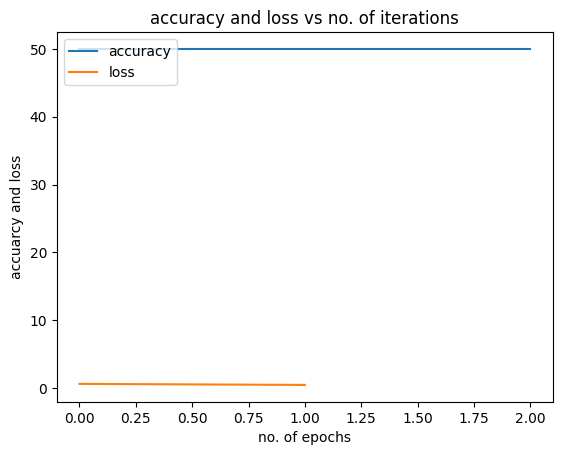

8/8 [==============================] - 0s 4ms/step


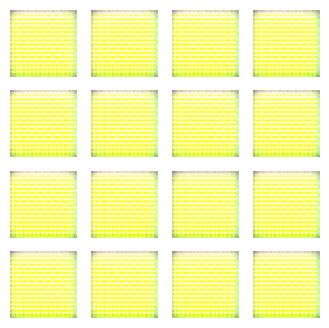

8/8 [==============================] - 0s 4ms/step
Iteration: 151
8/8 [==============================] - 0s 3ms/step
Iteration: 152
8/8 [==============================] - 0s 4ms/step
Iteration: 153
8/8 [==============================] - 0s 4ms/step
Iteration: 154
8/8 [==============================] - 0s 4ms/step
Iteration: 155
8/8 [==============================] - 0s 4ms/step
Iteration: 156
8/8 [==============================] - 0s 3ms/step
Iteration: 157
8/8 [==============================] - 0s 3ms/step
Iteration: 158
8/8 [==============================] - 0s 4ms/step
Iteration: 159
8/8 [==============================] - 0s 4ms/step
Iteration: 160
8/8 [==============================] - 0s 4ms/step
Iteration: 161
8/8 [==============================] - 0s 4ms/step
Iteration: 162
8/8 [==============================] - 0s 5ms/step
Iteration: 163
8/8 [==============================] - 0s 4ms/step
Iteration: 164
8/8 [==============================] - 0s 3ms/step
Iteration: 165
8/8 [=====

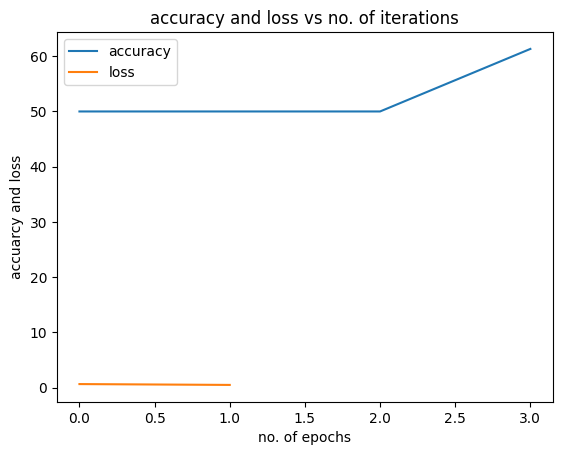

8/8 [==============================] - 0s 4ms/step


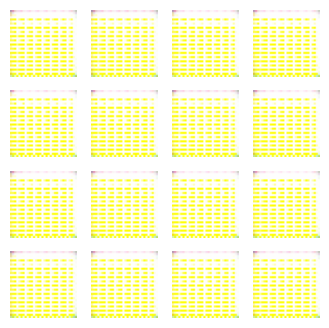

8/8 [==============================] - 0s 4ms/step
Iteration: 201
8/8 [==============================] - 0s 4ms/step
Iteration: 202
8/8 [==============================] - 0s 4ms/step
Iteration: 203
8/8 [==============================] - 0s 3ms/step
Iteration: 204
8/8 [==============================] - 0s 4ms/step
Iteration: 205
8/8 [==============================] - 0s 4ms/step
Iteration: 206
8/8 [==============================] - 0s 3ms/step
Iteration: 207
8/8 [==============================] - 0s 4ms/step
Iteration: 208
8/8 [==============================] - 0s 3ms/step
Iteration: 209
8/8 [==============================] - 0s 4ms/step
Iteration: 210
8/8 [==============================] - 0s 4ms/step
Iteration: 211
8/8 [==============================] - 0s 4ms/step
Iteration: 212
8/8 [==============================] - 0s 3ms/step
Iteration: 213
8/8 [==============================] - 0s 4ms/step
Iteration: 214
8/8 [==============================] - 0s 4ms/step
Iteration: 215
8/8 [=====

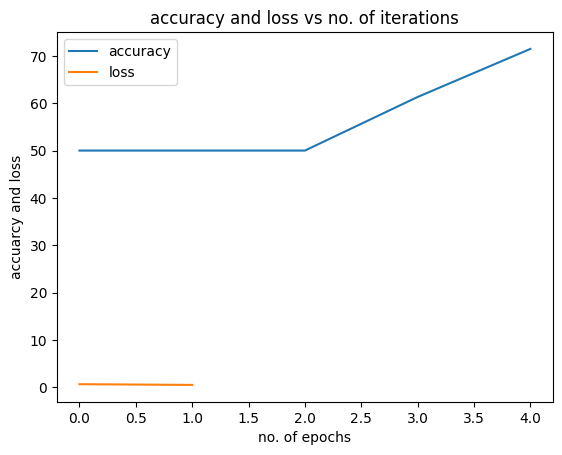

8/8 [==============================] - 0s 4ms/step


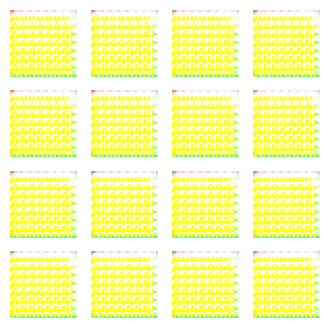

8/8 [==============================] - 0s 7ms/step
Iteration: 251
8/8 [==============================] - 0s 6ms/step
Iteration: 252
8/8 [==============================] - 0s 4ms/step
Iteration: 253
8/8 [==============================] - 0s 5ms/step
Iteration: 254
8/8 [==============================] - 0s 4ms/step
Iteration: 255
8/8 [==============================] - 0s 4ms/step
Iteration: 256
8/8 [==============================] - 0s 3ms/step
Iteration: 257
8/8 [==============================] - 0s 4ms/step
Iteration: 258
8/8 [==============================] - 0s 4ms/step
Iteration: 259
8/8 [==============================] - 0s 4ms/step
Iteration: 260
8/8 [==============================] - 0s 4ms/step
Iteration: 261
8/8 [==============================] - 0s 3ms/step
Iteration: 262
8/8 [==============================] - 0s 3ms/step
Iteration: 263
8/8 [==============================] - 0s 3ms/step
Iteration: 264
8/8 [==============================] - 0s 3ms/step
Iteration: 265
8/8 [=====

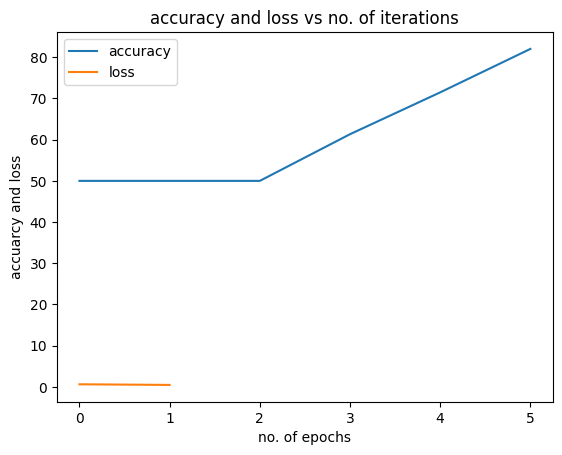

8/8 [==============================] - 0s 4ms/step


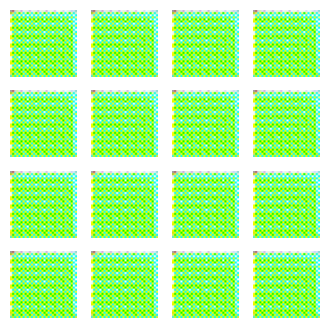

8/8 [==============================] - 0s 3ms/step
Iteration: 301
8/8 [==============================] - 0s 4ms/step
Iteration: 302
8/8 [==============================] - 0s 3ms/step
Iteration: 303
8/8 [==============================] - 0s 3ms/step
Iteration: 304
8/8 [==============================] - 0s 4ms/step
Iteration: 305
8/8 [==============================] - 0s 4ms/step
Iteration: 306
8/8 [==============================] - 0s 3ms/step
Iteration: 307
8/8 [==============================] - 0s 3ms/step
Iteration: 308
8/8 [==============================] - 0s 5ms/step
Iteration: 309
8/8 [==============================] - 0s 4ms/step
Iteration: 310
8/8 [==============================] - 0s 3ms/step
Iteration: 311
8/8 [==============================] - 0s 5ms/step
Iteration: 312
8/8 [==============================] - 0s 3ms/step
Iteration: 313
8/8 [==============================] - 0s 4ms/step
Iteration: 314
8/8 [==============================] - 0s 4ms/step
Iteration: 315
8/8 [=====

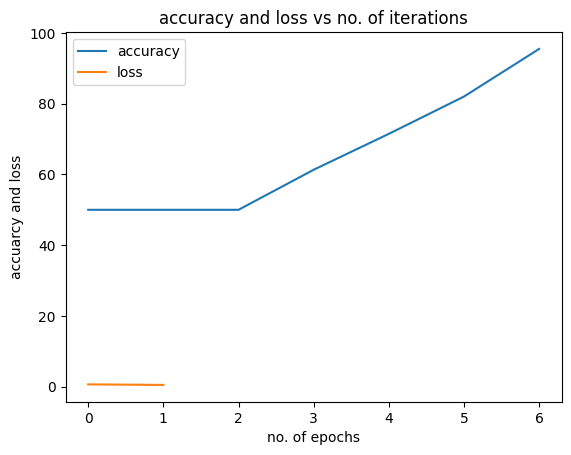

8/8 [==============================] - 0s 4ms/step


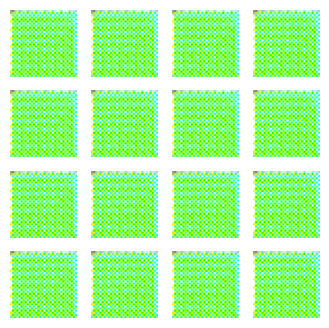

8/8 [==============================] - 0s 3ms/step
Iteration: 351
8/8 [==============================] - 0s 5ms/step
Iteration: 352
8/8 [==============================] - 0s 4ms/step
Iteration: 353
8/8 [==============================] - 0s 4ms/step
Iteration: 354
8/8 [==============================] - 0s 3ms/step
Iteration: 355
8/8 [==============================] - 0s 4ms/step
Iteration: 356
8/8 [==============================] - 0s 4ms/step
Iteration: 357
8/8 [==============================] - 0s 4ms/step
Iteration: 358
8/8 [==============================] - 0s 3ms/step
Iteration: 359
8/8 [==============================] - 0s 3ms/step
Iteration: 360
8/8 [==============================] - 0s 4ms/step
Iteration: 361
8/8 [==============================] - 0s 4ms/step
Iteration: 362
8/8 [==============================] - 0s 4ms/step
Iteration: 363
8/8 [==============================] - 0s 5ms/step
Iteration: 364
8/8 [==============================] - 0s 5ms/step
Iteration: 365
8/8 [=====

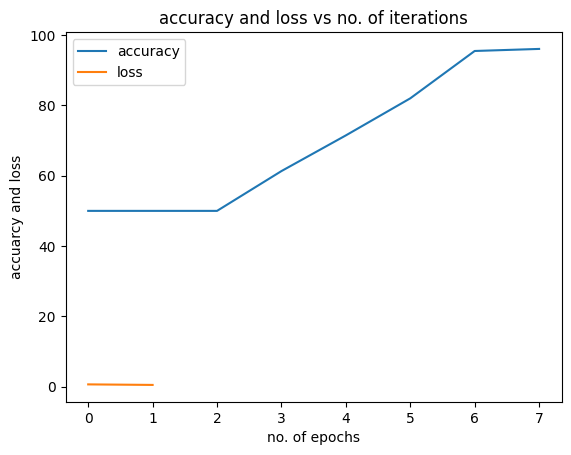

8/8 [==============================] - 0s 4ms/step


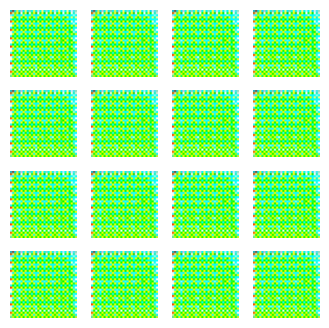

8/8 [==============================] - 0s 8ms/step
Iteration: 401
8/8 [==============================] - 0s 5ms/step
Iteration: 402
8/8 [==============================] - 0s 5ms/step
Iteration: 403
8/8 [==============================] - 0s 3ms/step
Iteration: 404
8/8 [==============================] - 0s 3ms/step
Iteration: 405
8/8 [==============================] - 0s 3ms/step
Iteration: 406
8/8 [==============================] - 0s 4ms/step
Iteration: 407
8/8 [==============================] - 0s 3ms/step
Iteration: 408
8/8 [==============================] - 0s 3ms/step
Iteration: 409
8/8 [==============================] - 0s 5ms/step
Iteration: 410
8/8 [==============================] - 0s 4ms/step
Iteration: 411
8/8 [==============================] - 0s 3ms/step
Iteration: 412
8/8 [==============================] - 0s 4ms/step
Iteration: 413
8/8 [==============================] - 0s 3ms/step
Iteration: 414
8/8 [==============================] - 0s 4ms/step
Iteration: 415
8/8 [=====

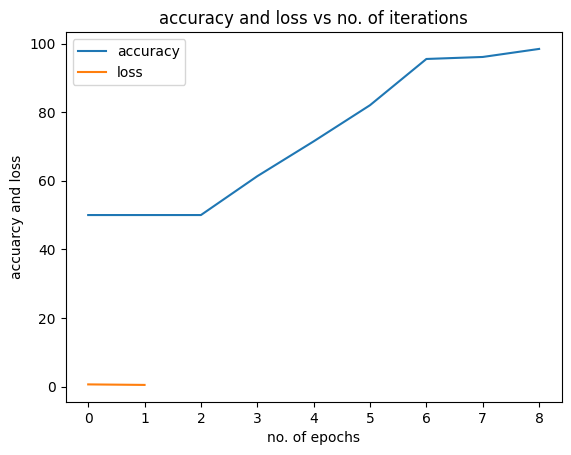

8/8 [==============================] - 0s 4ms/step


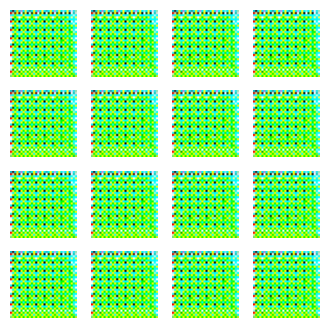

8/8 [==============================] - 0s 4ms/step
Iteration: 451
8/8 [==============================] - 0s 3ms/step
Iteration: 452
8/8 [==============================] - 0s 4ms/step
Iteration: 453
8/8 [==============================] - 0s 3ms/step
Iteration: 454
8/8 [==============================] - 0s 3ms/step
Iteration: 455
8/8 [==============================] - 0s 4ms/step
Iteration: 456
8/8 [==============================] - 0s 5ms/step
Iteration: 457
8/8 [==============================] - 0s 3ms/step
Iteration: 458
8/8 [==============================] - 0s 3ms/step
Iteration: 459
8/8 [==============================] - 0s 4ms/step
Iteration: 460
8/8 [==============================] - 0s 3ms/step
Iteration: 461
8/8 [==============================] - 0s 3ms/step
Iteration: 462
8/8 [==============================] - 0s 4ms/step
Iteration: 463
8/8 [==============================] - 0s 3ms/step
Iteration: 464
8/8 [==============================] - 0s 4ms/step
Iteration: 465
8/8 [=====

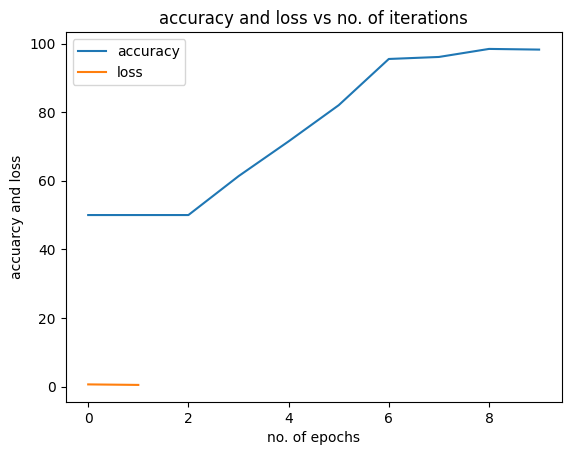

8/8 [==============================] - 0s 3ms/step


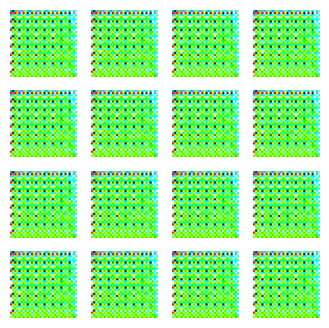

8/8 [==============================] - 0s 3ms/step
Iteration: 501
8/8 [==============================] - 0s 4ms/step
Iteration: 502
8/8 [==============================] - 0s 3ms/step
Iteration: 503
8/8 [==============================] - 0s 4ms/step
Iteration: 504
8/8 [==============================] - 0s 4ms/step
Iteration: 505
8/8 [==============================] - 0s 4ms/step
Iteration: 506
8/8 [==============================] - 0s 4ms/step
Iteration: 507
8/8 [==============================] - 0s 5ms/step
Iteration: 508
8/8 [==============================] - 0s 5ms/step
Iteration: 509
8/8 [==============================] - 0s 5ms/step
Iteration: 510
8/8 [==============================] - 0s 5ms/step
Iteration: 511
8/8 [==============================] - 0s 4ms/step
Iteration: 512
8/8 [==============================] - 0s 6ms/step
Iteration: 513
8/8 [==============================] - 0s 3ms/step
Iteration: 514
8/8 [==============================] - 0s 4ms/step
Iteration: 515
8/8 [=====

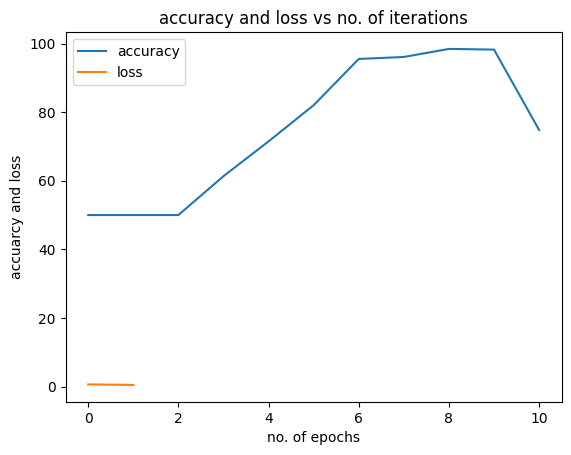

8/8 [==============================] - 0s 5ms/step


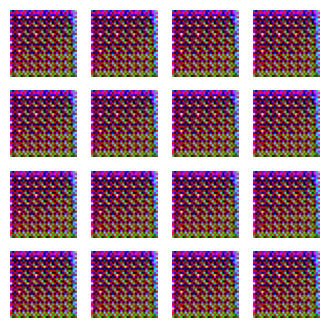

8/8 [==============================] - 0s 7ms/step
Iteration: 551
8/8 [==============================] - 0s 3ms/step
Iteration: 552
8/8 [==============================] - 0s 3ms/step
Iteration: 553
8/8 [==============================] - 0s 3ms/step
Iteration: 554
8/8 [==============================] - 0s 3ms/step
Iteration: 555
8/8 [==============================] - 0s 3ms/step
Iteration: 556
8/8 [==============================] - 0s 4ms/step
Iteration: 557
8/8 [==============================] - 0s 4ms/step
Iteration: 558
8/8 [==============================] - 0s 4ms/step
Iteration: 559
8/8 [==============================] - 0s 3ms/step
Iteration: 560
8/8 [==============================] - 0s 5ms/step
Iteration: 561
8/8 [==============================] - 0s 4ms/step
Iteration: 562
8/8 [==============================] - 0s 3ms/step
Iteration: 563
8/8 [==============================] - 0s 4ms/step
Iteration: 564
8/8 [==============================] - 0s 4ms/step
Iteration: 565
8/8 [=====

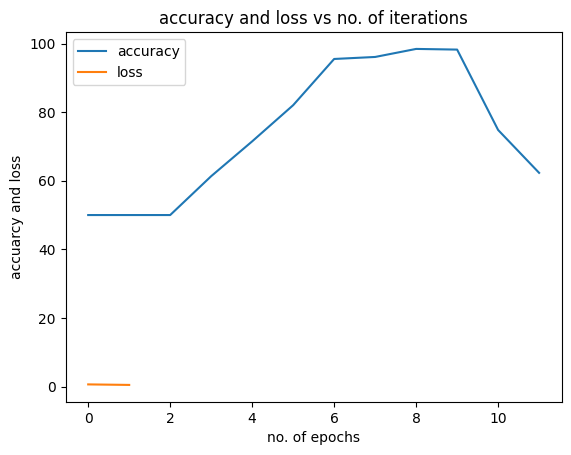

8/8 [==============================] - 0s 4ms/step


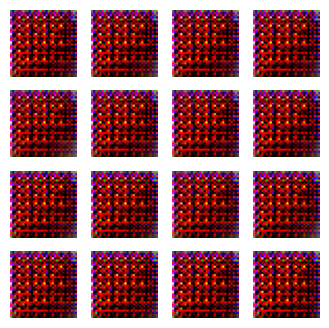

8/8 [==============================] - 0s 6ms/step
Iteration: 601
8/8 [==============================] - 0s 4ms/step
Iteration: 602
8/8 [==============================] - 0s 4ms/step
Iteration: 603
8/8 [==============================] - 0s 4ms/step
Iteration: 604
8/8 [==============================] - 0s 4ms/step
Iteration: 605
8/8 [==============================] - 0s 3ms/step
Iteration: 606
8/8 [==============================] - 0s 3ms/step
Iteration: 607
8/8 [==============================] - 0s 4ms/step
Iteration: 608
8/8 [==============================] - 0s 4ms/step
Iteration: 609
8/8 [==============================] - 0s 4ms/step
Iteration: 610
8/8 [==============================] - 0s 3ms/step
Iteration: 611
8/8 [==============================] - 0s 4ms/step
Iteration: 612
8/8 [==============================] - 0s 3ms/step
Iteration: 613
8/8 [==============================] - 0s 3ms/step
Iteration: 614
8/8 [==============================] - 0s 5ms/step
Iteration: 615
8/8 [=====

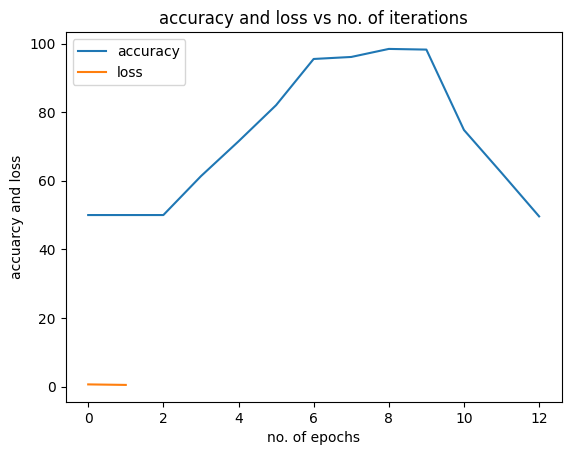

8/8 [==============================] - 0s 3ms/step


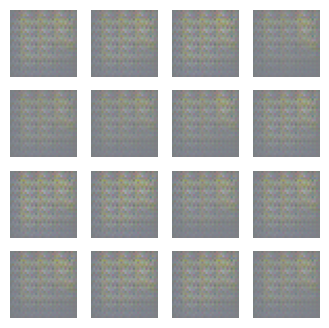

8/8 [==============================] - 0s 6ms/step
Iteration: 651
8/8 [==============================] - 0s 4ms/step
Iteration: 652
8/8 [==============================] - 0s 4ms/step
Iteration: 653
8/8 [==============================] - 0s 4ms/step
Iteration: 654
8/8 [==============================] - 0s 5ms/step
Iteration: 655
8/8 [==============================] - 0s 4ms/step
Iteration: 656
8/8 [==============================] - 0s 4ms/step
Iteration: 657
8/8 [==============================] - 0s 3ms/step
Iteration: 658
8/8 [==============================] - 0s 5ms/step
Iteration: 659
8/8 [==============================] - 0s 4ms/step
Iteration: 660
8/8 [==============================] - 0s 5ms/step
Iteration: 661
8/8 [==============================] - 0s 5ms/step
Iteration: 662
8/8 [==============================] - 0s 4ms/step
Iteration: 663
8/8 [==============================] - 0s 3ms/step
Iteration: 664
8/8 [==============================] - 0s 3ms/step
Iteration: 665
8/8 [=====

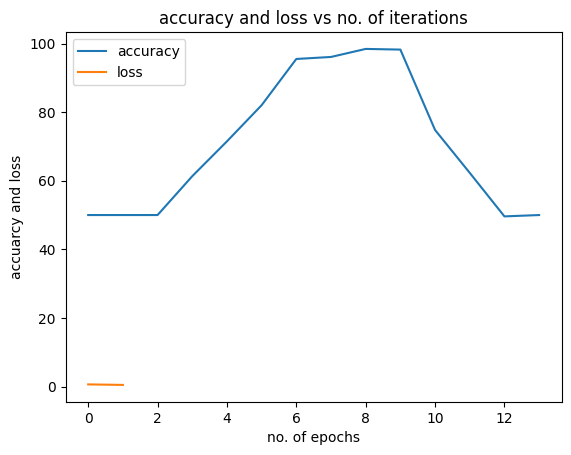

8/8 [==============================] - 0s 3ms/step


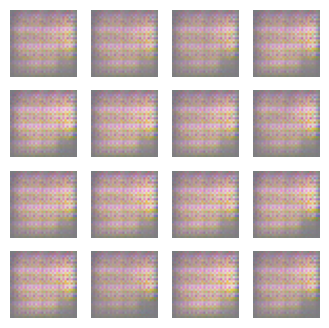

8/8 [==============================] - 0s 6ms/step
Iteration: 701
8/8 [==============================] - 0s 3ms/step
Iteration: 702
8/8 [==============================] - 0s 4ms/step
Iteration: 703
8/8 [==============================] - 0s 3ms/step
Iteration: 704
8/8 [==============================] - 0s 3ms/step
Iteration: 705
8/8 [==============================] - 0s 3ms/step
Iteration: 706
8/8 [==============================] - 0s 3ms/step
Iteration: 707
8/8 [==============================] - 0s 4ms/step
Iteration: 708
8/8 [==============================] - 0s 5ms/step
Iteration: 709
8/8 [==============================] - 0s 3ms/step
Iteration: 710
8/8 [==============================] - 0s 4ms/step
Iteration: 711
8/8 [==============================] - 0s 3ms/step
Iteration: 712
8/8 [==============================] - 0s 3ms/step
Iteration: 713
8/8 [==============================] - 0s 4ms/step
Iteration: 714
8/8 [==============================] - 0s 4ms/step
Iteration: 715
8/8 [=====

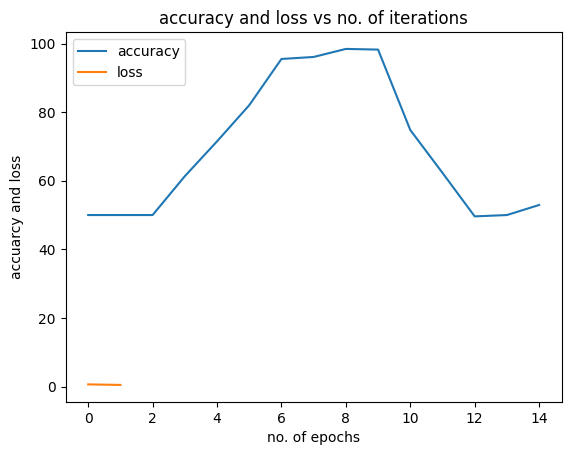

8/8 [==============================] - 0s 3ms/step


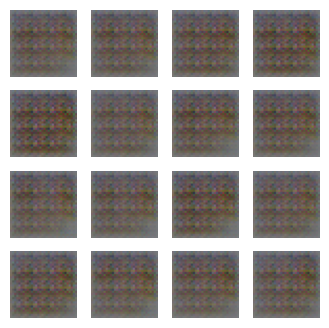

8/8 [==============================] - 0s 4ms/step
Iteration: 751
8/8 [==============================] - 0s 5ms/step
Iteration: 752
8/8 [==============================] - 0s 3ms/step
Iteration: 753
8/8 [==============================] - 0s 3ms/step
Iteration: 754
8/8 [==============================] - 0s 6ms/step
Iteration: 755
8/8 [==============================] - 0s 5ms/step
Iteration: 756
8/8 [==============================] - 0s 4ms/step
Iteration: 757
8/8 [==============================] - 0s 4ms/step
Iteration: 758
8/8 [==============================] - 0s 5ms/step
Iteration: 759
8/8 [==============================] - 0s 5ms/step
Iteration: 760
8/8 [==============================] - 0s 5ms/step
Iteration: 761
8/8 [==============================] - 0s 3ms/step
Iteration: 762
8/8 [==============================] - 0s 6ms/step
Iteration: 763
8/8 [==============================] - 0s 5ms/step
Iteration: 764
8/8 [==============================] - 0s 4ms/step
Iteration: 765
8/8 [=====

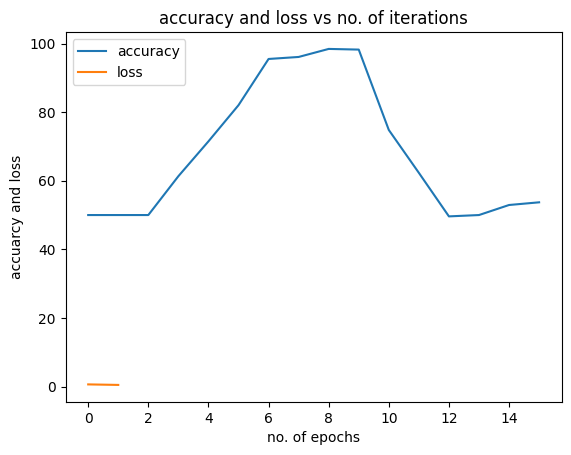

8/8 [==============================] - 0s 4ms/step


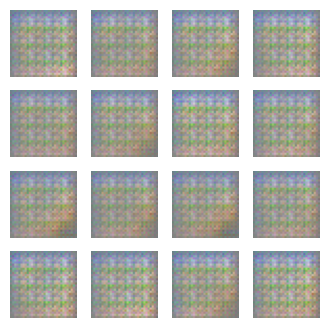

8/8 [==============================] - 0s 7ms/step
Iteration: 801
8/8 [==============================] - 0s 4ms/step
Iteration: 802
8/8 [==============================] - 0s 3ms/step
Iteration: 803
8/8 [==============================] - 0s 3ms/step
Iteration: 804
8/8 [==============================] - 0s 3ms/step
Iteration: 805
8/8 [==============================] - 0s 5ms/step
Iteration: 806
8/8 [==============================] - 0s 3ms/step
Iteration: 807
8/8 [==============================] - 0s 4ms/step
Iteration: 808
8/8 [==============================] - 0s 4ms/step
Iteration: 809
8/8 [==============================] - 0s 3ms/step
Iteration: 810
8/8 [==============================] - 0s 5ms/step
Iteration: 811
8/8 [==============================] - 0s 3ms/step
Iteration: 812
8/8 [==============================] - 0s 5ms/step
Iteration: 813
8/8 [==============================] - 0s 3ms/step
Iteration: 814
8/8 [==============================] - 0s 4ms/step
Iteration: 815
8/8 [=====

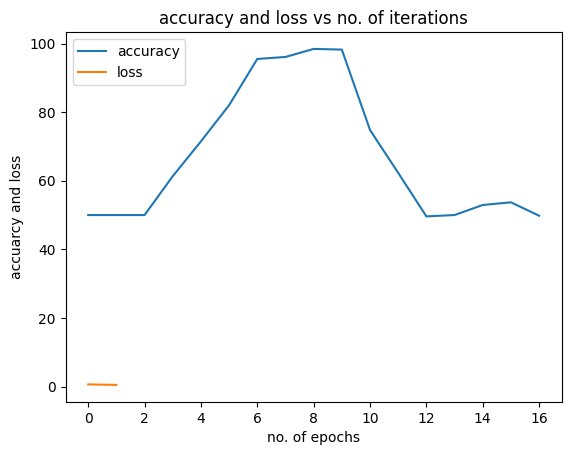

8/8 [==============================] - 0s 4ms/step


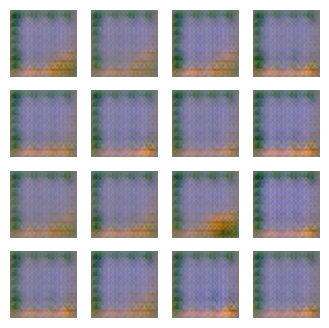

8/8 [==============================] - 0s 5ms/step
Iteration: 851
8/8 [==============================] - 0s 4ms/step
Iteration: 852
8/8 [==============================] - 0s 4ms/step
Iteration: 853
8/8 [==============================] - 0s 3ms/step
Iteration: 854
8/8 [==============================] - 0s 4ms/step
Iteration: 855
8/8 [==============================] - 0s 5ms/step
Iteration: 856
8/8 [==============================] - 0s 3ms/step
Iteration: 857
8/8 [==============================] - 0s 4ms/step
Iteration: 858
8/8 [==============================] - 0s 3ms/step
Iteration: 859
8/8 [==============================] - 0s 4ms/step
Iteration: 860
8/8 [==============================] - 0s 4ms/step
Iteration: 861
8/8 [==============================] - 0s 6ms/step
Iteration: 862
8/8 [==============================] - 0s 4ms/step
Iteration: 863
8/8 [==============================] - 0s 4ms/step
Iteration: 864
8/8 [==============================] - 0s 4ms/step
Iteration: 865
8/8 [=====

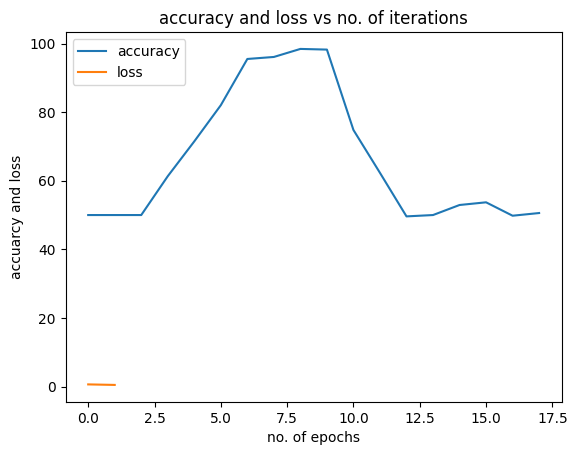

8/8 [==============================] - 0s 3ms/step


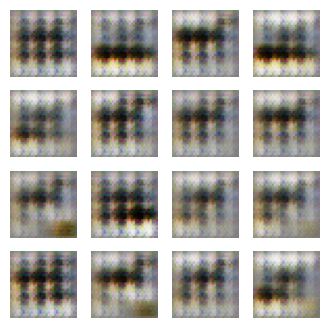

8/8 [==============================] - 0s 3ms/step
Iteration: 901
8/8 [==============================] - 0s 3ms/step
Iteration: 902
8/8 [==============================] - 0s 4ms/step
Iteration: 903
8/8 [==============================] - 0s 4ms/step
Iteration: 904
8/8 [==============================] - 0s 5ms/step
Iteration: 905
8/8 [==============================] - 0s 5ms/step
Iteration: 906
8/8 [==============================] - 0s 6ms/step
Iteration: 907
8/8 [==============================] - 0s 5ms/step
Iteration: 908
8/8 [==============================] - 0s 5ms/step
Iteration: 909
8/8 [==============================] - 0s 3ms/step
Iteration: 910
8/8 [==============================] - 0s 3ms/step
Iteration: 911
8/8 [==============================] - 0s 3ms/step
Iteration: 912
8/8 [==============================] - 0s 5ms/step
Iteration: 913
8/8 [==============================] - 0s 3ms/step
Iteration: 914
8/8 [==============================] - 0s 5ms/step
Iteration: 915
8/8 [=====

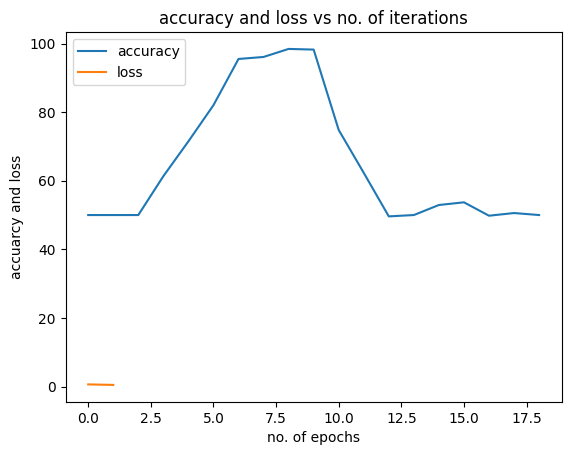

8/8 [==============================] - 0s 3ms/step


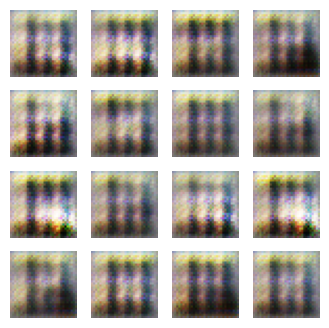

8/8 [==============================] - 0s 3ms/step
Iteration: 951
8/8 [==============================] - 0s 3ms/step
Iteration: 952
8/8 [==============================] - 0s 4ms/step
Iteration: 953
8/8 [==============================] - 0s 3ms/step
Iteration: 954
8/8 [==============================] - 0s 4ms/step
Iteration: 955
8/8 [==============================] - 0s 4ms/step
Iteration: 956
8/8 [==============================] - 0s 4ms/step
Iteration: 957
8/8 [==============================] - 0s 5ms/step
Iteration: 958
8/8 [==============================] - 0s 3ms/step
Iteration: 959
8/8 [==============================] - 0s 3ms/step
Iteration: 960
8/8 [==============================] - 0s 4ms/step
Iteration: 961
8/8 [==============================] - 0s 3ms/step
Iteration: 962
8/8 [==============================] - 0s 3ms/step
Iteration: 963
8/8 [==============================] - 0s 5ms/step
Iteration: 964
8/8 [==============================] - 0s 3ms/step
Iteration: 965
8/8 [=====

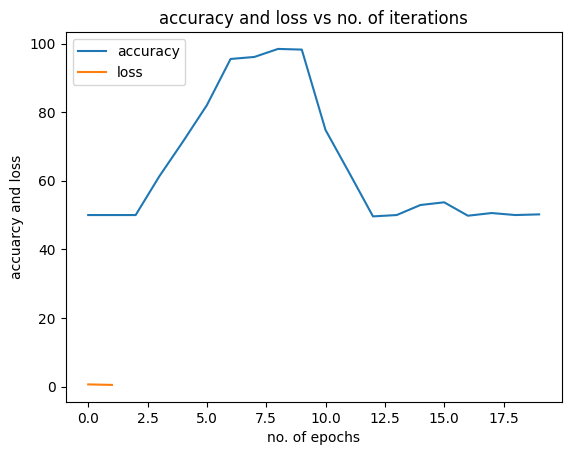

8/8 [==============================] - 0s 3ms/step


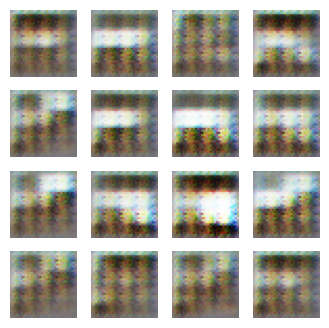

8/8 [==============================] - 0s 3ms/step
Iteration: 1001
8/8 [==============================] - 0s 3ms/step
Iteration: 1002
8/8 [==============================] - 0s 5ms/step
Iteration: 1003
8/8 [==============================] - 0s 6ms/step
Iteration: 1004
8/8 [==============================] - 0s 3ms/step
Iteration: 1005
8/8 [==============================] - 0s 4ms/step
Iteration: 1006
8/8 [==============================] - 0s 3ms/step
Iteration: 1007
8/8 [==============================] - 0s 4ms/step
Iteration: 1008
8/8 [==============================] - 0s 4ms/step
Iteration: 1009
8/8 [==============================] - 0s 4ms/step
Iteration: 1010
8/8 [==============================] - 0s 5ms/step
Iteration: 1011
8/8 [==============================] - 0s 6ms/step
Iteration: 1012
8/8 [==============================] - 0s 5ms/step
Iteration: 1013
8/8 [==============================] - 0s 5ms/step
Iteration: 1014
8/8 [==============================] - 0s 4ms/step
Iteration: 

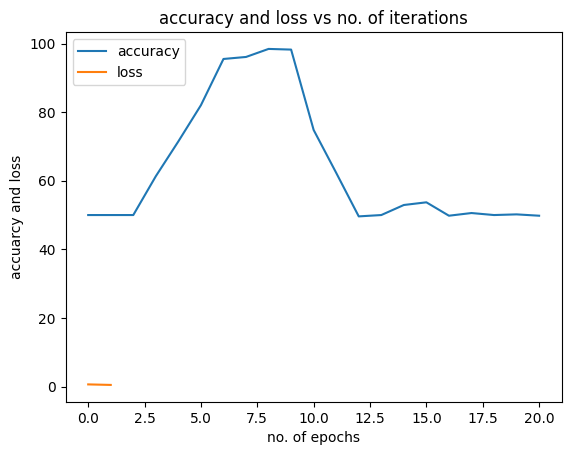

8/8 [==============================] - 0s 4ms/step


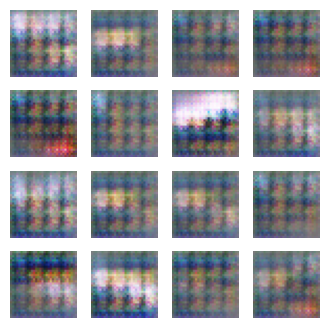

8/8 [==============================] - 0s 6ms/step
Iteration: 1051
8/8 [==============================] - 0s 4ms/step
Iteration: 1052
8/8 [==============================] - 0s 4ms/step
Iteration: 1053
8/8 [==============================] - 0s 5ms/step
Iteration: 1054
8/8 [==============================] - 0s 3ms/step
Iteration: 1055
8/8 [==============================] - 0s 6ms/step
Iteration: 1056
8/8 [==============================] - 0s 3ms/step
Iteration: 1057
8/8 [==============================] - 0s 4ms/step
Iteration: 1058
8/8 [==============================] - 0s 3ms/step
Iteration: 1059
8/8 [==============================] - 0s 3ms/step
Iteration: 1060
8/8 [==============================] - 0s 4ms/step
Iteration: 1061
8/8 [==============================] - 0s 4ms/step
Iteration: 1062
8/8 [==============================] - 0s 3ms/step
Iteration: 1063
8/8 [==============================] - 0s 4ms/step
Iteration: 1064
8/8 [==============================] - 0s 3ms/step
Iteration: 

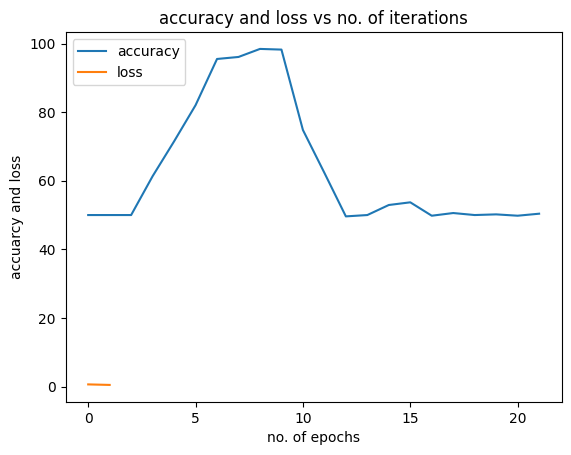

8/8 [==============================] - 0s 4ms/step


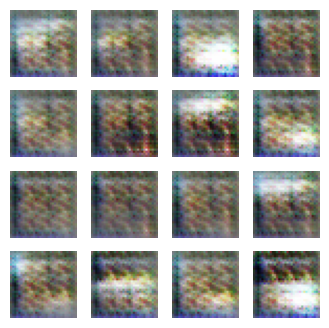

8/8 [==============================] - 0s 5ms/step
Iteration: 1101
8/8 [==============================] - 0s 3ms/step
Iteration: 1102
8/8 [==============================] - 0s 4ms/step
Iteration: 1103
8/8 [==============================] - 0s 4ms/step
Iteration: 1104
8/8 [==============================] - 0s 3ms/step
Iteration: 1105
8/8 [==============================] - 0s 5ms/step
Iteration: 1106
8/8 [==============================] - 0s 4ms/step
Iteration: 1107
8/8 [==============================] - 0s 4ms/step
Iteration: 1108
8/8 [==============================] - 0s 3ms/step
Iteration: 1109
8/8 [==============================] - 0s 3ms/step
Iteration: 1110
8/8 [==============================] - 0s 4ms/step
Iteration: 1111
8/8 [==============================] - 0s 5ms/step
Iteration: 1112
8/8 [==============================] - 0s 5ms/step
Iteration: 1113
8/8 [==============================] - 0s 3ms/step
Iteration: 1114
8/8 [==============================] - 0s 3ms/step
Iteration: 

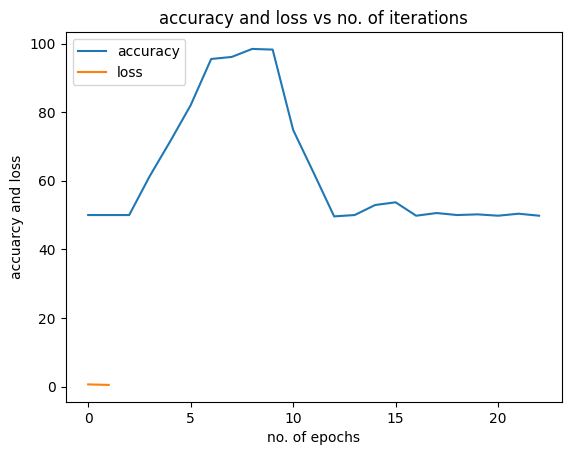

8/8 [==============================] - 0s 4ms/step


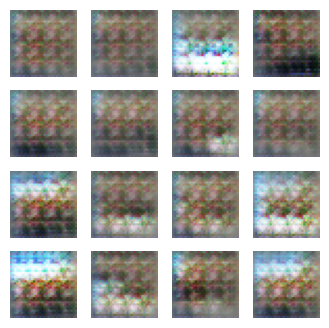

8/8 [==============================] - 0s 6ms/step
Iteration: 1151
8/8 [==============================] - 0s 5ms/step
Iteration: 1152
8/8 [==============================] - 0s 4ms/step
Iteration: 1153
8/8 [==============================] - 0s 4ms/step
Iteration: 1154
8/8 [==============================] - 0s 4ms/step
Iteration: 1155
8/8 [==============================] - 0s 4ms/step
Iteration: 1156
8/8 [==============================] - 0s 3ms/step
Iteration: 1157
8/8 [==============================] - 0s 3ms/step
Iteration: 1158
8/8 [==============================] - 0s 3ms/step
Iteration: 1159
8/8 [==============================] - 0s 4ms/step
Iteration: 1160
8/8 [==============================] - 0s 4ms/step
Iteration: 1161
8/8 [==============================] - 0s 3ms/step
Iteration: 1162
8/8 [==============================] - 0s 3ms/step
Iteration: 1163
8/8 [==============================] - 0s 3ms/step
Iteration: 1164
8/8 [==============================] - 0s 5ms/step
Iteration: 

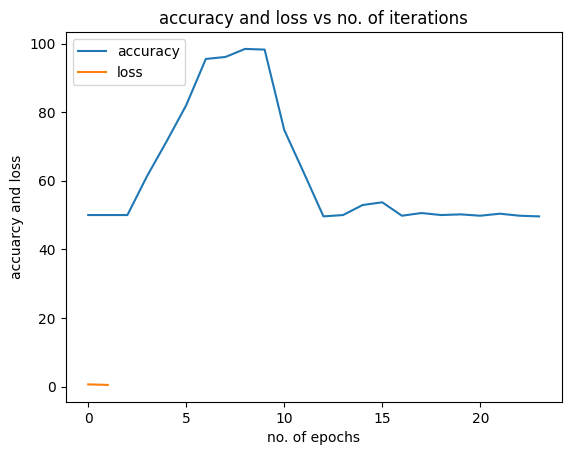

8/8 [==============================] - 0s 3ms/step


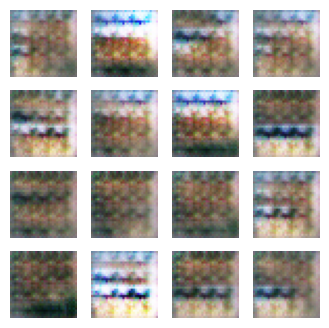

8/8 [==============================] - 0s 6ms/step
Iteration: 1201
8/8 [==============================] - 0s 5ms/step
Iteration: 1202
8/8 [==============================] - 0s 4ms/step
Iteration: 1203
8/8 [==============================] - 0s 5ms/step
Iteration: 1204
8/8 [==============================] - 0s 4ms/step
Iteration: 1205
8/8 [==============================] - 0s 4ms/step
Iteration: 1206
8/8 [==============================] - 0s 4ms/step
Iteration: 1207
8/8 [==============================] - 0s 3ms/step
Iteration: 1208
8/8 [==============================] - 0s 3ms/step
Iteration: 1209
8/8 [==============================] - 0s 4ms/step
Iteration: 1210
8/8 [==============================] - 0s 4ms/step
Iteration: 1211
8/8 [==============================] - 0s 3ms/step
Iteration: 1212
8/8 [==============================] - 0s 4ms/step
Iteration: 1213
8/8 [==============================] - 0s 4ms/step
Iteration: 1214
8/8 [==============================] - 0s 4ms/step
Iteration: 

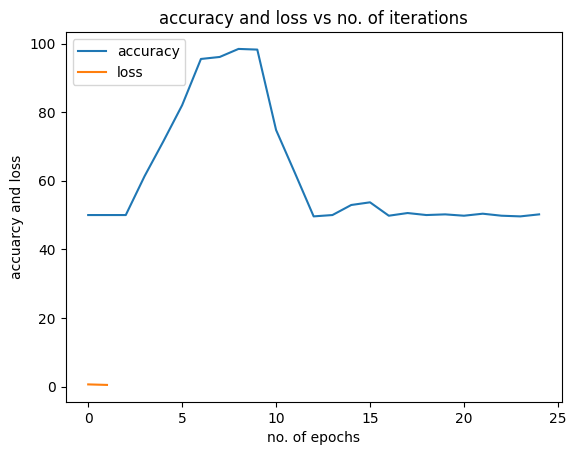

8/8 [==============================] - 0s 3ms/step


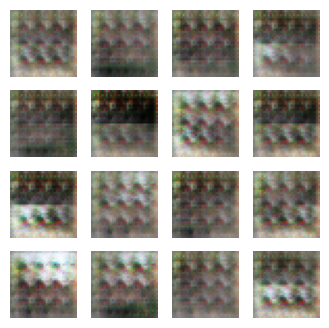

8/8 [==============================] - 0s 3ms/step
Iteration: 1251
8/8 [==============================] - 0s 4ms/step
Iteration: 1252
8/8 [==============================] - 0s 3ms/step
Iteration: 1253
8/8 [==============================] - 0s 3ms/step
Iteration: 1254
8/8 [==============================] - 0s 5ms/step
Iteration: 1255
8/8 [==============================] - 0s 5ms/step
Iteration: 1256
8/8 [==============================] - 0s 4ms/step
Iteration: 1257
8/8 [==============================] - 0s 5ms/step
Iteration: 1258
8/8 [==============================] - 0s 4ms/step
Iteration: 1259
8/8 [==============================] - 0s 5ms/step
Iteration: 1260
8/8 [==============================] - 0s 5ms/step
Iteration: 1261
8/8 [==============================] - 0s 3ms/step
Iteration: 1262
8/8 [==============================] - 0s 4ms/step
Iteration: 1263
8/8 [==============================] - 0s 4ms/step
Iteration: 1264
8/8 [==============================] - 0s 3ms/step
Iteration: 

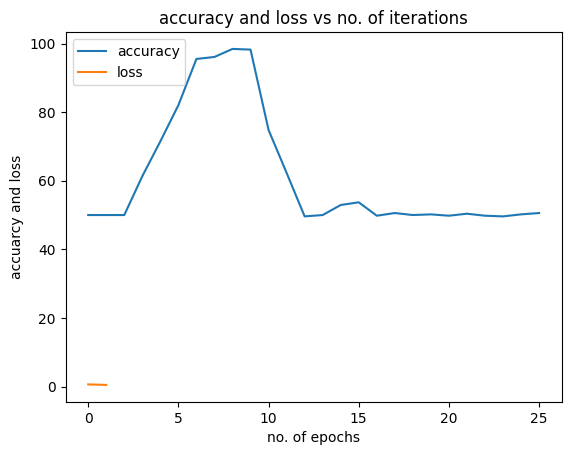

8/8 [==============================] - 0s 4ms/step


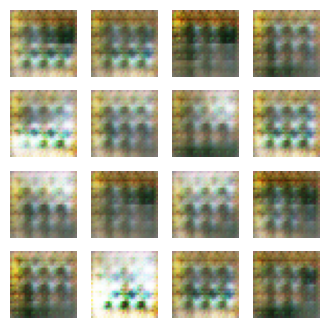

8/8 [==============================] - 0s 4ms/step
Iteration: 1301
8/8 [==============================] - 0s 4ms/step
Iteration: 1302
8/8 [==============================] - 0s 4ms/step
Iteration: 1303
8/8 [==============================] - 0s 3ms/step
Iteration: 1304
8/8 [==============================] - 0s 3ms/step
Iteration: 1305
8/8 [==============================] - 0s 3ms/step
Iteration: 1306
8/8 [==============================] - 0s 3ms/step
Iteration: 1307
8/8 [==============================] - 0s 3ms/step
Iteration: 1308
8/8 [==============================] - 0s 4ms/step
Iteration: 1309
8/8 [==============================] - 0s 4ms/step
Iteration: 1310
8/8 [==============================] - 0s 3ms/step
Iteration: 1311
8/8 [==============================] - 0s 3ms/step
Iteration: 1312
8/8 [==============================] - 0s 3ms/step
Iteration: 1313
8/8 [==============================] - 0s 4ms/step
Iteration: 1314
8/8 [==============================] - 0s 4ms/step
Iteration: 

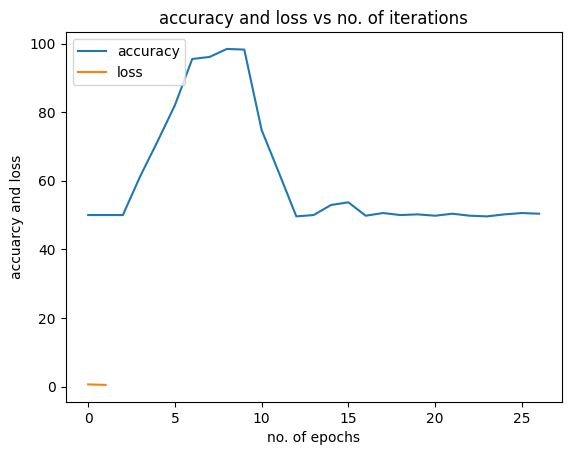

8/8 [==============================] - 0s 4ms/step


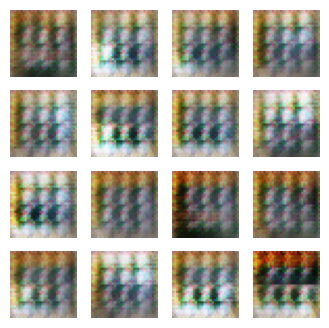

8/8 [==============================] - 0s 5ms/step
Iteration: 1351
8/8 [==============================] - 0s 4ms/step
Iteration: 1352
8/8 [==============================] - 0s 3ms/step
Iteration: 1353
8/8 [==============================] - 0s 3ms/step
Iteration: 1354
8/8 [==============================] - 0s 4ms/step
Iteration: 1355
8/8 [==============================] - 0s 4ms/step
Iteration: 1356
8/8 [==============================] - 0s 4ms/step
Iteration: 1357
8/8 [==============================] - 0s 3ms/step
Iteration: 1358
8/8 [==============================] - 0s 4ms/step
Iteration: 1359
8/8 [==============================] - 0s 3ms/step
Iteration: 1360
8/8 [==============================] - 0s 4ms/step
Iteration: 1361
8/8 [==============================] - 0s 3ms/step
Iteration: 1362
8/8 [==============================] - 0s 4ms/step
Iteration: 1363
8/8 [==============================] - 0s 5ms/step
Iteration: 1364
8/8 [==============================] - 0s 4ms/step
Iteration: 

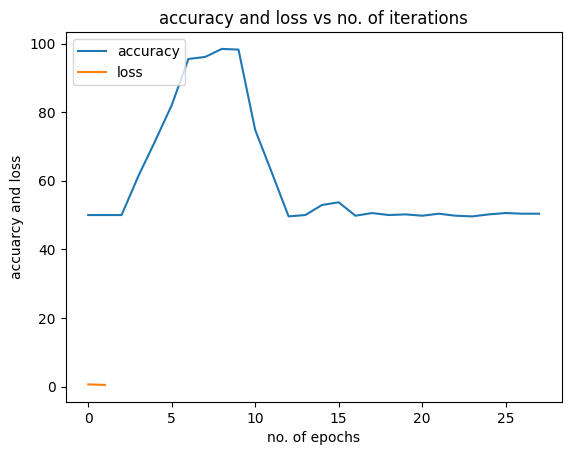

8/8 [==============================] - 0s 4ms/step


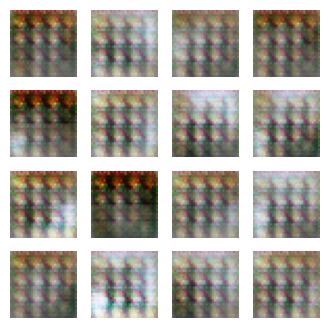

8/8 [==============================] - 0s 6ms/step
Iteration: 1401
8/8 [==============================] - 0s 5ms/step
Iteration: 1402
8/8 [==============================] - 0s 4ms/step
Iteration: 1403
8/8 [==============================] - 0s 7ms/step
Iteration: 1404
8/8 [==============================] - 0s 3ms/step
Iteration: 1405
8/8 [==============================] - 0s 4ms/step
Iteration: 1406
8/8 [==============================] - 0s 3ms/step
Iteration: 1407
8/8 [==============================] - 0s 3ms/step
Iteration: 1408
8/8 [==============================] - 0s 5ms/step
Iteration: 1409
8/8 [==============================] - 0s 3ms/step
Iteration: 1410
8/8 [==============================] - 0s 4ms/step
Iteration: 1411
8/8 [==============================] - 0s 3ms/step
Iteration: 1412
8/8 [==============================] - 0s 4ms/step
Iteration: 1413
8/8 [==============================] - 0s 4ms/step
Iteration: 1414
8/8 [==============================] - 0s 3ms/step
Iteration: 

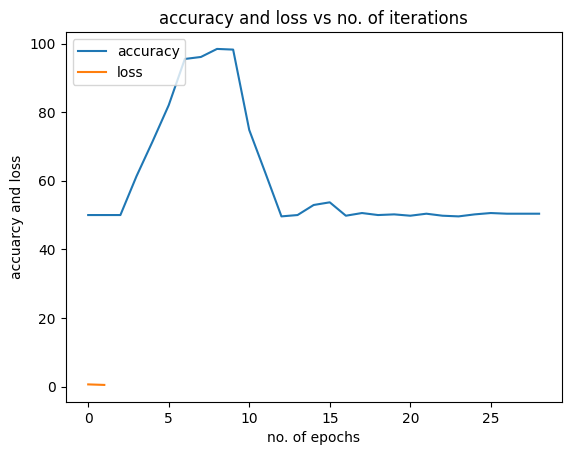

8/8 [==============================] - 0s 4ms/step


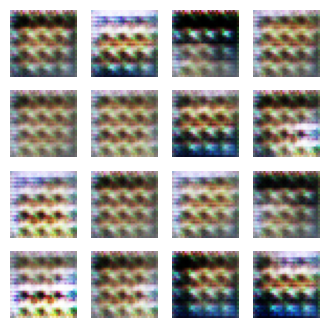

8/8 [==============================] - 0s 4ms/step
Iteration: 1451
8/8 [==============================] - 0s 5ms/step
Iteration: 1452
8/8 [==============================] - 0s 4ms/step
Iteration: 1453
8/8 [==============================] - 0s 5ms/step
Iteration: 1454
8/8 [==============================] - 0s 4ms/step
Iteration: 1455
8/8 [==============================] - 0s 4ms/step
Iteration: 1456
8/8 [==============================] - 0s 6ms/step
Iteration: 1457
8/8 [==============================] - 0s 3ms/step
Iteration: 1458
8/8 [==============================] - 0s 3ms/step
Iteration: 1459
8/8 [==============================] - 0s 3ms/step
Iteration: 1460
8/8 [==============================] - 0s 3ms/step
Iteration: 1461
8/8 [==============================] - 0s 6ms/step
Iteration: 1462
8/8 [==============================] - 0s 3ms/step
Iteration: 1463
8/8 [==============================] - 0s 3ms/step
Iteration: 1464
8/8 [==============================] - 0s 5ms/step
Iteration: 

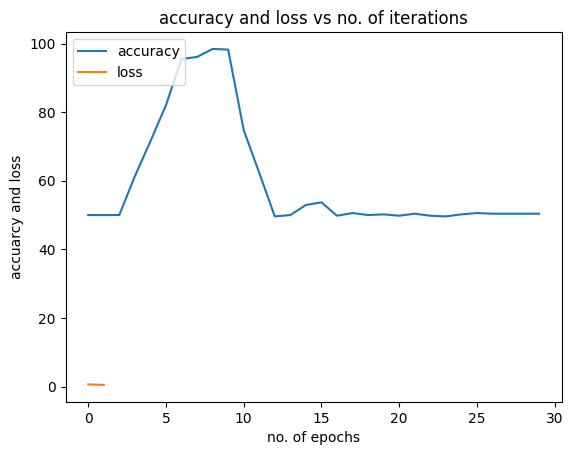

8/8 [==============================] - 0s 5ms/step


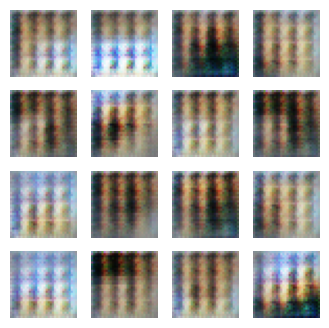

8/8 [==============================] - 0s 6ms/step
Iteration: 1501
8/8 [==============================] - 0s 5ms/step
Iteration: 1502
8/8 [==============================] - 0s 3ms/step
Iteration: 1503
8/8 [==============================] - 0s 4ms/step
Iteration: 1504
8/8 [==============================] - 0s 3ms/step
Iteration: 1505
8/8 [==============================] - 0s 3ms/step
Iteration: 1506
8/8 [==============================] - 0s 4ms/step
Iteration: 1507
8/8 [==============================] - 0s 3ms/step
Iteration: 1508
8/8 [==============================] - 0s 4ms/step
Iteration: 1509
8/8 [==============================] - 0s 3ms/step
Iteration: 1510
8/8 [==============================] - 0s 4ms/step
Iteration: 1511
8/8 [==============================] - 0s 3ms/step
Iteration: 1512
8/8 [==============================] - 0s 3ms/step
Iteration: 1513
8/8 [==============================] - 0s 4ms/step
Iteration: 1514
8/8 [==============================] - 0s 3ms/step
Iteration: 

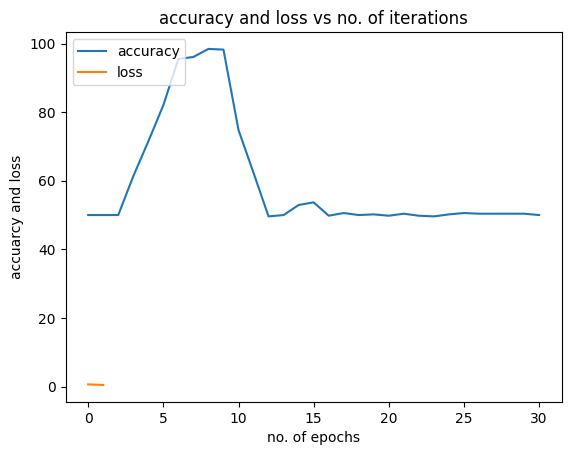

8/8 [==============================] - 0s 3ms/step


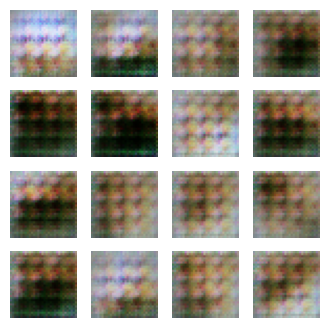

8/8 [==============================] - 0s 4ms/step
Iteration: 1551
8/8 [==============================] - 0s 3ms/step
Iteration: 1552
8/8 [==============================] - 0s 3ms/step
Iteration: 1553
8/8 [==============================] - 0s 4ms/step
Iteration: 1554
8/8 [==============================] - 0s 4ms/step
Iteration: 1555
8/8 [==============================] - 0s 4ms/step
Iteration: 1556
8/8 [==============================] - 0s 5ms/step
Iteration: 1557
8/8 [==============================] - 0s 3ms/step
Iteration: 1558
8/8 [==============================] - 0s 3ms/step
Iteration: 1559
8/8 [==============================] - 0s 3ms/step
Iteration: 1560
8/8 [==============================] - 0s 3ms/step
Iteration: 1561
8/8 [==============================] - 0s 3ms/step
Iteration: 1562
8/8 [==============================] - 0s 5ms/step
Iteration: 1563
8/8 [==============================] - 0s 3ms/step
Iteration: 1564
8/8 [==============================] - 0s 3ms/step
Iteration: 

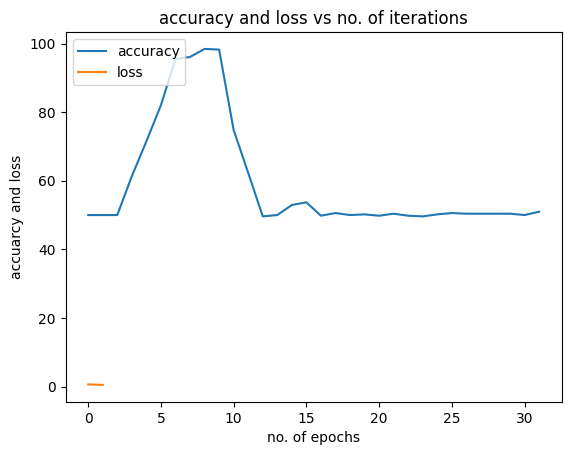

8/8 [==============================] - 0s 3ms/step


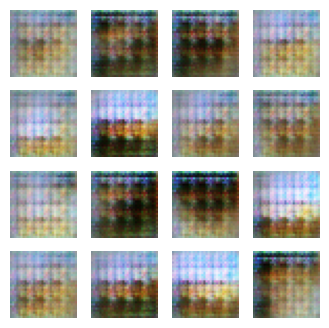

8/8 [==============================] - 0s 6ms/step
Iteration: 1601
8/8 [==============================] - 0s 4ms/step
Iteration: 1602
8/8 [==============================] - 0s 4ms/step
Iteration: 1603
8/8 [==============================] - 0s 5ms/step
Iteration: 1604
8/8 [==============================] - 0s 5ms/step
Iteration: 1605
8/8 [==============================] - 0s 4ms/step
Iteration: 1606
8/8 [==============================] - 0s 4ms/step
Iteration: 1607
8/8 [==============================] - 0s 6ms/step
Iteration: 1608
8/8 [==============================] - 0s 4ms/step
Iteration: 1609
8/8 [==============================] - 0s 4ms/step
Iteration: 1610
8/8 [==============================] - 0s 4ms/step
Iteration: 1611
8/8 [==============================] - 0s 4ms/step
Iteration: 1612
8/8 [==============================] - 0s 3ms/step
Iteration: 1613
8/8 [==============================] - 0s 4ms/step
Iteration: 1614
8/8 [==============================] - 0s 4ms/step
Iteration: 

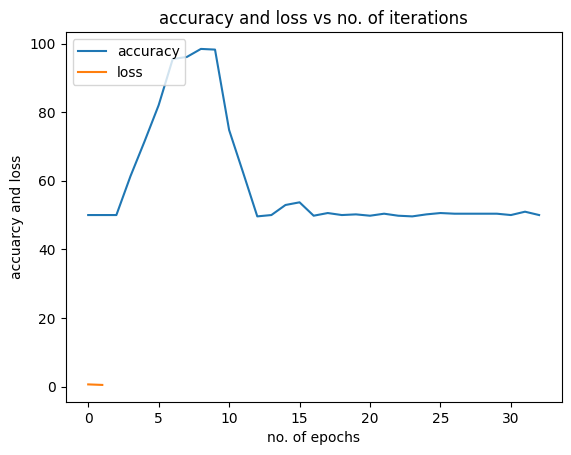

8/8 [==============================] - 0s 3ms/step


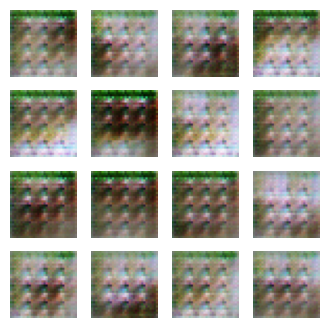

8/8 [==============================] - 0s 4ms/step
Iteration: 1651
8/8 [==============================] - 0s 3ms/step
Iteration: 1652
8/8 [==============================] - 0s 4ms/step
Iteration: 1653
8/8 [==============================] - 0s 4ms/step
Iteration: 1654
8/8 [==============================] - 0s 4ms/step
Iteration: 1655
8/8 [==============================] - 0s 4ms/step
Iteration: 1656
8/8 [==============================] - 0s 4ms/step
Iteration: 1657
8/8 [==============================] - 0s 5ms/step
Iteration: 1658
8/8 [==============================] - 0s 3ms/step
Iteration: 1659
8/8 [==============================] - 0s 4ms/step
Iteration: 1660
8/8 [==============================] - 0s 4ms/step
Iteration: 1661
8/8 [==============================] - 0s 4ms/step
Iteration: 1662
8/8 [==============================] - 0s 4ms/step
Iteration: 1663
8/8 [==============================] - 0s 4ms/step
Iteration: 1664
8/8 [==============================] - 0s 3ms/step
Iteration: 

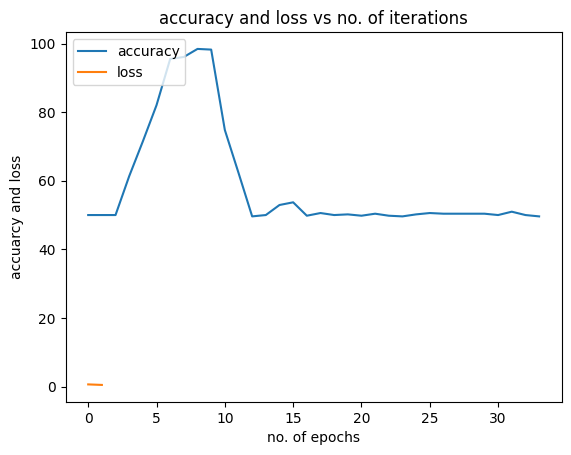

8/8 [==============================] - 0s 3ms/step


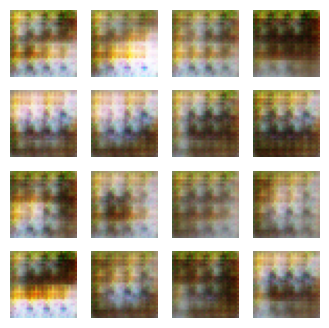

8/8 [==============================] - 0s 4ms/step
Iteration: 1701
8/8 [==============================] - 0s 3ms/step
Iteration: 1702
8/8 [==============================] - 0s 4ms/step
Iteration: 1703
8/8 [==============================] - 0s 4ms/step
Iteration: 1704
8/8 [==============================] - 0s 6ms/step
Iteration: 1705
8/8 [==============================] - 0s 5ms/step
Iteration: 1706
8/8 [==============================] - 0s 5ms/step
Iteration: 1707
8/8 [==============================] - 0s 6ms/step
Iteration: 1708
8/8 [==============================] - 0s 7ms/step
Iteration: 1709
8/8 [==============================] - 0s 4ms/step
Iteration: 1710
8/8 [==============================] - 0s 5ms/step
Iteration: 1711
8/8 [==============================] - 0s 4ms/step
Iteration: 1712
8/8 [==============================] - 0s 3ms/step
Iteration: 1713
8/8 [==============================] - 0s 3ms/step
Iteration: 1714
8/8 [==============================] - 0s 4ms/step
Iteration: 

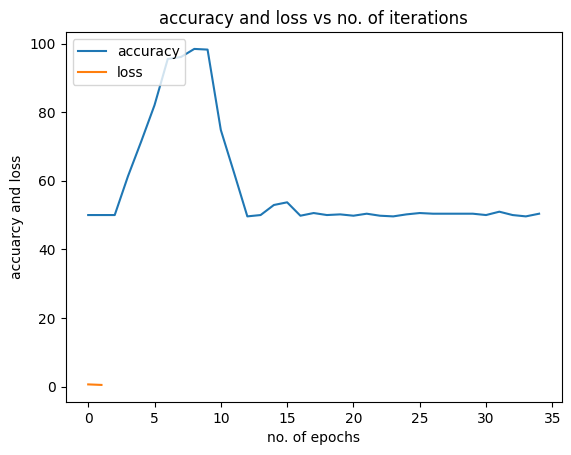

8/8 [==============================] - 0s 3ms/step


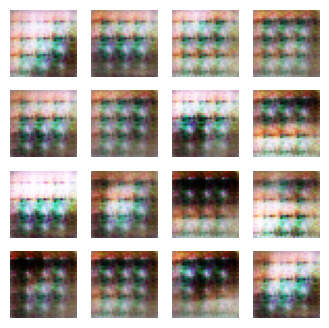

8/8 [==============================] - 0s 7ms/step
Iteration: 1751
8/8 [==============================] - 0s 4ms/step
Iteration: 1752
8/8 [==============================] - 0s 4ms/step
Iteration: 1753
8/8 [==============================] - 0s 3ms/step
Iteration: 1754
8/8 [==============================] - 0s 4ms/step
Iteration: 1755
8/8 [==============================] - 0s 4ms/step
Iteration: 1756
8/8 [==============================] - 0s 4ms/step
Iteration: 1757
8/8 [==============================] - 0s 3ms/step
Iteration: 1758
8/8 [==============================] - 0s 3ms/step
Iteration: 1759
8/8 [==============================] - 0s 4ms/step
Iteration: 1760
8/8 [==============================] - 0s 3ms/step
Iteration: 1761
8/8 [==============================] - 0s 3ms/step
Iteration: 1762
8/8 [==============================] - 0s 4ms/step
Iteration: 1763
8/8 [==============================] - 0s 4ms/step
Iteration: 1764
8/8 [==============================] - 0s 3ms/step
Iteration: 

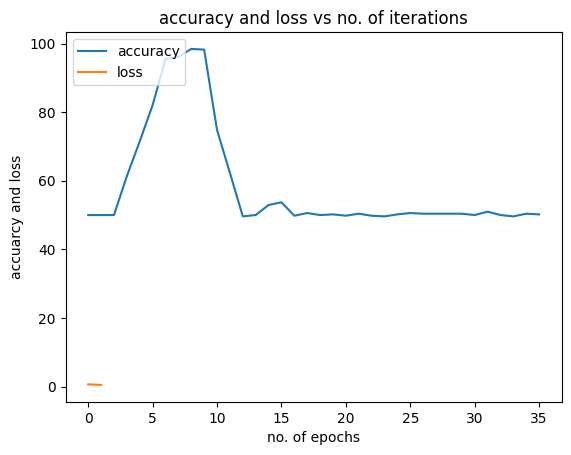

8/8 [==============================] - 0s 4ms/step


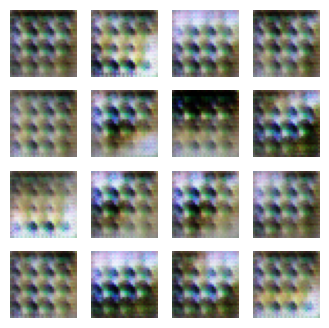

8/8 [==============================] - 0s 3ms/step
Iteration: 1801
8/8 [==============================] - 0s 3ms/step
Iteration: 1802
8/8 [==============================] - 0s 5ms/step
Iteration: 1803
8/8 [==============================] - 0s 3ms/step
Iteration: 1804
8/8 [==============================] - 0s 4ms/step
Iteration: 1805
8/8 [==============================] - 0s 3ms/step
Iteration: 1806
8/8 [==============================] - 0s 4ms/step
Iteration: 1807
8/8 [==============================] - 0s 3ms/step
Iteration: 1808
8/8 [==============================] - 0s 4ms/step
Iteration: 1809
8/8 [==============================] - 0s 3ms/step
Iteration: 1810
8/8 [==============================] - 0s 4ms/step
Iteration: 1811
8/8 [==============================] - 0s 4ms/step
Iteration: 1812
8/8 [==============================] - 0s 5ms/step
Iteration: 1813
8/8 [==============================] - 0s 4ms/step
Iteration: 1814
8/8 [==============================] - 0s 6ms/step
Iteration: 

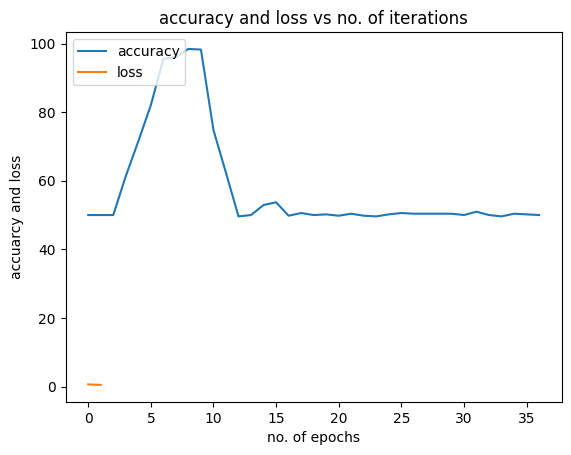

8/8 [==============================] - 0s 5ms/step


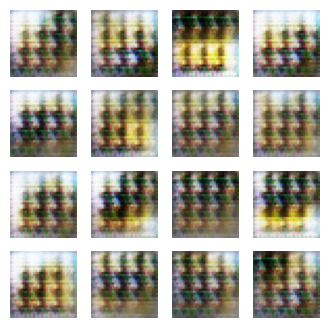

8/8 [==============================] - 0s 7ms/step
Iteration: 1851
8/8 [==============================] - 0s 5ms/step
Iteration: 1852
8/8 [==============================] - 0s 5ms/step
Iteration: 1853
8/8 [==============================] - 0s 3ms/step
Iteration: 1854
8/8 [==============================] - 0s 4ms/step
Iteration: 1855
8/8 [==============================] - 0s 4ms/step
Iteration: 1856
8/8 [==============================] - 0s 3ms/step
Iteration: 1857
8/8 [==============================] - 0s 5ms/step
Iteration: 1858
8/8 [==============================] - 0s 3ms/step
Iteration: 1859
8/8 [==============================] - 0s 3ms/step
Iteration: 1860
8/8 [==============================] - 0s 3ms/step
Iteration: 1861
8/8 [==============================] - 0s 3ms/step
Iteration: 1862
8/8 [==============================] - 0s 5ms/step
Iteration: 1863
8/8 [==============================] - 0s 3ms/step
Iteration: 1864
8/8 [==============================] - 0s 4ms/step
Iteration: 

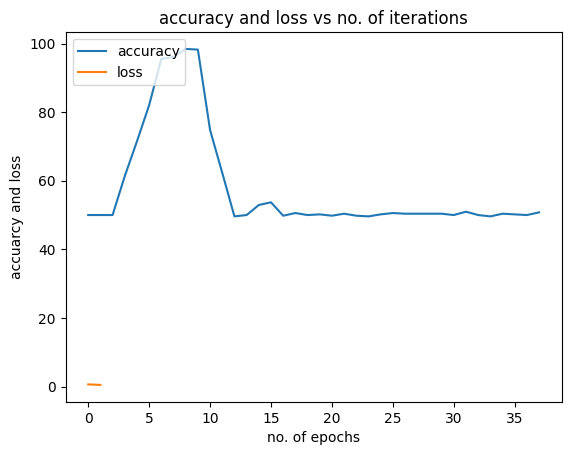

8/8 [==============================] - 0s 3ms/step


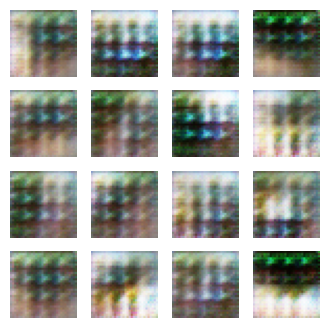

8/8 [==============================] - 0s 4ms/step
Iteration: 1901
8/8 [==============================] - 0s 3ms/step
Iteration: 1902
8/8 [==============================] - 0s 4ms/step
Iteration: 1903
8/8 [==============================] - 0s 4ms/step
Iteration: 1904
8/8 [==============================] - 0s 3ms/step
Iteration: 1905
8/8 [==============================] - 0s 3ms/step
Iteration: 1906
8/8 [==============================] - 0s 4ms/step
Iteration: 1907
8/8 [==============================] - 0s 3ms/step
Iteration: 1908
8/8 [==============================] - 0s 4ms/step
Iteration: 1909
8/8 [==============================] - 0s 4ms/step
Iteration: 1910
8/8 [==============================] - 0s 4ms/step
Iteration: 1911
8/8 [==============================] - 0s 5ms/step
Iteration: 1912
8/8 [==============================] - 0s 6ms/step
Iteration: 1913
8/8 [==============================] - 0s 4ms/step
Iteration: 1914
8/8 [==============================] - 0s 5ms/step
Iteration: 

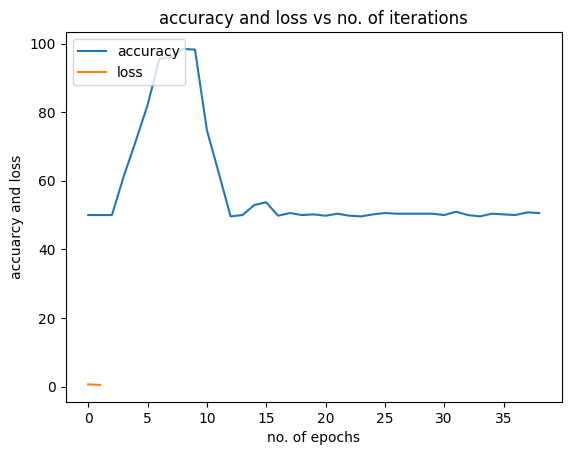

8/8 [==============================] - 0s 4ms/step


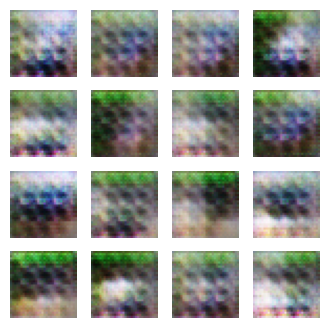

8/8 [==============================] - 0s 7ms/step
Iteration: 1951
8/8 [==============================] - 0s 4ms/step
Iteration: 1952
8/8 [==============================] - 0s 4ms/step
Iteration: 1953
8/8 [==============================] - 0s 5ms/step
Iteration: 1954
8/8 [==============================] - 0s 5ms/step
Iteration: 1955
8/8 [==============================] - 0s 3ms/step
Iteration: 1956
8/8 [==============================] - 0s 3ms/step
Iteration: 1957
8/8 [==============================] - 0s 5ms/step
Iteration: 1958
8/8 [==============================] - 0s 3ms/step
Iteration: 1959
8/8 [==============================] - 0s 3ms/step
Iteration: 1960
8/8 [==============================] - 0s 4ms/step
Iteration: 1961
8/8 [==============================] - 0s 3ms/step
Iteration: 1962
8/8 [==============================] - 0s 3ms/step
Iteration: 1963
8/8 [==============================] - 0s 3ms/step
Iteration: 1964
8/8 [==============================] - 0s 3ms/step
Iteration: 

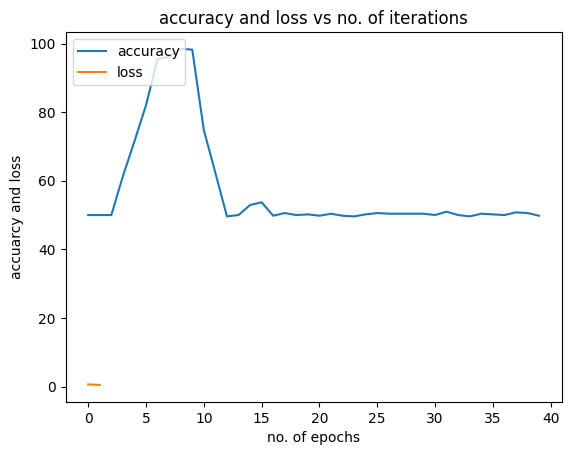

8/8 [==============================] - 0s 3ms/step


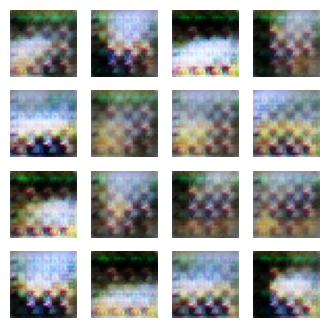

8/8 [==============================] - 0s 3ms/step
Iteration: 2001
8/8 [==============================] - 0s 4ms/step
Iteration: 2002
8/8 [==============================] - 0s 5ms/step
Iteration: 2003
8/8 [==============================] - 0s 5ms/step
Iteration: 2004
8/8 [==============================] - 0s 4ms/step
Iteration: 2005
8/8 [==============================] - 0s 3ms/step
Iteration: 2006
8/8 [==============================] - 0s 3ms/step
Iteration: 2007
8/8 [==============================] - 0s 3ms/step
Iteration: 2008
8/8 [==============================] - 0s 3ms/step
Iteration: 2009
8/8 [==============================] - 0s 4ms/step
Iteration: 2010
8/8 [==============================] - 0s 4ms/step
Iteration: 2011
8/8 [==============================] - 0s 3ms/step
Iteration: 2012
8/8 [==============================] - 0s 3ms/step
Iteration: 2013
8/8 [==============================] - 0s 4ms/step
Iteration: 2014
8/8 [==============================] - 0s 5ms/step
Iteration: 

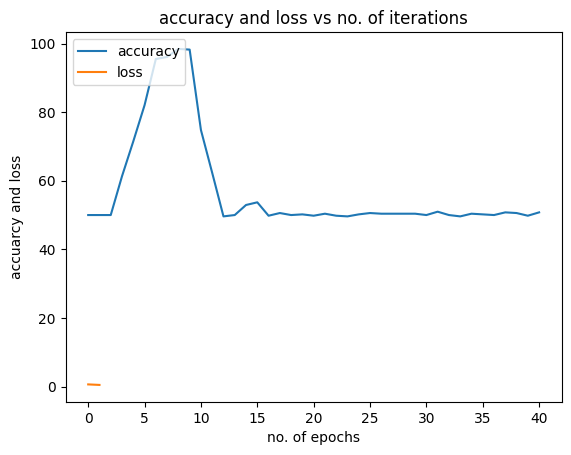

8/8 [==============================] - 0s 5ms/step


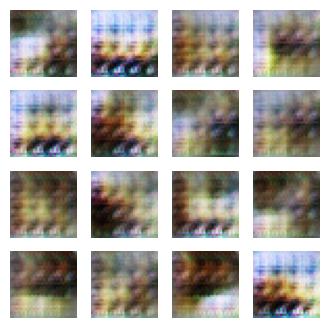

8/8 [==============================] - 0s 8ms/step
Iteration: 2051
8/8 [==============================] - 0s 5ms/step
Iteration: 2052
8/8 [==============================] - 0s 5ms/step
Iteration: 2053
8/8 [==============================] - 0s 4ms/step
Iteration: 2054
8/8 [==============================] - 0s 3ms/step
Iteration: 2055
8/8 [==============================] - 0s 3ms/step
Iteration: 2056
8/8 [==============================] - 0s 3ms/step
Iteration: 2057
8/8 [==============================] - 0s 5ms/step
Iteration: 2058
8/8 [==============================] - 0s 3ms/step
Iteration: 2059
8/8 [==============================] - 0s 3ms/step
Iteration: 2060
8/8 [==============================] - 0s 4ms/step
Iteration: 2061
8/8 [==============================] - 0s 3ms/step
Iteration: 2062
8/8 [==============================] - 0s 3ms/step
Iteration: 2063
8/8 [==============================] - 0s 4ms/step
Iteration: 2064
8/8 [==============================] - 0s 3ms/step
Iteration: 

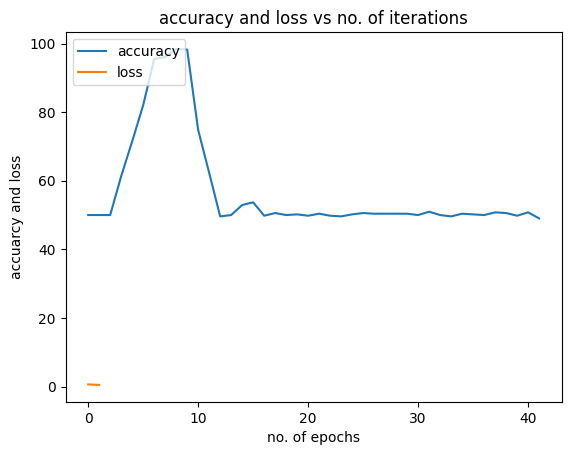

8/8 [==============================] - 0s 6ms/step


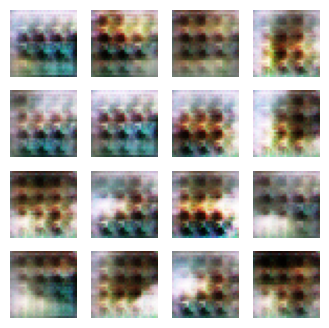

8/8 [==============================] - 0s 6ms/step
Iteration: 2101
8/8 [==============================] - 0s 4ms/step
Iteration: 2102
8/8 [==============================] - 0s 3ms/step
Iteration: 2103
8/8 [==============================] - 0s 3ms/step
Iteration: 2104
8/8 [==============================] - 0s 4ms/step
Iteration: 2105
8/8 [==============================] - 0s 3ms/step
Iteration: 2106
8/8 [==============================] - 0s 3ms/step
Iteration: 2107
8/8 [==============================] - 0s 3ms/step
Iteration: 2108
8/8 [==============================] - 0s 4ms/step
Iteration: 2109
8/8 [==============================] - 0s 3ms/step
Iteration: 2110
8/8 [==============================] - 0s 3ms/step
Iteration: 2111
8/8 [==============================] - 0s 3ms/step
Iteration: 2112
8/8 [==============================] - 0s 3ms/step
Iteration: 2113
8/8 [==============================] - 0s 3ms/step
Iteration: 2114
8/8 [==============================] - 0s 4ms/step
Iteration: 

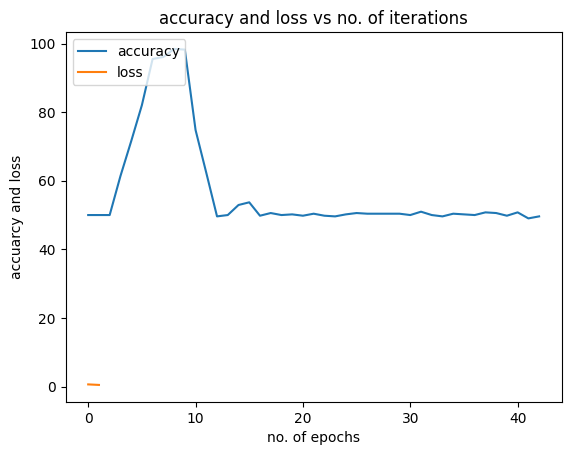

8/8 [==============================] - 0s 4ms/step


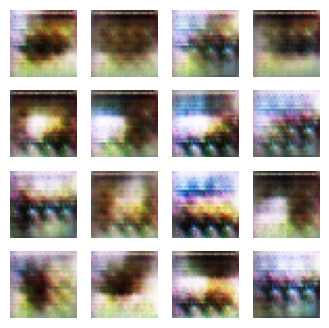

8/8 [==============================] - 0s 6ms/step
Iteration: 2151
8/8 [==============================] - 0s 5ms/step
Iteration: 2152
8/8 [==============================] - 0s 4ms/step
Iteration: 2153
8/8 [==============================] - 0s 4ms/step
Iteration: 2154
8/8 [==============================] - 0s 3ms/step
Iteration: 2155
8/8 [==============================] - 0s 3ms/step
Iteration: 2156
8/8 [==============================] - 0s 3ms/step
Iteration: 2157
8/8 [==============================] - 0s 5ms/step
Iteration: 2158
8/8 [==============================] - 0s 4ms/step
Iteration: 2159
8/8 [==============================] - 0s 3ms/step
Iteration: 2160
8/8 [==============================] - 0s 5ms/step
Iteration: 2161
8/8 [==============================] - 0s 3ms/step
Iteration: 2162
8/8 [==============================] - 0s 4ms/step
Iteration: 2163
8/8 [==============================] - 0s 6ms/step
Iteration: 2164
8/8 [==============================] - 0s 4ms/step
Iteration: 

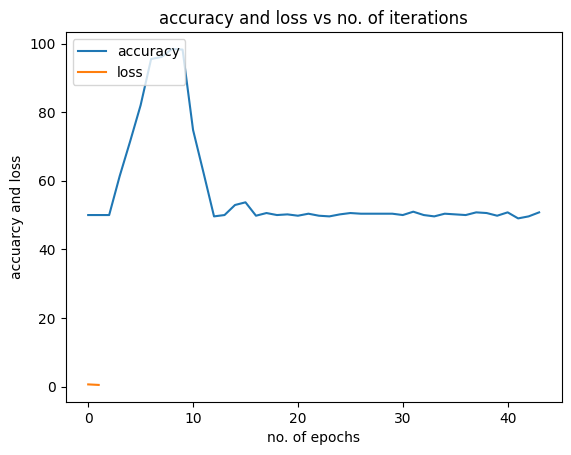

8/8 [==============================] - 0s 3ms/step


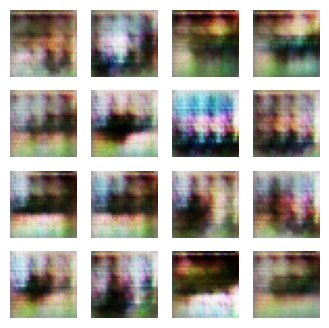

8/8 [==============================] - 0s 6ms/step
Iteration: 2201
8/8 [==============================] - 0s 5ms/step
Iteration: 2202
8/8 [==============================] - 0s 5ms/step
Iteration: 2203
8/8 [==============================] - 0s 3ms/step
Iteration: 2204
8/8 [==============================] - 0s 4ms/step
Iteration: 2205
8/8 [==============================] - 0s 3ms/step
Iteration: 2206
8/8 [==============================] - 0s 5ms/step
Iteration: 2207
8/8 [==============================] - 0s 5ms/step
Iteration: 2208
8/8 [==============================] - 0s 3ms/step
Iteration: 2209
8/8 [==============================] - 0s 4ms/step
Iteration: 2210
8/8 [==============================] - 0s 4ms/step
Iteration: 2211
8/8 [==============================] - 0s 3ms/step
Iteration: 2212
8/8 [==============================] - 0s 4ms/step
Iteration: 2213
8/8 [==============================] - 0s 3ms/step
Iteration: 2214
8/8 [==============================] - 0s 4ms/step
Iteration: 

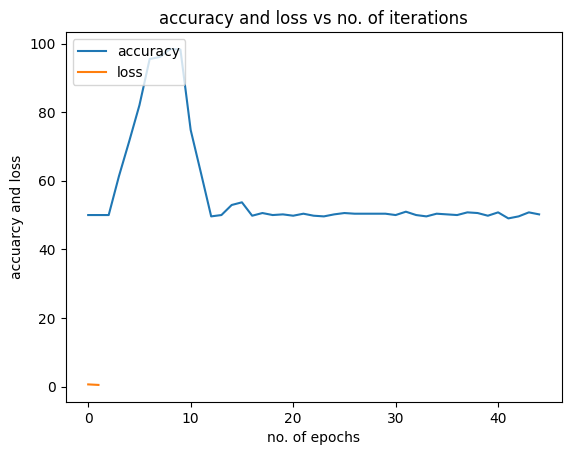

8/8 [==============================] - 0s 3ms/step


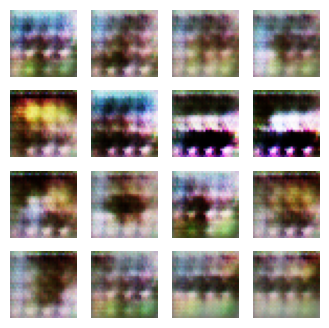

8/8 [==============================] - 0s 4ms/step
Iteration: 2251
8/8 [==============================] - 0s 4ms/step
Iteration: 2252
8/8 [==============================] - 0s 5ms/step
Iteration: 2253
8/8 [==============================] - 0s 5ms/step
Iteration: 2254
8/8 [==============================] - 0s 5ms/step
Iteration: 2255
8/8 [==============================] - 0s 3ms/step
Iteration: 2256
8/8 [==============================] - 0s 4ms/step
Iteration: 2257
8/8 [==============================] - 0s 3ms/step
Iteration: 2258
8/8 [==============================] - 0s 3ms/step
Iteration: 2259
8/8 [==============================] - 0s 3ms/step
Iteration: 2260
8/8 [==============================] - 0s 3ms/step
Iteration: 2261
8/8 [==============================] - 0s 6ms/step
Iteration: 2262
8/8 [==============================] - 0s 4ms/step
Iteration: 2263
8/8 [==============================] - 0s 3ms/step
Iteration: 2264
8/8 [==============================] - 0s 4ms/step
Iteration: 

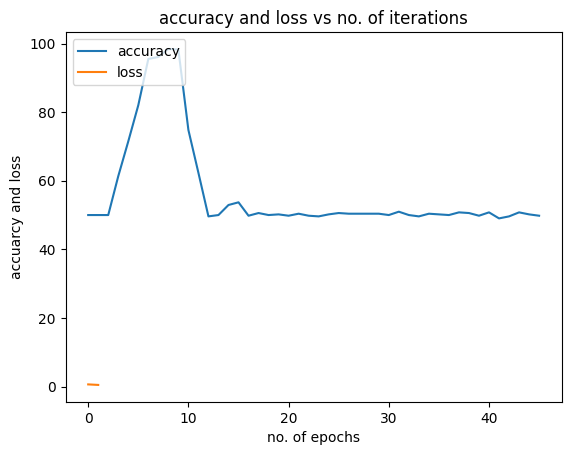

8/8 [==============================] - 0s 3ms/step


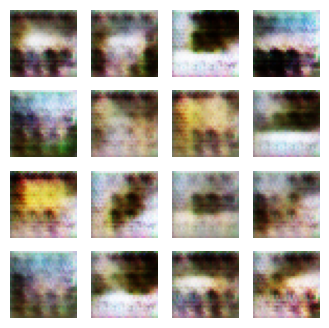

8/8 [==============================] - 0s 3ms/step
Iteration: 2301
8/8 [==============================] - 0s 4ms/step
Iteration: 2302
8/8 [==============================] - 0s 3ms/step
Iteration: 2303
8/8 [==============================] - 0s 3ms/step
Iteration: 2304
8/8 [==============================] - 0s 3ms/step
Iteration: 2305
8/8 [==============================] - 0s 4ms/step
Iteration: 2306
8/8 [==============================] - 0s 4ms/step
Iteration: 2307
8/8 [==============================] - 0s 3ms/step
Iteration: 2308
8/8 [==============================] - 0s 4ms/step
Iteration: 2309
8/8 [==============================] - 0s 4ms/step
Iteration: 2310
8/8 [==============================] - 0s 5ms/step
Iteration: 2311
8/8 [==============================] - 0s 4ms/step
Iteration: 2312
8/8 [==============================] - 0s 3ms/step
Iteration: 2313
8/8 [==============================] - 0s 3ms/step
Iteration: 2314
8/8 [==============================] - 0s 4ms/step
Iteration: 

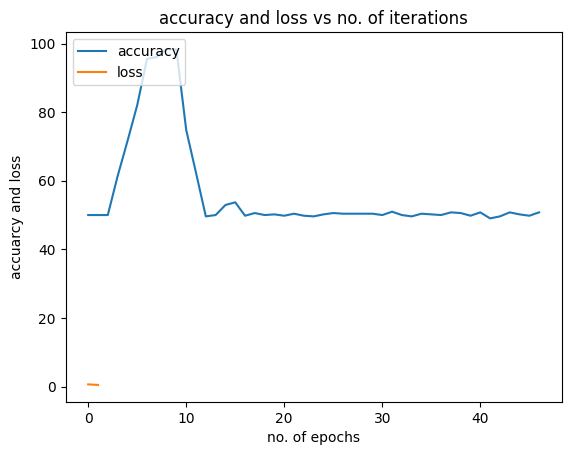

8/8 [==============================] - 0s 4ms/step


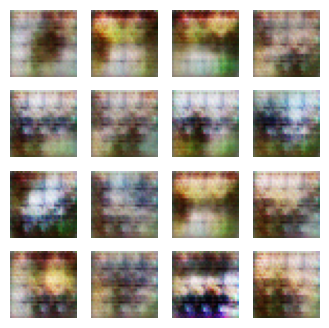

8/8 [==============================] - 0s 5ms/step
Iteration: 2351
8/8 [==============================] - 0s 4ms/step
Iteration: 2352
8/8 [==============================] - 0s 3ms/step
Iteration: 2353
8/8 [==============================] - 0s 4ms/step
Iteration: 2354
8/8 [==============================] - 0s 4ms/step
Iteration: 2355
8/8 [==============================] - 0s 5ms/step
Iteration: 2356
8/8 [==============================] - 0s 4ms/step
Iteration: 2357
8/8 [==============================] - 0s 4ms/step
Iteration: 2358
8/8 [==============================] - 0s 3ms/step
Iteration: 2359
8/8 [==============================] - 0s 3ms/step
Iteration: 2360
8/8 [==============================] - 0s 3ms/step
Iteration: 2361
8/8 [==============================] - 0s 4ms/step
Iteration: 2362
8/8 [==============================] - 0s 3ms/step
Iteration: 2363
8/8 [==============================] - 0s 3ms/step
Iteration: 2364
8/8 [==============================] - 0s 3ms/step
Iteration: 

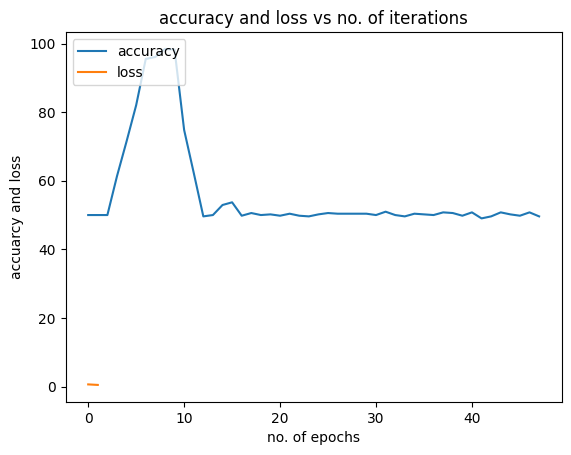

8/8 [==============================] - 0s 3ms/step


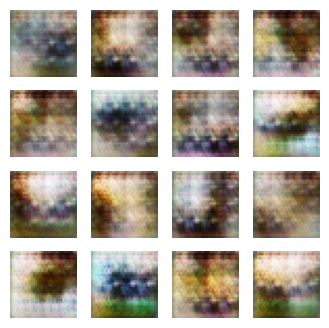

8/8 [==============================] - 0s 6ms/step
Iteration: 2401
8/8 [==============================] - 0s 4ms/step
Iteration: 2402
8/8 [==============================] - 0s 4ms/step
Iteration: 2403
8/8 [==============================] - 0s 3ms/step
Iteration: 2404
8/8 [==============================] - 0s 3ms/step
Iteration: 2405
8/8 [==============================] - 0s 3ms/step
Iteration: 2406
8/8 [==============================] - 0s 4ms/step
Iteration: 2407
8/8 [==============================] - 0s 4ms/step
Iteration: 2408
8/8 [==============================] - 0s 3ms/step
Iteration: 2409
8/8 [==============================] - 0s 3ms/step
Iteration: 2410
8/8 [==============================] - 0s 5ms/step
Iteration: 2411
8/8 [==============================] - 0s 3ms/step
Iteration: 2412
8/8 [==============================] - 0s 4ms/step
Iteration: 2413
8/8 [==============================] - 0s 4ms/step
Iteration: 2414
8/8 [==============================] - 0s 3ms/step
Iteration: 

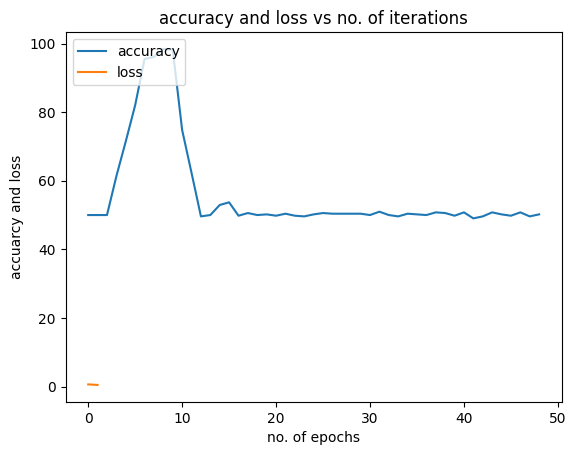

8/8 [==============================] - 0s 4ms/step


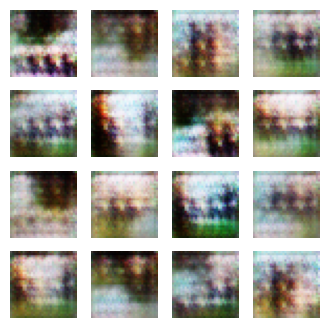

8/8 [==============================] - 0s 6ms/step
Iteration: 2451
8/8 [==============================] - 0s 5ms/step
Iteration: 2452
8/8 [==============================] - 0s 4ms/step
Iteration: 2453
8/8 [==============================] - 0s 4ms/step
Iteration: 2454
8/8 [==============================] - 0s 4ms/step
Iteration: 2455
8/8 [==============================] - 0s 5ms/step
Iteration: 2456
8/8 [==============================] - 0s 3ms/step
Iteration: 2457
8/8 [==============================] - 0s 3ms/step
Iteration: 2458
8/8 [==============================] - 0s 4ms/step
Iteration: 2459
8/8 [==============================] - 0s 5ms/step
Iteration: 2460
8/8 [==============================] - 0s 3ms/step
Iteration: 2461
8/8 [==============================] - 0s 4ms/step
Iteration: 2462
8/8 [==============================] - 0s 4ms/step
Iteration: 2463
8/8 [==============================] - 0s 3ms/step
Iteration: 2464
8/8 [==============================] - 0s 3ms/step
Iteration: 

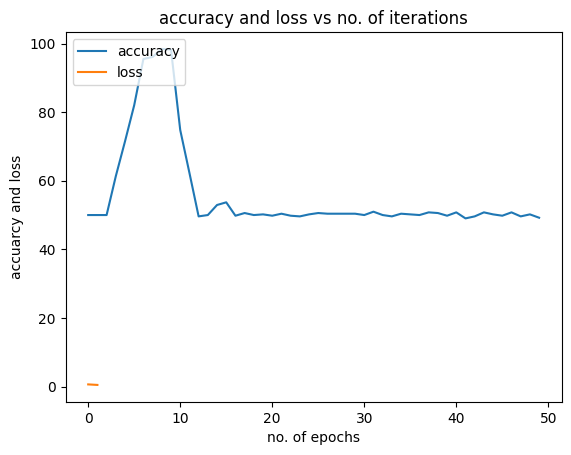

8/8 [==============================] - 0s 3ms/step


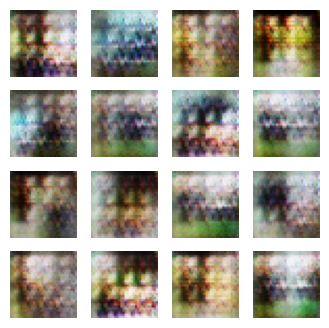

8/8 [==============================] - 0s 7ms/step
Iteration: 2501
8/8 [==============================] - 0s 5ms/step
Iteration: 2502
8/8 [==============================] - 0s 4ms/step
Iteration: 2503
8/8 [==============================] - 0s 4ms/step
Iteration: 2504
8/8 [==============================] - 0s 4ms/step
Iteration: 2505
8/8 [==============================] - 0s 4ms/step
Iteration: 2506
8/8 [==============================] - 0s 3ms/step
Iteration: 2507
8/8 [==============================] - 0s 4ms/step
Iteration: 2508
8/8 [==============================] - 0s 4ms/step
Iteration: 2509
8/8 [==============================] - 0s 3ms/step
Iteration: 2510
8/8 [==============================] - 0s 4ms/step
Iteration: 2511
8/8 [==============================] - 0s 4ms/step
Iteration: 2512
8/8 [==============================] - 0s 4ms/step
Iteration: 2513
8/8 [==============================] - 0s 3ms/step
Iteration: 2514
8/8 [==============================] - 0s 3ms/step
Iteration: 

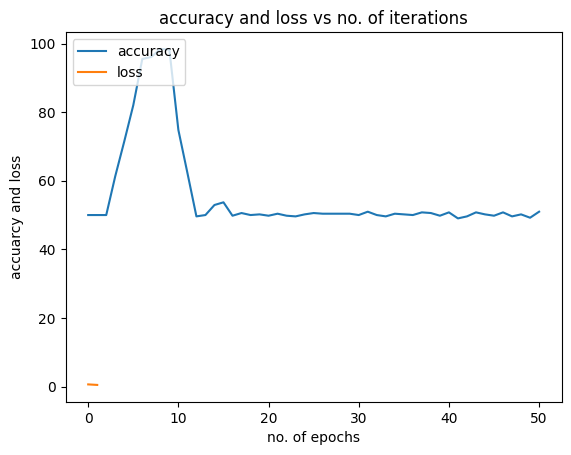

8/8 [==============================] - 0s 4ms/step


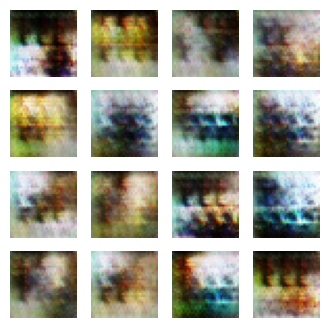

8/8 [==============================] - 0s 6ms/step
Iteration: 2551
8/8 [==============================] - 0s 4ms/step
Iteration: 2552
8/8 [==============================] - 0s 4ms/step
Iteration: 2553
8/8 [==============================] - 0s 4ms/step
Iteration: 2554
8/8 [==============================] - 0s 3ms/step
Iteration: 2555
8/8 [==============================] - 0s 4ms/step
Iteration: 2556
8/8 [==============================] - 0s 4ms/step
Iteration: 2557
8/8 [==============================] - 0s 4ms/step
Iteration: 2558
8/8 [==============================] - 0s 6ms/step
Iteration: 2559
8/8 [==============================] - 0s 3ms/step
Iteration: 2560
8/8 [==============================] - 0s 3ms/step
Iteration: 2561
8/8 [==============================] - 0s 3ms/step
Iteration: 2562
8/8 [==============================] - 0s 5ms/step
Iteration: 2563
8/8 [==============================] - 0s 4ms/step
Iteration: 2564
8/8 [==============================] - 0s 3ms/step
Iteration: 

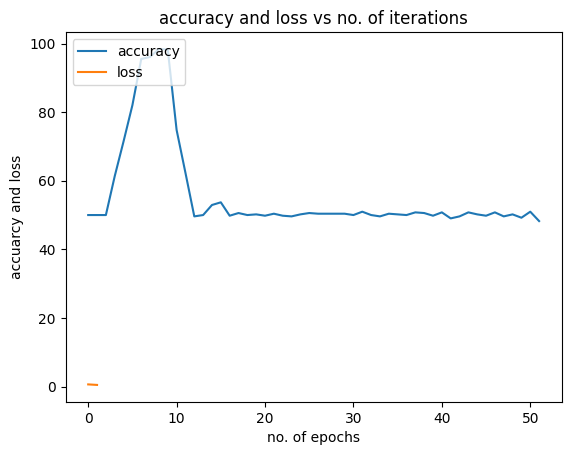

8/8 [==============================] - 0s 3ms/step


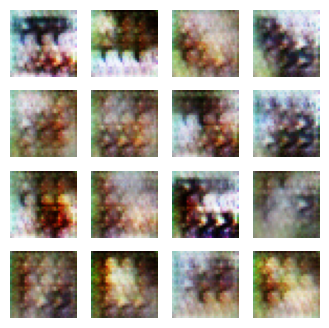

8/8 [==============================] - 0s 7ms/step
Iteration: 2601
8/8 [==============================] - 0s 5ms/step
Iteration: 2602
8/8 [==============================] - 0s 3ms/step
Iteration: 2603
8/8 [==============================] - 0s 4ms/step
Iteration: 2604
8/8 [==============================] - 0s 3ms/step
Iteration: 2605
8/8 [==============================] - 0s 3ms/step
Iteration: 2606
8/8 [==============================] - 0s 3ms/step
Iteration: 2607
8/8 [==============================] - 0s 4ms/step
Iteration: 2608
8/8 [==============================] - 0s 3ms/step
Iteration: 2609
8/8 [==============================] - 0s 4ms/step
Iteration: 2610
8/8 [==============================] - 0s 3ms/step
Iteration: 2611
8/8 [==============================] - 0s 3ms/step
Iteration: 2612
8/8 [==============================] - 0s 3ms/step
Iteration: 2613
8/8 [==============================] - 0s 3ms/step
Iteration: 2614
8/8 [==============================] - 0s 5ms/step
Iteration: 

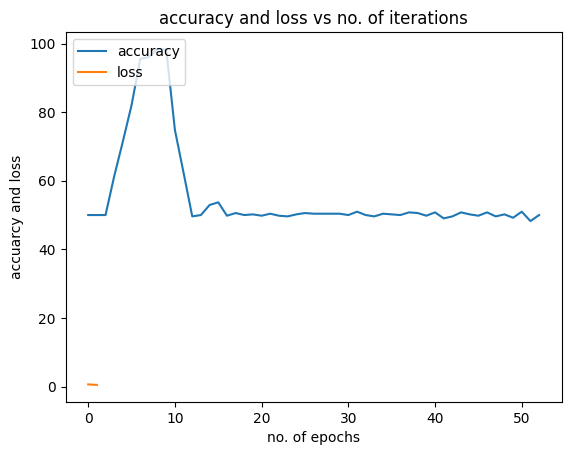

8/8 [==============================] - 0s 4ms/step


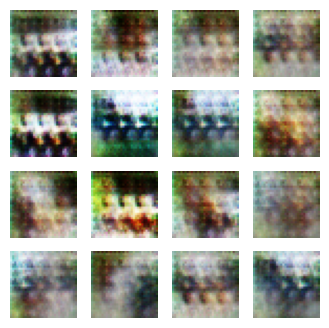

8/8 [==============================] - 0s 6ms/step
Iteration: 2651
8/8 [==============================] - 0s 4ms/step
Iteration: 2652
8/8 [==============================] - 0s 4ms/step
Iteration: 2653
8/8 [==============================] - 0s 4ms/step
Iteration: 2654
8/8 [==============================] - 0s 3ms/step
Iteration: 2655
8/8 [==============================] - 0s 3ms/step
Iteration: 2656
8/8 [==============================] - 0s 3ms/step
Iteration: 2657
8/8 [==============================] - 0s 3ms/step
Iteration: 2658
8/8 [==============================] - 0s 3ms/step
Iteration: 2659
8/8 [==============================] - 0s 4ms/step
Iteration: 2660
8/8 [==============================] - 0s 4ms/step
Iteration: 2661
8/8 [==============================] - 0s 3ms/step
Iteration: 2662
8/8 [==============================] - 0s 3ms/step
Iteration: 2663
8/8 [==============================] - 0s 3ms/step
Iteration: 2664
8/8 [==============================] - 0s 4ms/step
Iteration: 

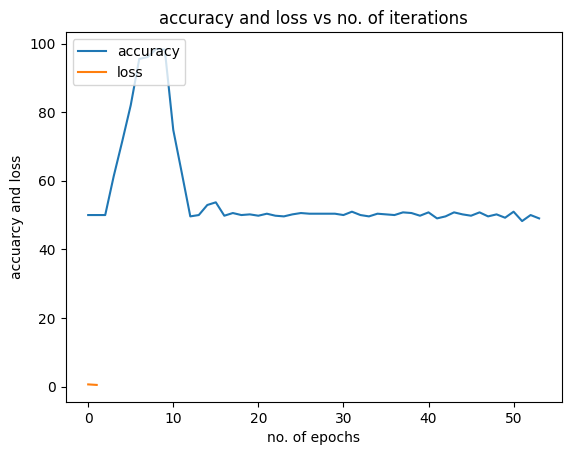

8/8 [==============================] - 0s 4ms/step


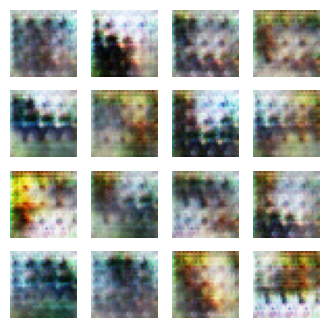

8/8 [==============================] - 0s 6ms/step
Iteration: 2701
8/8 [==============================] - 0s 4ms/step
Iteration: 2702
8/8 [==============================] - 0s 3ms/step
Iteration: 2703
8/8 [==============================] - 0s 4ms/step
Iteration: 2704
8/8 [==============================] - 0s 3ms/step
Iteration: 2705
8/8 [==============================] - 0s 3ms/step
Iteration: 2706
8/8 [==============================] - 0s 4ms/step
Iteration: 2707
8/8 [==============================] - 0s 3ms/step
Iteration: 2708
8/8 [==============================] - 0s 5ms/step
Iteration: 2709
8/8 [==============================] - 0s 4ms/step
Iteration: 2710
8/8 [==============================] - 0s 4ms/step
Iteration: 2711
8/8 [==============================] - 0s 6ms/step
Iteration: 2712
8/8 [==============================] - 0s 4ms/step
Iteration: 2713
8/8 [==============================] - 0s 4ms/step
Iteration: 2714
8/8 [==============================] - 0s 4ms/step
Iteration: 

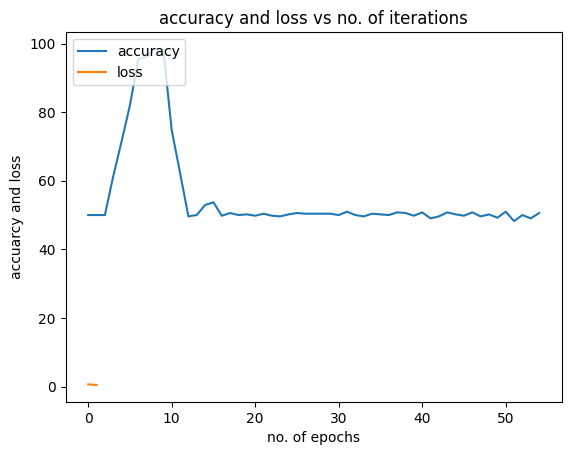

8/8 [==============================] - 0s 4ms/step


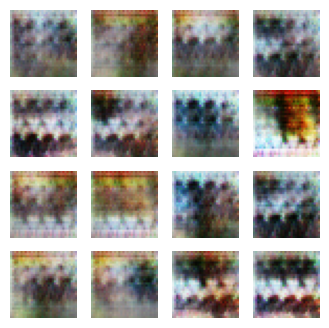

8/8 [==============================] - 0s 6ms/step
Iteration: 2751
8/8 [==============================] - 0s 4ms/step
Iteration: 2752
8/8 [==============================] - 0s 4ms/step
Iteration: 2753
8/8 [==============================] - 0s 3ms/step
Iteration: 2754
8/8 [==============================] - 0s 4ms/step
Iteration: 2755
8/8 [==============================] - 0s 4ms/step
Iteration: 2756
8/8 [==============================] - 0s 4ms/step
Iteration: 2757
8/8 [==============================] - 0s 3ms/step
Iteration: 2758
8/8 [==============================] - 0s 3ms/step
Iteration: 2759
8/8 [==============================] - 0s 4ms/step
Iteration: 2760
8/8 [==============================] - 0s 3ms/step
Iteration: 2761
8/8 [==============================] - 0s 3ms/step
Iteration: 2762
8/8 [==============================] - 0s 3ms/step
Iteration: 2763
8/8 [==============================] - 0s 3ms/step
Iteration: 2764
8/8 [==============================] - 0s 3ms/step
Iteration: 

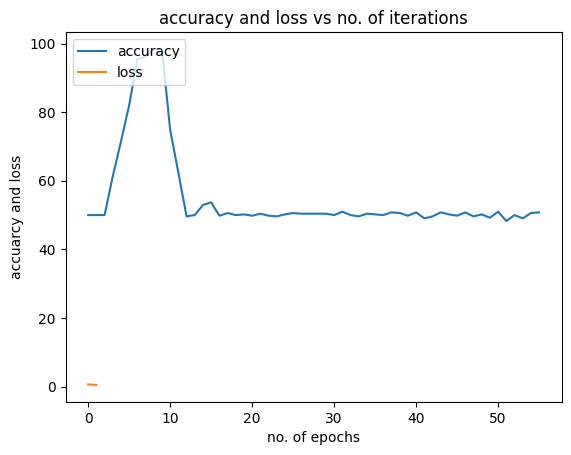

8/8 [==============================] - 0s 4ms/step


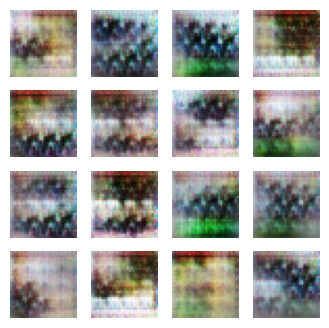

8/8 [==============================] - 0s 6ms/step
Iteration: 2801
8/8 [==============================] - 0s 3ms/step
Iteration: 2802
8/8 [==============================] - 0s 4ms/step
Iteration: 2803
8/8 [==============================] - 0s 4ms/step
Iteration: 2804
8/8 [==============================] - 0s 4ms/step
Iteration: 2805
8/8 [==============================] - 0s 4ms/step
Iteration: 2806
8/8 [==============================] - 0s 3ms/step
Iteration: 2807
8/8 [==============================] - 0s 3ms/step
Iteration: 2808
8/8 [==============================] - 0s 6ms/step
Iteration: 2809
8/8 [==============================] - 0s 4ms/step
Iteration: 2810
8/8 [==============================] - 0s 4ms/step
Iteration: 2811
8/8 [==============================] - 0s 4ms/step
Iteration: 2812
8/8 [==============================] - 0s 4ms/step
Iteration: 2813
8/8 [==============================] - 0s 4ms/step
Iteration: 2814
8/8 [==============================] - 0s 5ms/step
Iteration: 

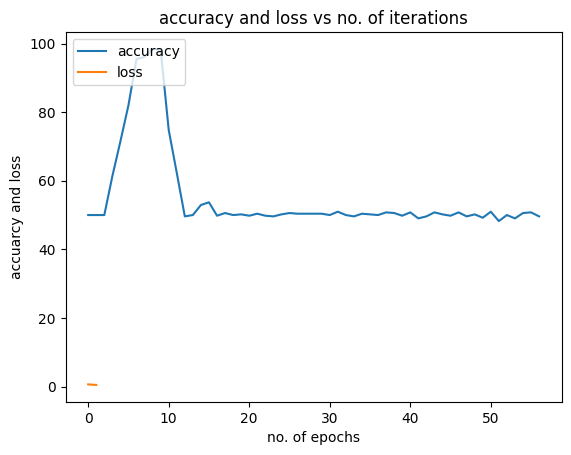

8/8 [==============================] - 0s 4ms/step


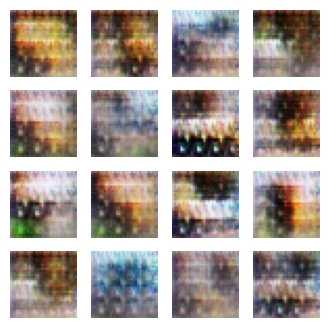

8/8 [==============================] - 0s 6ms/step
Iteration: 2851
8/8 [==============================] - 0s 4ms/step
Iteration: 2852
8/8 [==============================] - 0s 4ms/step
Iteration: 2853
8/8 [==============================] - 0s 3ms/step
Iteration: 2854
8/8 [==============================] - 0s 3ms/step
Iteration: 2855
8/8 [==============================] - 0s 4ms/step
Iteration: 2856
8/8 [==============================] - 0s 5ms/step
Iteration: 2857
8/8 [==============================] - 0s 5ms/step
Iteration: 2858
8/8 [==============================] - 0s 3ms/step
Iteration: 2859
8/8 [==============================] - 0s 3ms/step
Iteration: 2860
8/8 [==============================] - 0s 4ms/step
Iteration: 2861
8/8 [==============================] - 0s 4ms/step
Iteration: 2862
8/8 [==============================] - 0s 3ms/step
Iteration: 2863
8/8 [==============================] - 0s 3ms/step
Iteration: 2864
8/8 [==============================] - 0s 3ms/step
Iteration: 

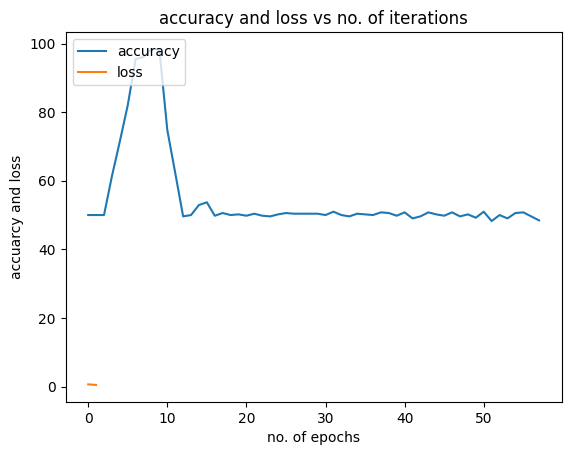

8/8 [==============================] - 0s 3ms/step


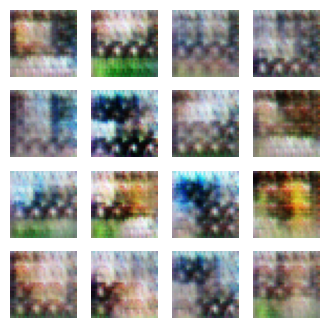

8/8 [==============================] - 0s 6ms/step
Iteration: 2901
8/8 [==============================] - 0s 4ms/step
Iteration: 2902
8/8 [==============================] - 0s 3ms/step
Iteration: 2903
8/8 [==============================] - 0s 3ms/step
Iteration: 2904
8/8 [==============================] - 0s 4ms/step
Iteration: 2905
8/8 [==============================] - 0s 3ms/step
Iteration: 2906
8/8 [==============================] - 0s 4ms/step
Iteration: 2907
8/8 [==============================] - 0s 3ms/step
Iteration: 2908
8/8 [==============================] - 0s 3ms/step
Iteration: 2909
8/8 [==============================] - 0s 5ms/step
Iteration: 2910
8/8 [==============================] - 0s 5ms/step
Iteration: 2911
8/8 [==============================] - 0s 4ms/step
Iteration: 2912
8/8 [==============================] - 0s 5ms/step
Iteration: 2913
8/8 [==============================] - 0s 3ms/step
Iteration: 2914
8/8 [==============================] - 0s 5ms/step
Iteration: 

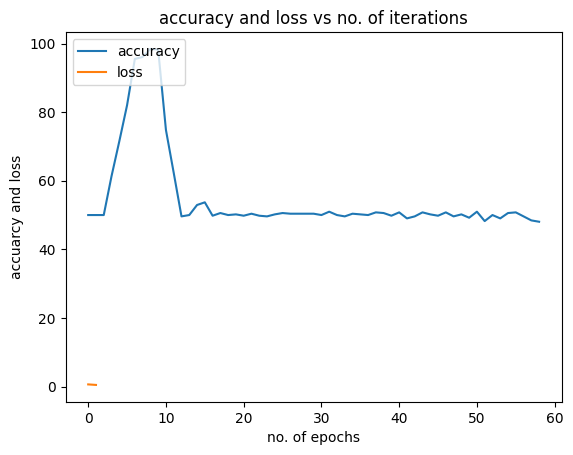

8/8 [==============================] - 0s 5ms/step


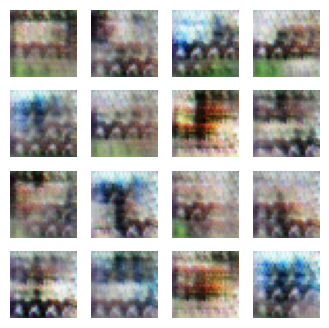

8/8 [==============================] - 0s 6ms/step
Iteration: 2951
8/8 [==============================] - 0s 4ms/step
Iteration: 2952
8/8 [==============================] - 0s 4ms/step
Iteration: 2953
8/8 [==============================] - 0s 4ms/step
Iteration: 2954
8/8 [==============================] - 0s 3ms/step
Iteration: 2955
8/8 [==============================] - 0s 3ms/step
Iteration: 2956
8/8 [==============================] - 0s 3ms/step
Iteration: 2957
8/8 [==============================] - 0s 3ms/step
Iteration: 2958
8/8 [==============================] - 0s 3ms/step
Iteration: 2959
8/8 [==============================] - 0s 3ms/step
Iteration: 2960
8/8 [==============================] - 0s 3ms/step
Iteration: 2961
8/8 [==============================] - 0s 3ms/step
Iteration: 2962
8/8 [==============================] - 0s 3ms/step
Iteration: 2963
8/8 [==============================] - 0s 4ms/step
Iteration: 2964
8/8 [==============================] - 0s 4ms/step
Iteration: 

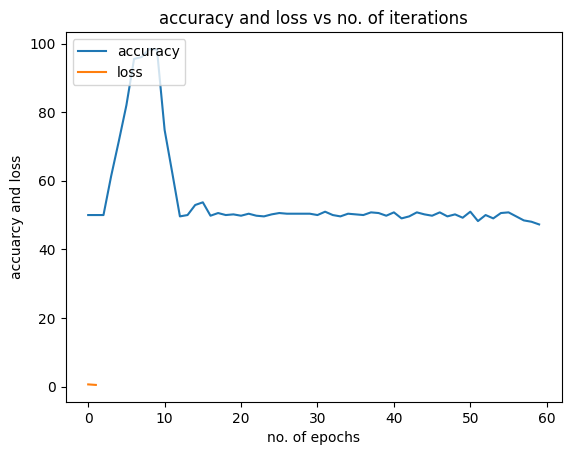

8/8 [==============================] - 0s 3ms/step


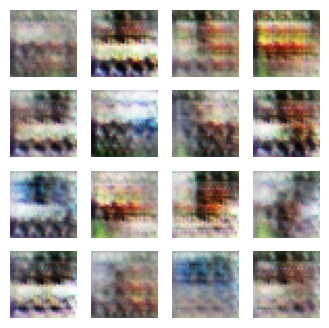

8/8 [==============================] - 0s 6ms/step
Iteration: 3001
8/8 [==============================] - 0s 3ms/step
Iteration: 3002
8/8 [==============================] - 0s 3ms/step
Iteration: 3003
8/8 [==============================] - 0s 4ms/step
Iteration: 3004
8/8 [==============================] - 0s 3ms/step
Iteration: 3005
8/8 [==============================] - 0s 4ms/step
Iteration: 3006
8/8 [==============================] - 0s 4ms/step
Iteration: 3007
8/8 [==============================] - 0s 4ms/step
Iteration: 3008
8/8 [==============================] - 0s 4ms/step
Iteration: 3009
8/8 [==============================] - 0s 3ms/step
Iteration: 3010
8/8 [==============================] - 0s 5ms/step
Iteration: 3011
8/8 [==============================] - 0s 4ms/step
Iteration: 3012
8/8 [==============================] - 0s 4ms/step
Iteration: 3013
8/8 [==============================] - 0s 5ms/step
Iteration: 3014
8/8 [==============================] - 0s 3ms/step
Iteration: 

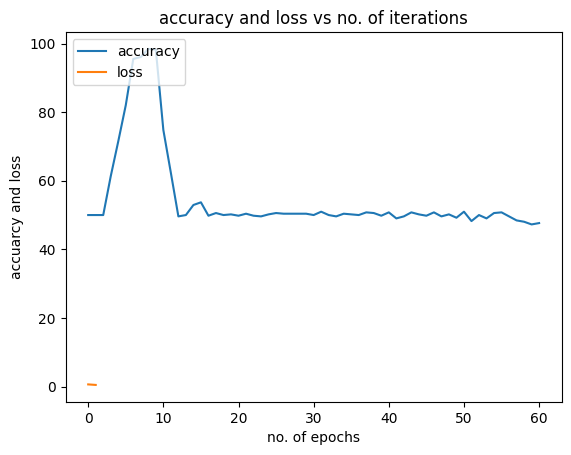

8/8 [==============================] - 0s 3ms/step


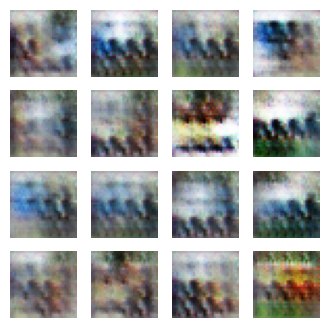

8/8 [==============================] - 0s 7ms/step
Iteration: 3051
8/8 [==============================] - 0s 4ms/step
Iteration: 3052
8/8 [==============================] - 0s 4ms/step
Iteration: 3053
8/8 [==============================] - 0s 3ms/step
Iteration: 3054
8/8 [==============================] - 0s 3ms/step
Iteration: 3055
8/8 [==============================] - 0s 3ms/step
Iteration: 3056
8/8 [==============================] - 0s 3ms/step
Iteration: 3057
8/8 [==============================] - 0s 3ms/step
Iteration: 3058
8/8 [==============================] - 0s 4ms/step
Iteration: 3059
8/8 [==============================] - 0s 4ms/step
Iteration: 3060
8/8 [==============================] - 0s 4ms/step
Iteration: 3061
8/8 [==============================] - 0s 3ms/step
Iteration: 3062
8/8 [==============================] - 0s 3ms/step
Iteration: 3063
8/8 [==============================] - 0s 3ms/step
Iteration: 3064
8/8 [==============================] - 0s 3ms/step
Iteration: 

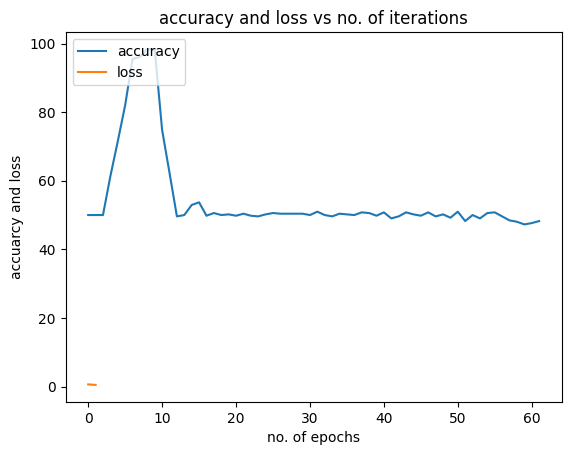

8/8 [==============================] - 0s 3ms/step


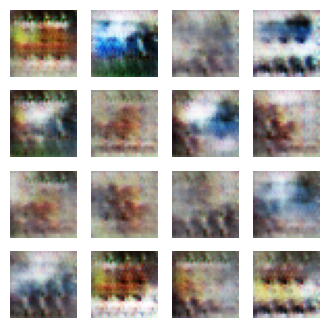

8/8 [==============================] - 0s 6ms/step
Iteration: 3101
8/8 [==============================] - 0s 4ms/step
Iteration: 3102
8/8 [==============================] - 0s 4ms/step
Iteration: 3103
8/8 [==============================] - 0s 5ms/step
Iteration: 3104
8/8 [==============================] - 0s 5ms/step
Iteration: 3105
8/8 [==============================] - 0s 4ms/step
Iteration: 3106
8/8 [==============================] - 0s 6ms/step
Iteration: 3107
8/8 [==============================] - 0s 4ms/step
Iteration: 3108
8/8 [==============================] - 0s 3ms/step
Iteration: 3109
8/8 [==============================] - 0s 4ms/step
Iteration: 3110
8/8 [==============================] - 0s 3ms/step
Iteration: 3111
8/8 [==============================] - 0s 3ms/step
Iteration: 3112
8/8 [==============================] - 0s 3ms/step
Iteration: 3113
8/8 [==============================] - 0s 3ms/step
Iteration: 3114
8/8 [==============================] - 0s 3ms/step
Iteration: 

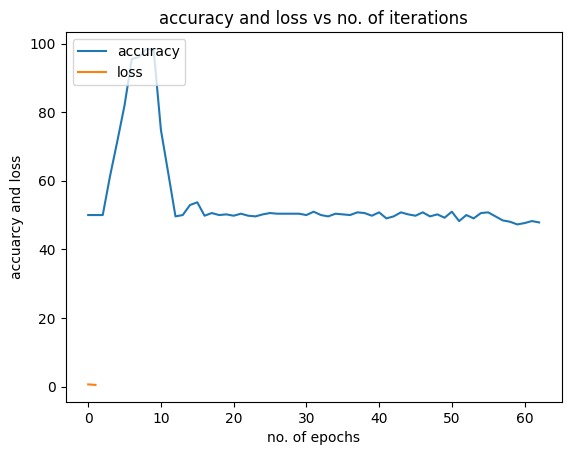

8/8 [==============================] - 0s 3ms/step


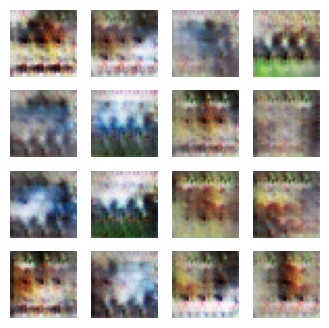

8/8 [==============================] - 0s 6ms/step
Iteration: 3151
8/8 [==============================] - 0s 4ms/step
Iteration: 3152
8/8 [==============================] - 0s 3ms/step
Iteration: 3153
8/8 [==============================] - 0s 3ms/step
Iteration: 3154
8/8 [==============================] - 0s 3ms/step
Iteration: 3155
8/8 [==============================] - 0s 4ms/step
Iteration: 3156
8/8 [==============================] - 0s 3ms/step
Iteration: 3157
8/8 [==============================] - 0s 4ms/step
Iteration: 3158
8/8 [==============================] - 0s 3ms/step
Iteration: 3159
8/8 [==============================] - 0s 3ms/step
Iteration: 3160
8/8 [==============================] - 0s 4ms/step
Iteration: 3161
8/8 [==============================] - 0s 3ms/step
Iteration: 3162
8/8 [==============================] - 0s 3ms/step
Iteration: 3163
8/8 [==============================] - 0s 4ms/step
Iteration: 3164
8/8 [==============================] - 0s 3ms/step
Iteration: 

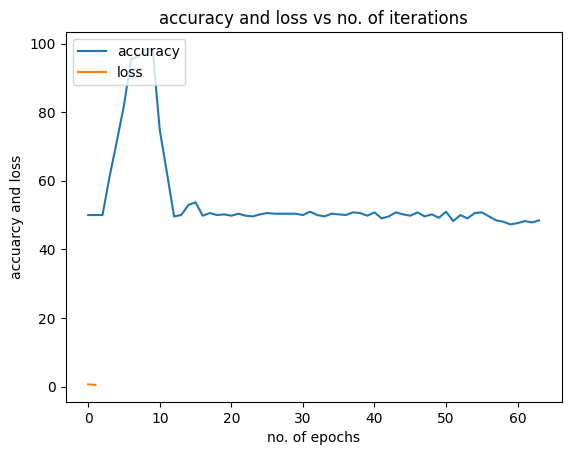

8/8 [==============================] - 0s 4ms/step


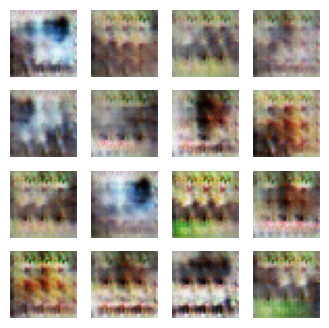

8/8 [==============================] - 0s 6ms/step
Iteration: 3201
8/8 [==============================] - 0s 5ms/step
Iteration: 3202
8/8 [==============================] - 0s 4ms/step
Iteration: 3203
8/8 [==============================] - 0s 5ms/step
Iteration: 3204
8/8 [==============================] - 0s 6ms/step
Iteration: 3205
8/8 [==============================] - 0s 4ms/step
Iteration: 3206
8/8 [==============================] - 0s 3ms/step
Iteration: 3207
8/8 [==============================] - 0s 3ms/step
Iteration: 3208
8/8 [==============================] - 0s 3ms/step
Iteration: 3209
8/8 [==============================] - 0s 4ms/step
Iteration: 3210
8/8 [==============================] - 0s 3ms/step
Iteration: 3211
8/8 [==============================] - 0s 3ms/step
Iteration: 3212
8/8 [==============================] - 0s 4ms/step
Iteration: 3213
8/8 [==============================] - 0s 3ms/step
Iteration: 3214
8/8 [==============================] - 0s 3ms/step
Iteration: 

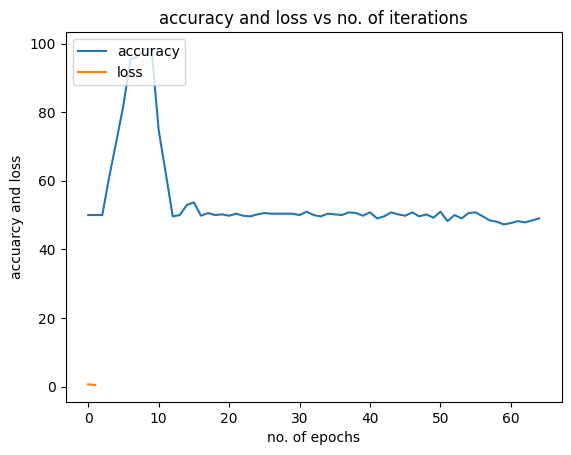

8/8 [==============================] - 0s 3ms/step


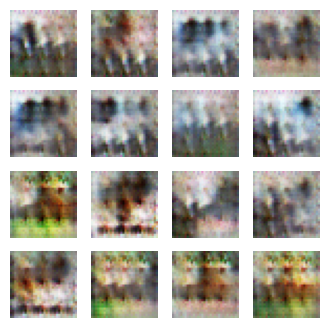

8/8 [==============================] - 0s 6ms/step
Iteration: 3251
8/8 [==============================] - 0s 4ms/step
Iteration: 3252
8/8 [==============================] - 0s 3ms/step
Iteration: 3253
8/8 [==============================] - 0s 3ms/step
Iteration: 3254
8/8 [==============================] - 0s 3ms/step
Iteration: 3255
8/8 [==============================] - 0s 3ms/step
Iteration: 3256
8/8 [==============================] - 0s 4ms/step
Iteration: 3257
8/8 [==============================] - 0s 3ms/step
Iteration: 3258
8/8 [==============================] - 0s 3ms/step
Iteration: 3259
8/8 [==============================] - 0s 3ms/step
Iteration: 3260
8/8 [==============================] - 0s 3ms/step
Iteration: 3261
8/8 [==============================] - 0s 3ms/step
Iteration: 3262
8/8 [==============================] - 0s 3ms/step
Iteration: 3263
8/8 [==============================] - 0s 3ms/step
Iteration: 3264
8/8 [==============================] - 0s 4ms/step
Iteration: 

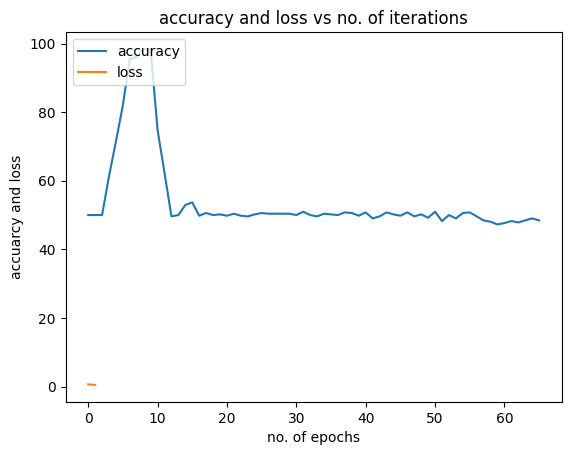

8/8 [==============================] - 0s 4ms/step


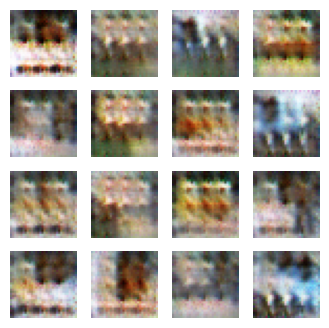

8/8 [==============================] - 0s 7ms/step
Iteration: 3301
8/8 [==============================] - 0s 5ms/step
Iteration: 3302
8/8 [==============================] - 0s 4ms/step
Iteration: 3303
8/8 [==============================] - 0s 3ms/step
Iteration: 3304
8/8 [==============================] - 0s 3ms/step
Iteration: 3305
8/8 [==============================] - 0s 3ms/step
Iteration: 3306
8/8 [==============================] - 0s 3ms/step
Iteration: 3307
8/8 [==============================] - 0s 3ms/step
Iteration: 3308
8/8 [==============================] - 0s 3ms/step
Iteration: 3309
8/8 [==============================] - 0s 3ms/step
Iteration: 3310
8/8 [==============================] - 0s 4ms/step
Iteration: 3311
8/8 [==============================] - 0s 4ms/step
Iteration: 3312
8/8 [==============================] - 0s 3ms/step
Iteration: 3313
8/8 [==============================] - 0s 4ms/step
Iteration: 3314
8/8 [==============================] - 0s 3ms/step
Iteration: 

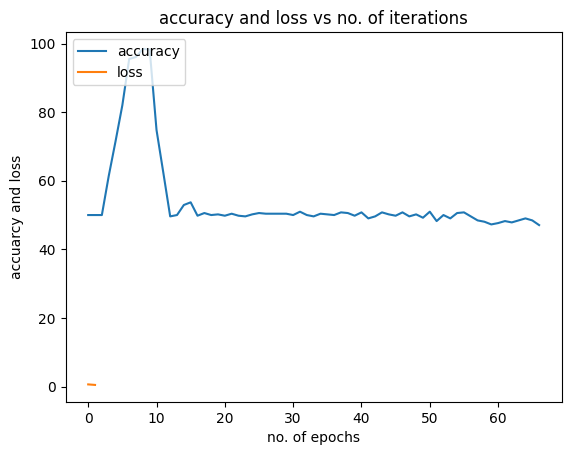

8/8 [==============================] - 0s 4ms/step


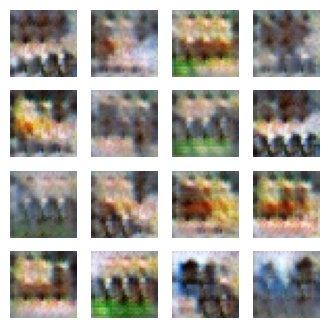

8/8 [==============================] - 0s 7ms/step
Iteration: 3351
8/8 [==============================] - 0s 4ms/step
Iteration: 3352
8/8 [==============================] - 0s 3ms/step
Iteration: 3353
8/8 [==============================] - 0s 3ms/step
Iteration: 3354
8/8 [==============================] - 0s 3ms/step
Iteration: 3355
8/8 [==============================] - 0s 3ms/step
Iteration: 3356
8/8 [==============================] - 0s 3ms/step
Iteration: 3357
8/8 [==============================] - 0s 3ms/step
Iteration: 3358
8/8 [==============================] - 0s 4ms/step
Iteration: 3359
8/8 [==============================] - 0s 3ms/step
Iteration: 3360
8/8 [==============================] - 0s 5ms/step
Iteration: 3361
8/8 [==============================] - 0s 4ms/step
Iteration: 3362
8/8 [==============================] - 0s 4ms/step
Iteration: 3363
8/8 [==============================] - 0s 5ms/step
Iteration: 3364
8/8 [==============================] - 0s 5ms/step
Iteration: 

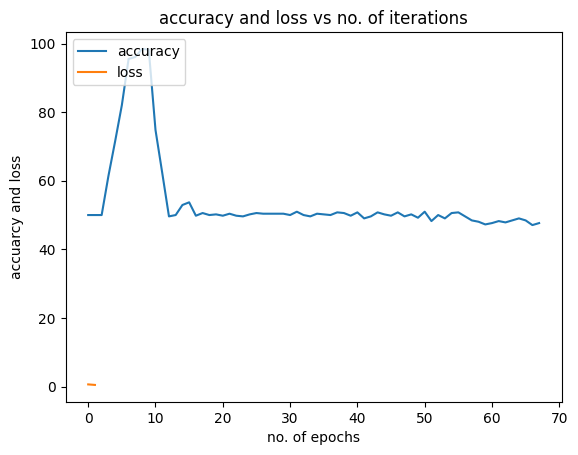

8/8 [==============================] - 0s 6ms/step


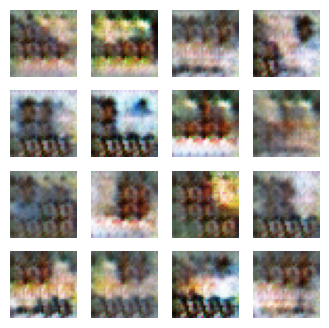

8/8 [==============================] - 0s 7ms/step
Iteration: 3401
8/8 [==============================] - 0s 4ms/step
Iteration: 3402
8/8 [==============================] - 0s 3ms/step
Iteration: 3403
8/8 [==============================] - 0s 4ms/step
Iteration: 3404
8/8 [==============================] - 0s 4ms/step
Iteration: 3405
8/8 [==============================] - 0s 3ms/step
Iteration: 3406
8/8 [==============================] - 0s 4ms/step
Iteration: 3407
8/8 [==============================] - 0s 4ms/step
Iteration: 3408
8/8 [==============================] - 0s 4ms/step
Iteration: 3409
8/8 [==============================] - 0s 3ms/step
Iteration: 3410
8/8 [==============================] - 0s 3ms/step
Iteration: 3411
8/8 [==============================] - 0s 4ms/step
Iteration: 3412
8/8 [==============================] - 0s 3ms/step
Iteration: 3413
8/8 [==============================] - 0s 3ms/step
Iteration: 3414
8/8 [==============================] - 0s 3ms/step
Iteration: 

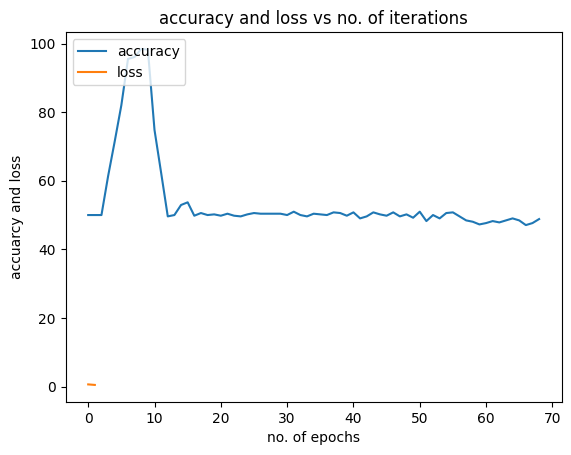

8/8 [==============================] - 0s 3ms/step


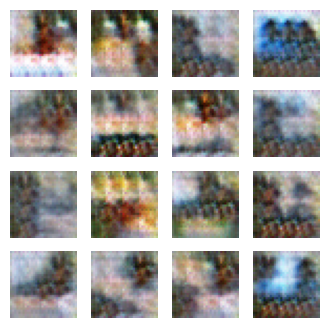

8/8 [==============================] - 0s 7ms/step
Iteration: 3451
8/8 [==============================] - 0s 4ms/step
Iteration: 3452
8/8 [==============================] - 0s 4ms/step
Iteration: 3453
8/8 [==============================] - 0s 4ms/step
Iteration: 3454
8/8 [==============================] - 0s 3ms/step
Iteration: 3455
8/8 [==============================] - 0s 4ms/step
Iteration: 3456
8/8 [==============================] - 0s 3ms/step
Iteration: 3457
8/8 [==============================] - 0s 3ms/step
Iteration: 3458
8/8 [==============================] - 0s 3ms/step
Iteration: 3459
8/8 [==============================] - 0s 4ms/step
Iteration: 3460
8/8 [==============================] - 0s 4ms/step
Iteration: 3461
8/8 [==============================] - 0s 4ms/step
Iteration: 3462
8/8 [==============================] - 0s 6ms/step
Iteration: 3463
8/8 [==============================] - 0s 5ms/step
Iteration: 3464
8/8 [==============================] - 0s 3ms/step
Iteration: 

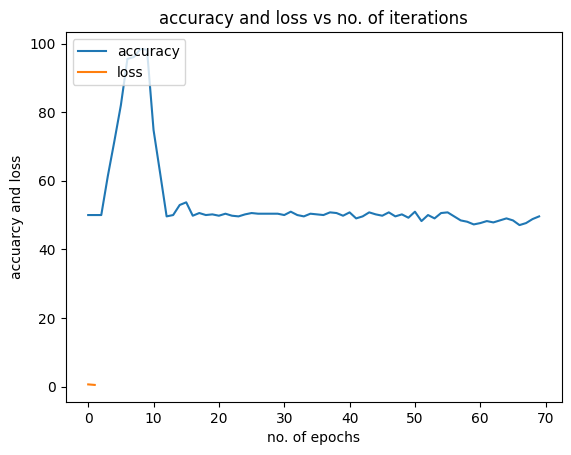

8/8 [==============================] - 0s 4ms/step


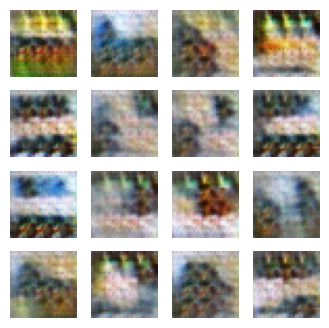

8/8 [==============================] - 0s 7ms/step
Iteration: 3501
8/8 [==============================] - 0s 3ms/step
Iteration: 3502
8/8 [==============================] - 0s 4ms/step
Iteration: 3503
8/8 [==============================] - 0s 3ms/step
Iteration: 3504
8/8 [==============================] - 0s 3ms/step
Iteration: 3505
8/8 [==============================] - 0s 3ms/step
Iteration: 3506
8/8 [==============================] - 0s 3ms/step
Iteration: 3507
8/8 [==============================] - 0s 3ms/step
Iteration: 3508
8/8 [==============================] - 0s 3ms/step
Iteration: 3509
8/8 [==============================] - 0s 4ms/step
Iteration: 3510
8/8 [==============================] - 0s 3ms/step
Iteration: 3511
8/8 [==============================] - 0s 4ms/step
Iteration: 3512
8/8 [==============================] - 0s 3ms/step
Iteration: 3513
8/8 [==============================] - 0s 4ms/step
Iteration: 3514
8/8 [==============================] - 0s 4ms/step
Iteration: 

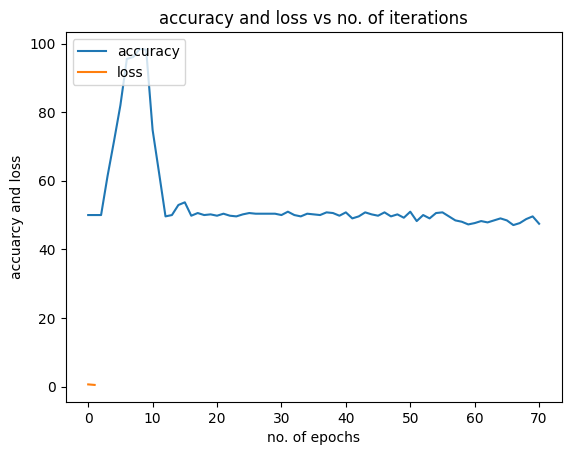

8/8 [==============================] - 0s 3ms/step


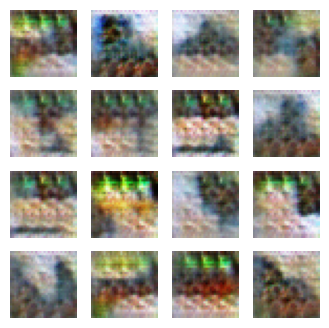

8/8 [==============================] - 0s 6ms/step
Iteration: 3551
8/8 [==============================] - 0s 4ms/step
Iteration: 3552
8/8 [==============================] - 0s 3ms/step
Iteration: 3553
8/8 [==============================] - 0s 3ms/step
Iteration: 3554
8/8 [==============================] - 0s 3ms/step
Iteration: 3555
8/8 [==============================] - 0s 3ms/step
Iteration: 3556
8/8 [==============================] - 0s 4ms/step
Iteration: 3557
8/8 [==============================] - 0s 4ms/step
Iteration: 3558
8/8 [==============================] - 0s 4ms/step
Iteration: 3559
8/8 [==============================] - 0s 5ms/step
Iteration: 3560
8/8 [==============================] - 0s 4ms/step
Iteration: 3561
8/8 [==============================] - 0s 5ms/step
Iteration: 3562
8/8 [==============================] - 0s 3ms/step
Iteration: 3563
8/8 [==============================] - 0s 5ms/step
Iteration: 3564
8/8 [==============================] - 0s 3ms/step
Iteration: 

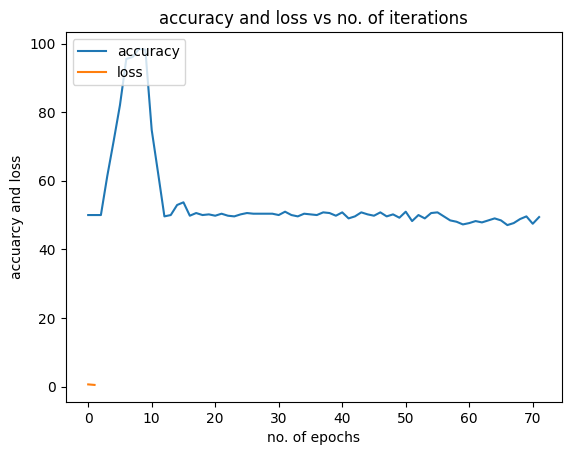

8/8 [==============================] - 0s 4ms/step


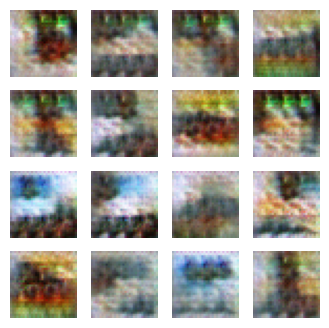

8/8 [==============================] - 0s 6ms/step
Iteration: 3601
8/8 [==============================] - 0s 4ms/step
Iteration: 3602
8/8 [==============================] - 0s 4ms/step
Iteration: 3603
8/8 [==============================] - 0s 3ms/step
Iteration: 3604
8/8 [==============================] - 0s 3ms/step
Iteration: 3605
8/8 [==============================] - 0s 3ms/step
Iteration: 3606
8/8 [==============================] - 0s 3ms/step
Iteration: 3607
8/8 [==============================] - 0s 3ms/step
Iteration: 3608
8/8 [==============================] - 0s 3ms/step
Iteration: 3609
8/8 [==============================] - 0s 4ms/step
Iteration: 3610
8/8 [==============================] - 0s 4ms/step
Iteration: 3611
8/8 [==============================] - 0s 4ms/step
Iteration: 3612
8/8 [==============================] - 0s 3ms/step
Iteration: 3613
8/8 [==============================] - 0s 3ms/step
Iteration: 3614
8/8 [==============================] - 0s 3ms/step
Iteration: 

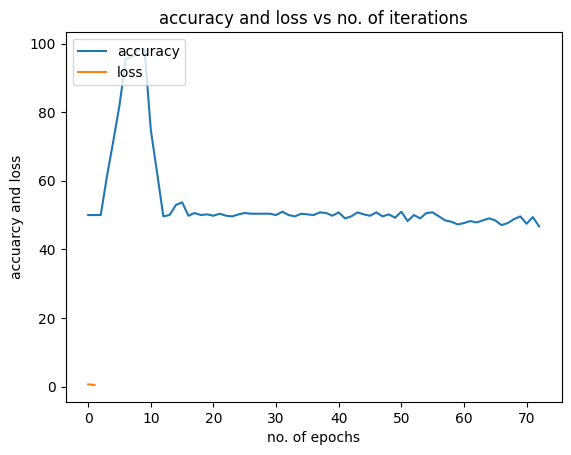

8/8 [==============================] - 0s 3ms/step


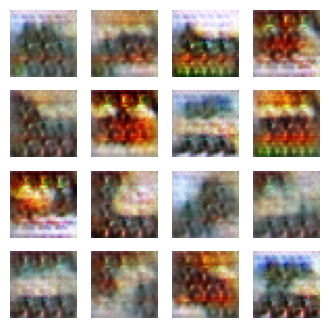

8/8 [==============================] - 0s 6ms/step
Iteration: 3651
8/8 [==============================] - 0s 4ms/step
Iteration: 3652
8/8 [==============================] - 0s 4ms/step
Iteration: 3653
8/8 [==============================] - 0s 4ms/step
Iteration: 3654
8/8 [==============================] - 0s 3ms/step
Iteration: 3655
8/8 [==============================] - 0s 3ms/step
Iteration: 3656
8/8 [==============================] - 0s 4ms/step
Iteration: 3657
8/8 [==============================] - 0s 4ms/step
Iteration: 3658
8/8 [==============================] - 0s 4ms/step
Iteration: 3659
8/8 [==============================] - 0s 4ms/step
Iteration: 3660
8/8 [==============================] - 0s 3ms/step
Iteration: 3661
8/8 [==============================] - 0s 4ms/step
Iteration: 3662
8/8 [==============================] - 0s 3ms/step
Iteration: 3663
8/8 [==============================] - 0s 4ms/step
Iteration: 3664
8/8 [==============================] - 0s 3ms/step
Iteration: 

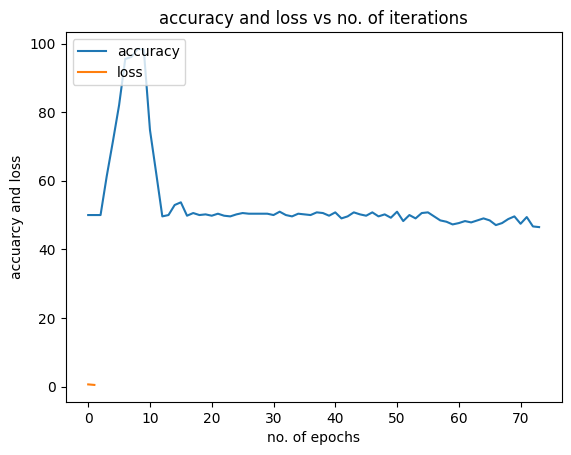

8/8 [==============================] - 0s 4ms/step


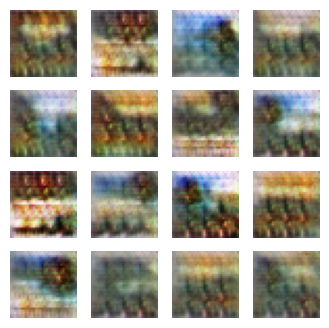

8/8 [==============================] - 0s 6ms/step
Iteration: 3701
8/8 [==============================] - 0s 4ms/step
Iteration: 3702
8/8 [==============================] - 0s 3ms/step
Iteration: 3703
8/8 [==============================] - 0s 4ms/step
Iteration: 3704
8/8 [==============================] - 0s 4ms/step
Iteration: 3705
8/8 [==============================] - 0s 3ms/step
Iteration: 3706
8/8 [==============================] - 0s 3ms/step
Iteration: 3707
8/8 [==============================] - 0s 3ms/step
Iteration: 3708
8/8 [==============================] - 0s 3ms/step
Iteration: 3709
8/8 [==============================] - 0s 3ms/step
Iteration: 3710
8/8 [==============================] - 0s 4ms/step
Iteration: 3711
8/8 [==============================] - 0s 4ms/step
Iteration: 3712
8/8 [==============================] - 0s 3ms/step
Iteration: 3713
8/8 [==============================] - 0s 3ms/step
Iteration: 3714
8/8 [==============================] - 0s 3ms/step
Iteration: 

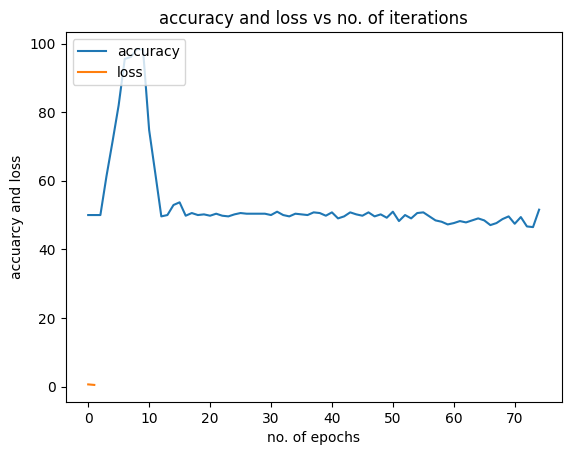

8/8 [==============================] - 0s 3ms/step


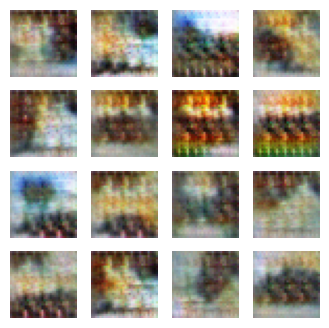

8/8 [==============================] - 0s 6ms/step
Iteration: 3751
8/8 [==============================] - 0s 5ms/step
Iteration: 3752
8/8 [==============================] - 0s 5ms/step
Iteration: 3753
8/8 [==============================] - 0s 4ms/step
Iteration: 3754
8/8 [==============================] - 0s 5ms/step
Iteration: 3755
8/8 [==============================] - 0s 4ms/step
Iteration: 3756
8/8 [==============================] - 0s 4ms/step
Iteration: 3757
8/8 [==============================] - 0s 4ms/step
Iteration: 3758
8/8 [==============================] - 0s 4ms/step
Iteration: 3759
8/8 [==============================] - 0s 3ms/step
Iteration: 3760
8/8 [==============================] - 0s 3ms/step
Iteration: 3761
8/8 [==============================] - 0s 3ms/step
Iteration: 3762
8/8 [==============================] - 0s 3ms/step
Iteration: 3763
8/8 [==============================] - 0s 3ms/step
Iteration: 3764
8/8 [==============================] - 0s 4ms/step
Iteration: 

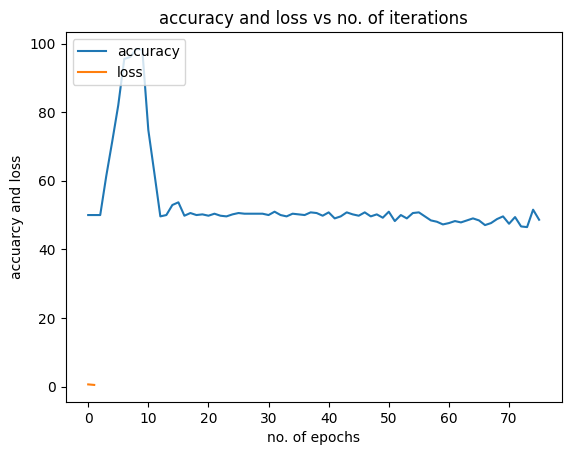

8/8 [==============================] - 0s 3ms/step


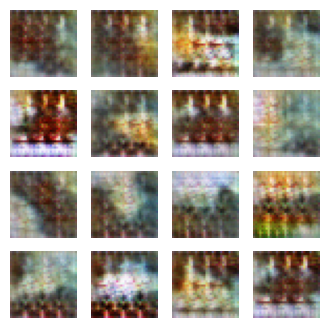

8/8 [==============================] - 0s 6ms/step
Iteration: 3801
8/8 [==============================] - 0s 4ms/step
Iteration: 3802
8/8 [==============================] - 0s 3ms/step
Iteration: 3803
8/8 [==============================] - 0s 3ms/step
Iteration: 3804
8/8 [==============================] - 0s 3ms/step
Iteration: 3805
8/8 [==============================] - 0s 3ms/step
Iteration: 3806
8/8 [==============================] - 0s 4ms/step
Iteration: 3807
8/8 [==============================] - 0s 3ms/step
Iteration: 3808
8/8 [==============================] - 0s 3ms/step
Iteration: 3809
8/8 [==============================] - 0s 3ms/step
Iteration: 3810
8/8 [==============================] - 0s 4ms/step
Iteration: 3811
8/8 [==============================] - 0s 5ms/step
Iteration: 3812
8/8 [==============================] - 0s 3ms/step
Iteration: 3813
8/8 [==============================] - 0s 4ms/step
Iteration: 3814
8/8 [==============================] - 0s 5ms/step
Iteration: 

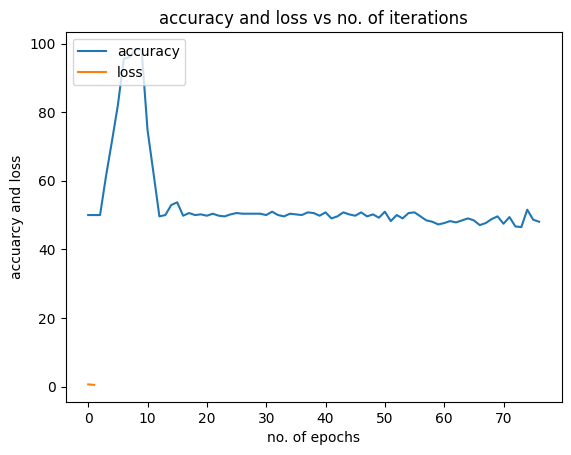

8/8 [==============================] - 0s 6ms/step


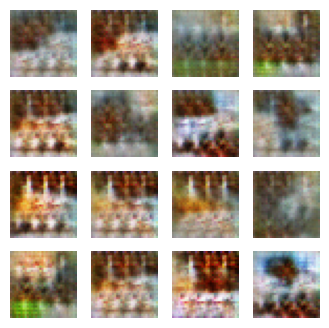

8/8 [==============================] - 0s 6ms/step
Iteration: 3851
8/8 [==============================] - 0s 5ms/step
Iteration: 3852
8/8 [==============================] - 0s 5ms/step
Iteration: 3853
8/8 [==============================] - 0s 3ms/step
Iteration: 3854
8/8 [==============================] - 0s 4ms/step
Iteration: 3855
8/8 [==============================] - 0s 3ms/step
Iteration: 3856
8/8 [==============================] - 0s 3ms/step
Iteration: 3857
8/8 [==============================] - 0s 3ms/step
Iteration: 3858
8/8 [==============================] - 0s 3ms/step
Iteration: 3859
8/8 [==============================] - 0s 3ms/step
Iteration: 3860
8/8 [==============================] - 0s 4ms/step
Iteration: 3861
8/8 [==============================] - 0s 4ms/step
Iteration: 3862
8/8 [==============================] - 0s 3ms/step
Iteration: 3863
8/8 [==============================] - 0s 3ms/step
Iteration: 3864
8/8 [==============================] - 0s 3ms/step
Iteration: 

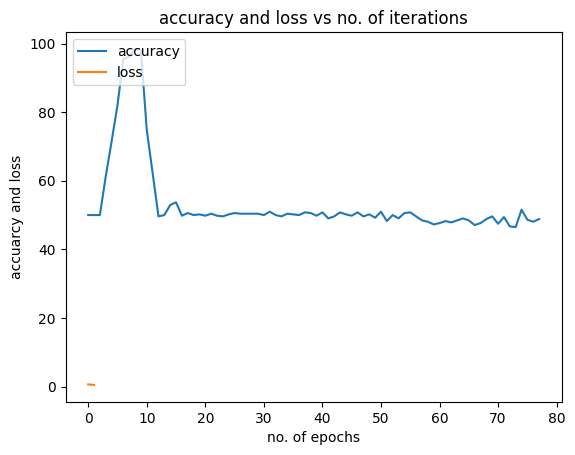

8/8 [==============================] - 0s 4ms/step


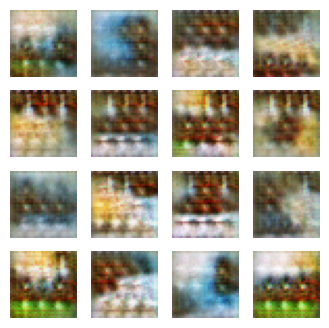

8/8 [==============================] - 0s 8ms/step
Iteration: 3901
8/8 [==============================] - 0s 4ms/step
Iteration: 3902
8/8 [==============================] - 0s 3ms/step
Iteration: 3903
8/8 [==============================] - 0s 3ms/step
Iteration: 3904
8/8 [==============================] - 0s 3ms/step
Iteration: 3905
8/8 [==============================] - 0s 3ms/step
Iteration: 3906
8/8 [==============================] - 0s 3ms/step
Iteration: 3907
8/8 [==============================] - 0s 3ms/step
Iteration: 3908
8/8 [==============================] - 0s 3ms/step
Iteration: 3909
8/8 [==============================] - 0s 3ms/step
Iteration: 3910
8/8 [==============================] - 0s 6ms/step
Iteration: 3911
8/8 [==============================] - 0s 3ms/step
Iteration: 3912
8/8 [==============================] - 0s 3ms/step
Iteration: 3913
8/8 [==============================] - 0s 4ms/step
Iteration: 3914
8/8 [==============================] - 0s 4ms/step
Iteration: 

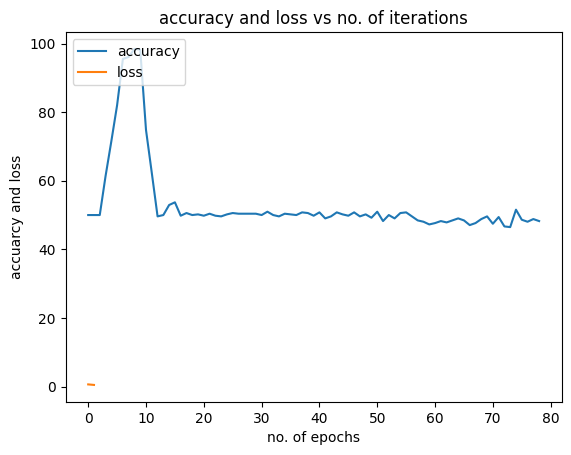

8/8 [==============================] - 0s 4ms/step


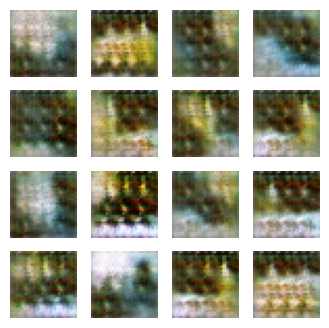

8/8 [==============================] - 0s 8ms/step
Iteration: 3951
8/8 [==============================] - 0s 4ms/step
Iteration: 3952
8/8 [==============================] - 0s 3ms/step
Iteration: 3953
8/8 [==============================] - 0s 3ms/step
Iteration: 3954
8/8 [==============================] - 0s 3ms/step
Iteration: 3955
8/8 [==============================] - 0s 3ms/step
Iteration: 3956
8/8 [==============================] - 0s 4ms/step
Iteration: 3957
8/8 [==============================] - 0s 4ms/step
Iteration: 3958
8/8 [==============================] - 0s 3ms/step
Iteration: 3959
8/8 [==============================] - 0s 4ms/step
Iteration: 3960
8/8 [==============================] - 0s 4ms/step
Iteration: 3961
8/8 [==============================] - 0s 3ms/step
Iteration: 3962
8/8 [==============================] - 0s 3ms/step
Iteration: 3963
8/8 [==============================] - 0s 3ms/step
Iteration: 3964
8/8 [==============================] - 0s 3ms/step
Iteration: 

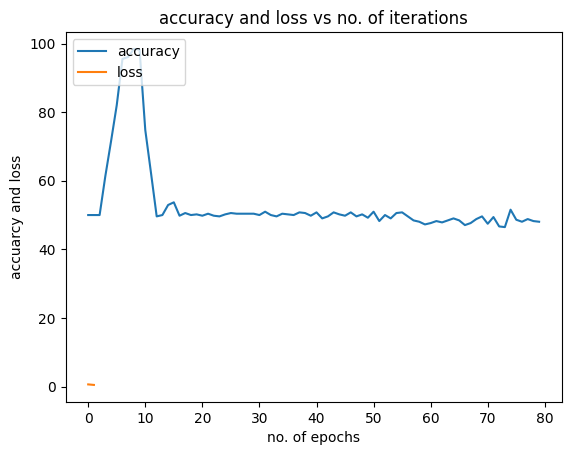

8/8 [==============================] - 0s 3ms/step


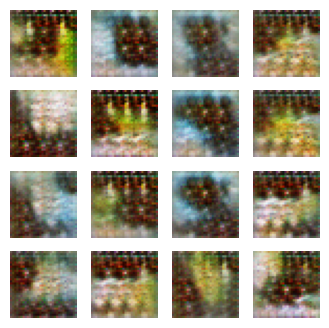

8/8 [==============================] - 0s 6ms/step
Iteration: 4001
8/8 [==============================] - 0s 4ms/step
Iteration: 4002
8/8 [==============================] - 0s 3ms/step
Iteration: 4003
8/8 [==============================] - 0s 4ms/step
Iteration: 4004
8/8 [==============================] - 0s 5ms/step
Iteration: 4005
8/8 [==============================] - 0s 5ms/step
Iteration: 4006
8/8 [==============================] - 0s 5ms/step
Iteration: 4007
8/8 [==============================] - 0s 4ms/step
Iteration: 4008
8/8 [==============================] - 0s 4ms/step
Iteration: 4009
8/8 [==============================] - 0s 5ms/step
Iteration: 4010
8/8 [==============================] - 0s 4ms/step
Iteration: 4011
8/8 [==============================] - 0s 4ms/step
Iteration: 4012
8/8 [==============================] - 0s 4ms/step
Iteration: 4013
8/8 [==============================] - 0s 3ms/step
Iteration: 4014
8/8 [==============================] - 0s 3ms/step
Iteration: 

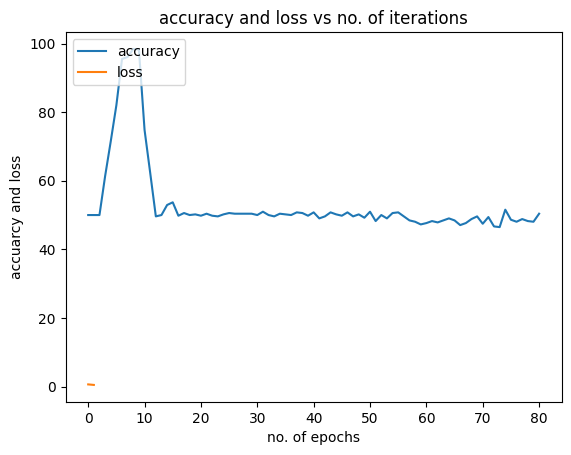

8/8 [==============================] - 0s 3ms/step


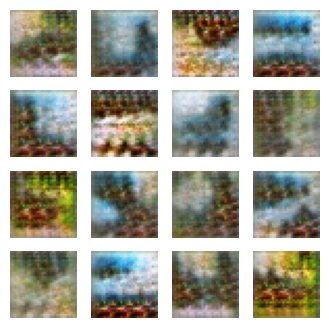

8/8 [==============================] - 0s 7ms/step
Iteration: 4051
8/8 [==============================] - 0s 4ms/step
Iteration: 4052
8/8 [==============================] - 0s 3ms/step
Iteration: 4053
8/8 [==============================] - 0s 3ms/step
Iteration: 4054
8/8 [==============================] - 0s 3ms/step
Iteration: 4055
8/8 [==============================] - 0s 5ms/step
Iteration: 4056
8/8 [==============================] - 0s 3ms/step
Iteration: 4057
8/8 [==============================] - 0s 3ms/step
Iteration: 4058
8/8 [==============================] - 0s 4ms/step
Iteration: 4059
8/8 [==============================] - 0s 3ms/step
Iteration: 4060
8/8 [==============================] - 0s 3ms/step
Iteration: 4061
8/8 [==============================] - 0s 3ms/step
Iteration: 4062
8/8 [==============================] - 0s 3ms/step
Iteration: 4063
8/8 [==============================] - 0s 3ms/step
Iteration: 4064
8/8 [==============================] - 0s 3ms/step
Iteration: 

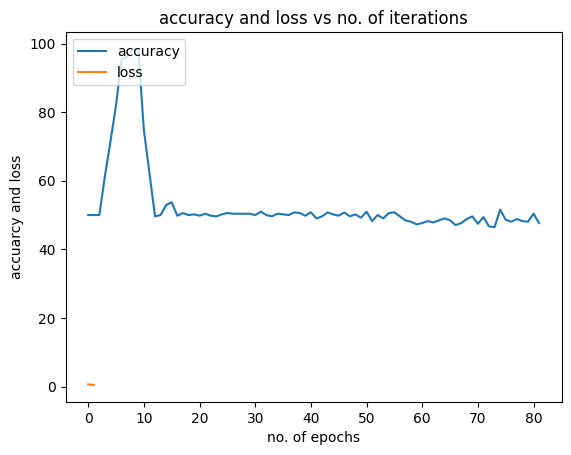

8/8 [==============================] - 0s 3ms/step


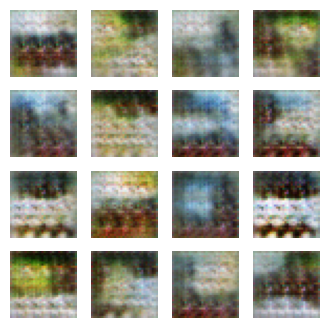

8/8 [==============================] - 0s 6ms/step
Iteration: 4101
8/8 [==============================] - 0s 4ms/step
Iteration: 4102
8/8 [==============================] - 0s 3ms/step
Iteration: 4103
8/8 [==============================] - 0s 5ms/step
Iteration: 4104
8/8 [==============================] - 0s 4ms/step
Iteration: 4105
8/8 [==============================] - 0s 5ms/step
Iteration: 4106
8/8 [==============================] - 0s 4ms/step
Iteration: 4107
8/8 [==============================] - 0s 4ms/step
Iteration: 4108
8/8 [==============================] - 0s 4ms/step
Iteration: 4109
8/8 [==============================] - 0s 5ms/step
Iteration: 4110
8/8 [==============================] - 0s 3ms/step
Iteration: 4111
8/8 [==============================] - 0s 4ms/step
Iteration: 4112
8/8 [==============================] - 0s 4ms/step
Iteration: 4113
8/8 [==============================] - 0s 3ms/step
Iteration: 4114
8/8 [==============================] - 0s 3ms/step
Iteration: 

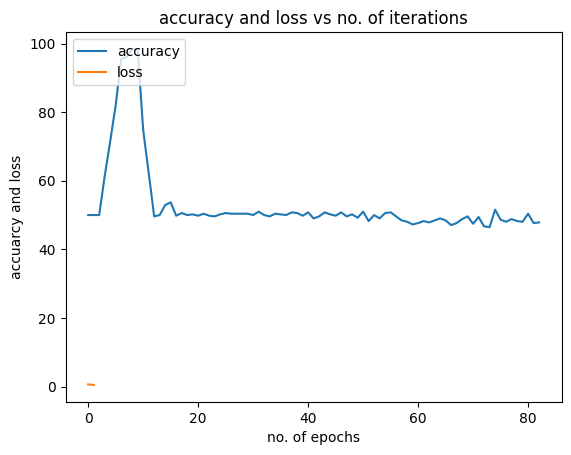

8/8 [==============================] - 0s 4ms/step


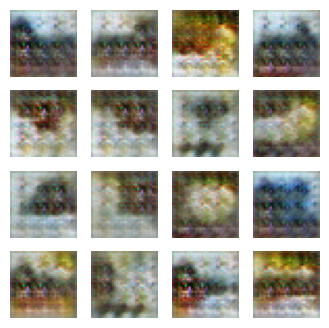

8/8 [==============================] - 0s 6ms/step
Iteration: 4151
8/8 [==============================] - 0s 4ms/step
Iteration: 4152
8/8 [==============================] - 0s 3ms/step
Iteration: 4153
8/8 [==============================] - 0s 4ms/step
Iteration: 4154
8/8 [==============================] - 0s 3ms/step
Iteration: 4155
8/8 [==============================] - 0s 4ms/step
Iteration: 4156
8/8 [==============================] - 0s 3ms/step
Iteration: 4157
8/8 [==============================] - 0s 3ms/step
Iteration: 4158
8/8 [==============================] - 0s 3ms/step
Iteration: 4159
8/8 [==============================] - 0s 3ms/step
Iteration: 4160
8/8 [==============================] - 0s 3ms/step
Iteration: 4161
8/8 [==============================] - 0s 4ms/step
Iteration: 4162
8/8 [==============================] - 0s 3ms/step
Iteration: 4163
8/8 [==============================] - 0s 3ms/step
Iteration: 4164
8/8 [==============================] - 0s 3ms/step
Iteration: 

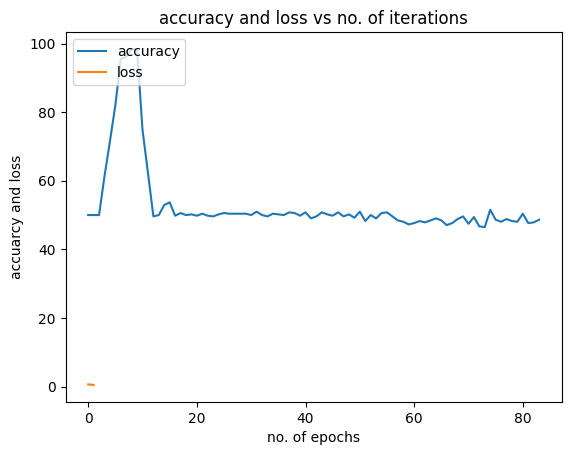

8/8 [==============================] - 0s 3ms/step


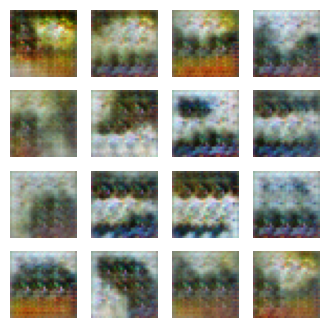

8/8 [==============================] - 0s 7ms/step
Iteration: 4201
8/8 [==============================] - 0s 4ms/step
Iteration: 4202
8/8 [==============================] - 0s 3ms/step
Iteration: 4203
8/8 [==============================] - 0s 4ms/step
Iteration: 4204
8/8 [==============================] - 0s 5ms/step
Iteration: 4205
8/8 [==============================] - 0s 4ms/step
Iteration: 4206
8/8 [==============================] - 0s 3ms/step
Iteration: 4207
8/8 [==============================] - 0s 6ms/step
Iteration: 4208
8/8 [==============================] - 0s 3ms/step
Iteration: 4209
8/8 [==============================] - 0s 3ms/step
Iteration: 4210
8/8 [==============================] - 0s 4ms/step
Iteration: 4211
8/8 [==============================] - 0s 3ms/step
Iteration: 4212
8/8 [==============================] - 0s 3ms/step
Iteration: 4213
8/8 [==============================] - 0s 3ms/step
Iteration: 4214
8/8 [==============================] - 0s 3ms/step
Iteration: 

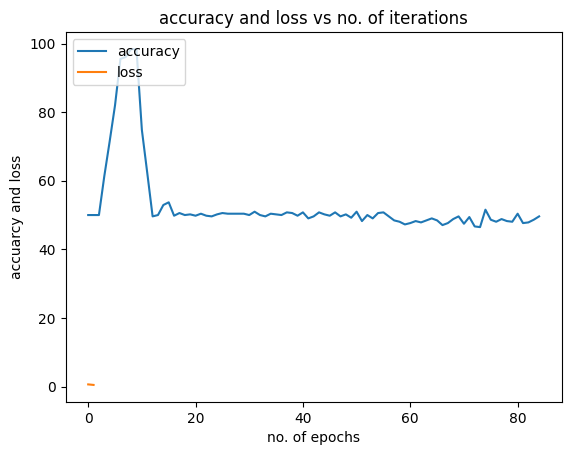

8/8 [==============================] - 0s 3ms/step


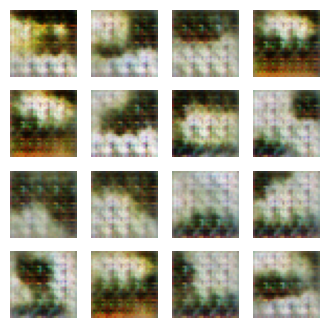

8/8 [==============================] - 0s 6ms/step
Iteration: 4251
8/8 [==============================] - 0s 5ms/step
Iteration: 4252
8/8 [==============================] - 0s 3ms/step
Iteration: 4253
8/8 [==============================] - 0s 3ms/step
Iteration: 4254
8/8 [==============================] - 0s 4ms/step
Iteration: 4255
8/8 [==============================] - 0s 3ms/step
Iteration: 4256
8/8 [==============================] - 0s 3ms/step
Iteration: 4257
8/8 [==============================] - 0s 4ms/step
Iteration: 4258
8/8 [==============================] - 0s 4ms/step
Iteration: 4259
8/8 [==============================] - 0s 3ms/step
Iteration: 4260
8/8 [==============================] - 0s 3ms/step
Iteration: 4261
8/8 [==============================] - 0s 3ms/step
Iteration: 4262
8/8 [==============================] - 0s 4ms/step
Iteration: 4263
8/8 [==============================] - 0s 4ms/step
Iteration: 4264
8/8 [==============================] - 0s 3ms/step
Iteration: 

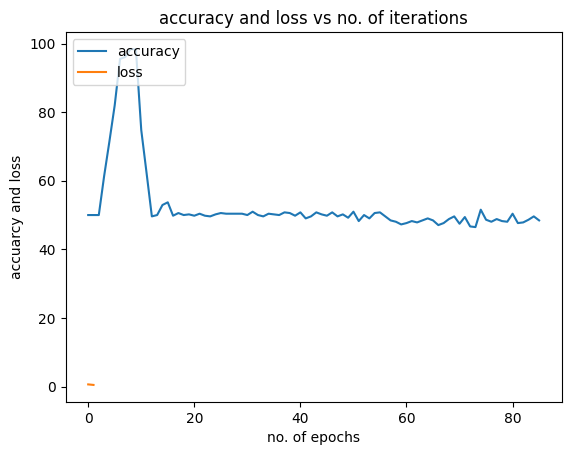

8/8 [==============================] - 0s 4ms/step


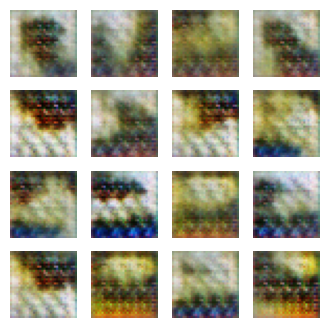

8/8 [==============================] - 0s 6ms/step
Iteration: 4301
8/8 [==============================] - 0s 3ms/step
Iteration: 4302
8/8 [==============================] - 0s 4ms/step
Iteration: 4303
8/8 [==============================] - 0s 4ms/step
Iteration: 4304
8/8 [==============================] - 0s 5ms/step
Iteration: 4305
8/8 [==============================] - 0s 5ms/step
Iteration: 4306
8/8 [==============================] - 0s 4ms/step
Iteration: 4307
8/8 [==============================] - 0s 5ms/step
Iteration: 4308
8/8 [==============================] - 0s 5ms/step
Iteration: 4309
8/8 [==============================] - 0s 3ms/step
Iteration: 4310
8/8 [==============================] - 0s 3ms/step
Iteration: 4311
8/8 [==============================] - 0s 3ms/step
Iteration: 4312
8/8 [==============================] - 0s 4ms/step
Iteration: 4313
8/8 [==============================] - 0s 4ms/step
Iteration: 4314
8/8 [==============================] - 0s 3ms/step
Iteration: 

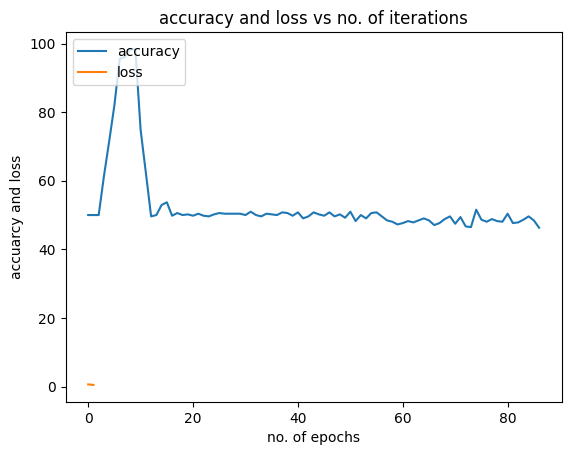

8/8 [==============================] - 0s 3ms/step


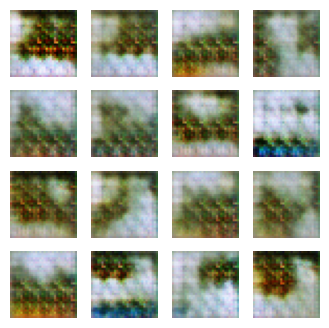

8/8 [==============================] - 0s 6ms/step
Iteration: 4351
8/8 [==============================] - 0s 4ms/step
Iteration: 4352
8/8 [==============================] - 0s 3ms/step
Iteration: 4353
8/8 [==============================] - 0s 3ms/step
Iteration: 4354
8/8 [==============================] - 0s 3ms/step
Iteration: 4355
8/8 [==============================] - 0s 3ms/step
Iteration: 4356
8/8 [==============================] - 0s 4ms/step
Iteration: 4357
8/8 [==============================] - 0s 4ms/step
Iteration: 4358
8/8 [==============================] - 0s 3ms/step
Iteration: 4359
8/8 [==============================] - 0s 3ms/step
Iteration: 4360
8/8 [==============================] - 0s 3ms/step
Iteration: 4361
8/8 [==============================] - 0s 4ms/step
Iteration: 4362
8/8 [==============================] - 0s 3ms/step
Iteration: 4363
8/8 [==============================] - 0s 4ms/step
Iteration: 4364
8/8 [==============================] - 0s 3ms/step
Iteration: 

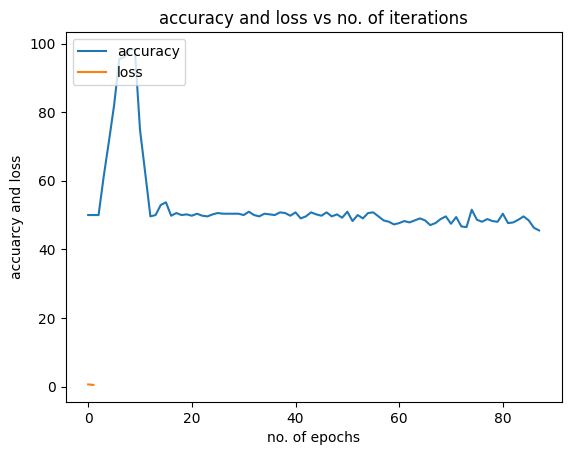

8/8 [==============================] - 0s 3ms/step


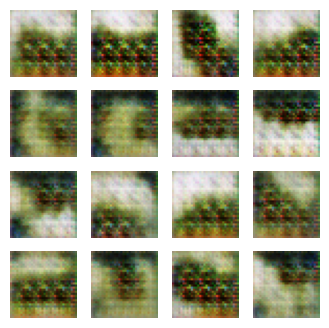

8/8 [==============================] - 0s 6ms/step
Iteration: 4401
8/8 [==============================] - 0s 4ms/step
Iteration: 4402
8/8 [==============================] - 0s 4ms/step
Iteration: 4403
8/8 [==============================] - 0s 4ms/step
Iteration: 4404
8/8 [==============================] - 0s 6ms/step
Iteration: 4405
8/8 [==============================] - 0s 5ms/step
Iteration: 4406
8/8 [==============================] - 0s 3ms/step
Iteration: 4407
8/8 [==============================] - 0s 3ms/step
Iteration: 4408
8/8 [==============================] - 0s 3ms/step
Iteration: 4409
8/8 [==============================] - 0s 3ms/step
Iteration: 4410
8/8 [==============================] - 0s 3ms/step
Iteration: 4411
8/8 [==============================] - 0s 3ms/step
Iteration: 4412
8/8 [==============================] - 0s 4ms/step
Iteration: 4413
8/8 [==============================] - 0s 3ms/step
Iteration: 4414
8/8 [==============================] - 0s 3ms/step
Iteration: 

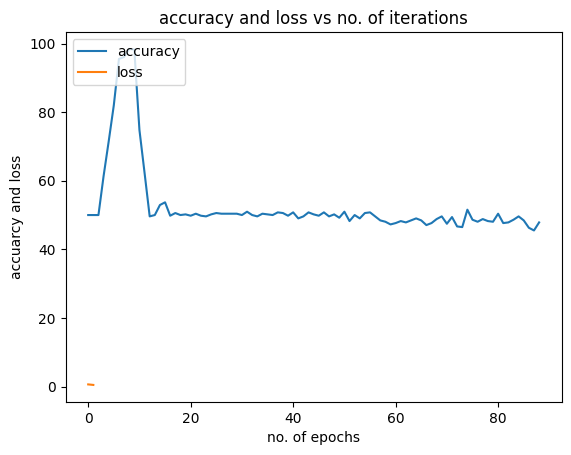

8/8 [==============================] - 0s 3ms/step


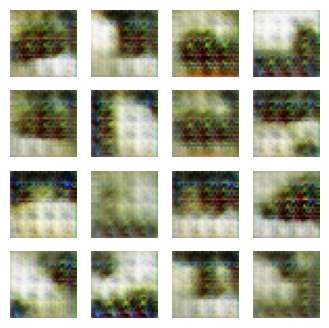

8/8 [==============================] - 0s 6ms/step
Iteration: 4451
8/8 [==============================] - 0s 4ms/step
Iteration: 4452
8/8 [==============================] - 0s 4ms/step
Iteration: 4453
8/8 [==============================] - 0s 3ms/step
Iteration: 4454
8/8 [==============================] - 0s 3ms/step
Iteration: 4455
8/8 [==============================] - 0s 4ms/step
Iteration: 4456
8/8 [==============================] - 0s 3ms/step
Iteration: 4457
8/8 [==============================] - 0s 4ms/step
Iteration: 4458
8/8 [==============================] - 0s 4ms/step
Iteration: 4459
8/8 [==============================] - 0s 3ms/step
Iteration: 4460
8/8 [==============================] - 0s 3ms/step
Iteration: 4461
8/8 [==============================] - 0s 3ms/step
Iteration: 4462
8/8 [==============================] - 0s 3ms/step
Iteration: 4463
8/8 [==============================] - 0s 3ms/step
Iteration: 4464
8/8 [==============================] - 0s 3ms/step
Iteration: 

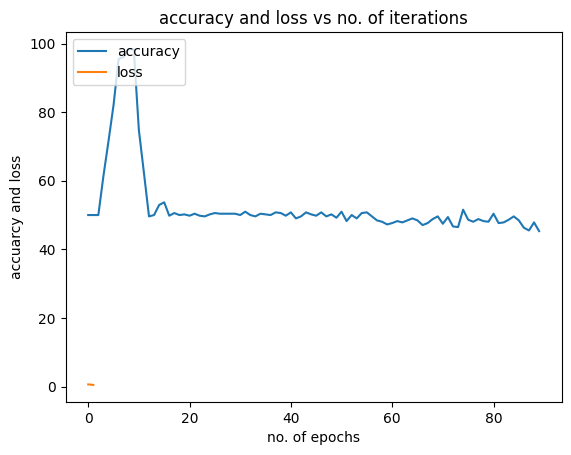

8/8 [==============================] - 0s 4ms/step


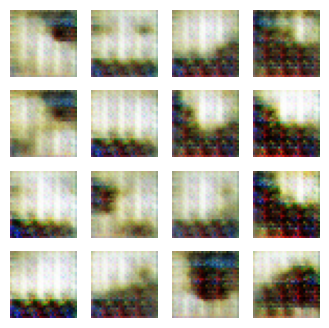

8/8 [==============================] - 0s 6ms/step
Iteration: 4501
8/8 [==============================] - 0s 5ms/step
Iteration: 4502
8/8 [==============================] - 0s 4ms/step
Iteration: 4503
8/8 [==============================] - 0s 5ms/step
Iteration: 4504
8/8 [==============================] - 0s 3ms/step
Iteration: 4505
8/8 [==============================] - 0s 3ms/step
Iteration: 4506
8/8 [==============================] - 0s 3ms/step
Iteration: 4507
8/8 [==============================] - 0s 3ms/step
Iteration: 4508
8/8 [==============================] - 0s 3ms/step
Iteration: 4509
8/8 [==============================] - 0s 5ms/step
Iteration: 4510
8/8 [==============================] - 0s 3ms/step
Iteration: 4511
8/8 [==============================] - 0s 4ms/step
Iteration: 4512
8/8 [==============================] - 0s 3ms/step
Iteration: 4513
8/8 [==============================] - 0s 3ms/step
Iteration: 4514
8/8 [==============================] - 0s 3ms/step
Iteration: 

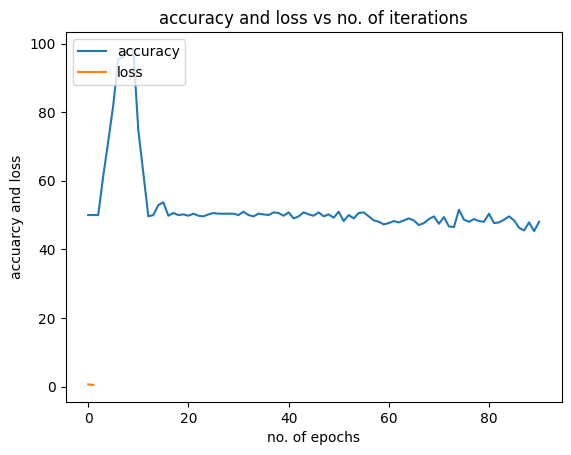

8/8 [==============================] - 0s 3ms/step


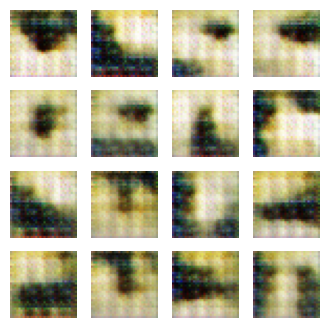

8/8 [==============================] - 0s 7ms/step
Iteration: 4551
8/8 [==============================] - 0s 4ms/step
Iteration: 4552
8/8 [==============================] - 0s 3ms/step
Iteration: 4553
8/8 [==============================] - 0s 3ms/step
Iteration: 4554
8/8 [==============================] - 0s 3ms/step
Iteration: 4555
8/8 [==============================] - 0s 4ms/step
Iteration: 4556
8/8 [==============================] - 0s 3ms/step
Iteration: 4557
8/8 [==============================] - 0s 3ms/step
Iteration: 4558
8/8 [==============================] - 0s 4ms/step
Iteration: 4559
8/8 [==============================] - 0s 3ms/step
Iteration: 4560
8/8 [==============================] - 0s 3ms/step
Iteration: 4561
8/8 [==============================] - 0s 3ms/step
Iteration: 4562
8/8 [==============================] - 0s 3ms/step
Iteration: 4563
8/8 [==============================] - 0s 3ms/step
Iteration: 4564
8/8 [==============================] - 0s 5ms/step
Iteration: 

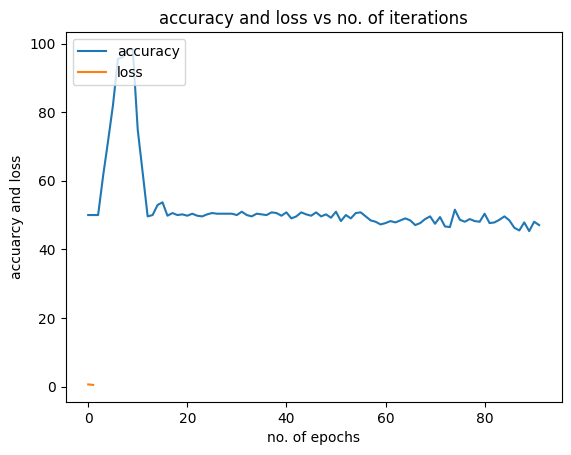

8/8 [==============================] - 0s 5ms/step


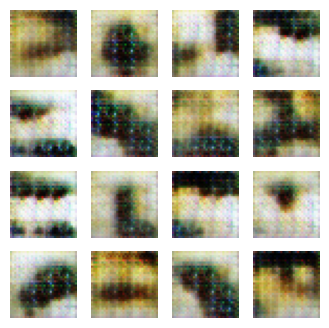

8/8 [==============================] - 0s 6ms/step
Iteration: 4601
8/8 [==============================] - 0s 4ms/step
Iteration: 4602
8/8 [==============================] - 0s 4ms/step
Iteration: 4603
8/8 [==============================] - 0s 4ms/step
Iteration: 4604
8/8 [==============================] - 0s 3ms/step
Iteration: 4605
8/8 [==============================] - 0s 3ms/step
Iteration: 4606
8/8 [==============================] - 0s 3ms/step
Iteration: 4607
8/8 [==============================] - 0s 3ms/step
Iteration: 4608
8/8 [==============================] - 0s 4ms/step
Iteration: 4609
8/8 [==============================] - 0s 3ms/step
Iteration: 4610
8/8 [==============================] - 0s 4ms/step
Iteration: 4611
8/8 [==============================] - 0s 4ms/step
Iteration: 4612
8/8 [==============================] - 0s 4ms/step
Iteration: 4613
8/8 [==============================] - 0s 4ms/step
Iteration: 4614
8/8 [==============================] - 0s 4ms/step
Iteration: 

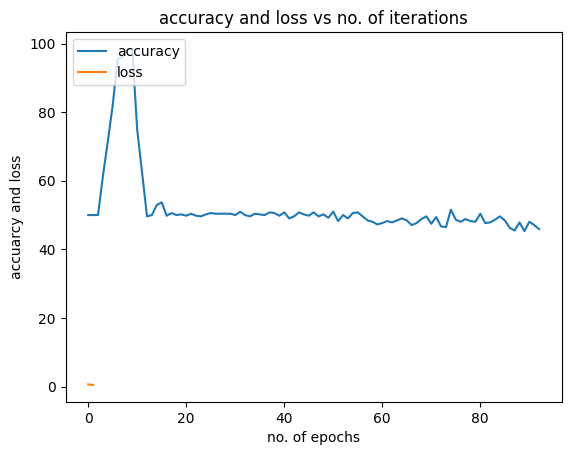

8/8 [==============================] - 0s 5ms/step


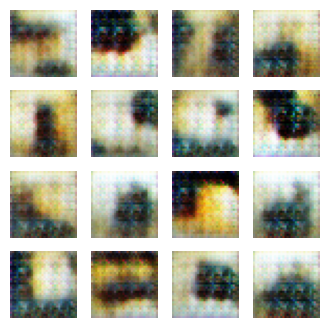

8/8 [==============================] - 0s 6ms/step
Iteration: 4651
8/8 [==============================] - 0s 3ms/step
Iteration: 4652
8/8 [==============================] - 0s 4ms/step
Iteration: 4653
8/8 [==============================] - 0s 3ms/step
Iteration: 4654
8/8 [==============================] - 0s 3ms/step
Iteration: 4655
8/8 [==============================] - 0s 4ms/step
Iteration: 4656
8/8 [==============================] - 0s 4ms/step
Iteration: 4657
8/8 [==============================] - 0s 4ms/step
Iteration: 4658
8/8 [==============================] - 0s 3ms/step
Iteration: 4659
8/8 [==============================] - 0s 4ms/step
Iteration: 4660
8/8 [==============================] - 0s 3ms/step
Iteration: 4661
8/8 [==============================] - 0s 4ms/step
Iteration: 4662
8/8 [==============================] - 0s 4ms/step
Iteration: 4663
8/8 [==============================] - 0s 4ms/step
Iteration: 4664
8/8 [==============================] - 0s 3ms/step
Iteration: 

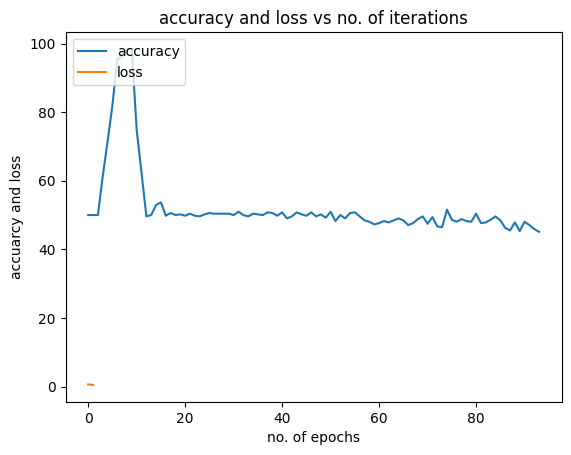

8/8 [==============================] - 0s 4ms/step


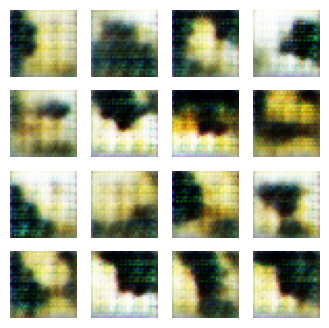

8/8 [==============================] - 0s 7ms/step
Iteration: 4701
8/8 [==============================] - 0s 4ms/step
Iteration: 4702
8/8 [==============================] - 0s 5ms/step
Iteration: 4703
8/8 [==============================] - 0s 3ms/step
Iteration: 4704
8/8 [==============================] - 0s 3ms/step
Iteration: 4705
8/8 [==============================] - 0s 3ms/step
Iteration: 4706
8/8 [==============================] - 0s 3ms/step
Iteration: 4707
8/8 [==============================] - 0s 3ms/step
Iteration: 4708
8/8 [==============================] - 0s 3ms/step
Iteration: 4709
8/8 [==============================] - 0s 3ms/step
Iteration: 4710
8/8 [==============================] - 0s 4ms/step
Iteration: 4711
8/8 [==============================] - 0s 3ms/step
Iteration: 4712
8/8 [==============================] - 0s 3ms/step
Iteration: 4713
8/8 [==============================] - 0s 3ms/step
Iteration: 4714
8/8 [==============================] - 0s 3ms/step
Iteration: 

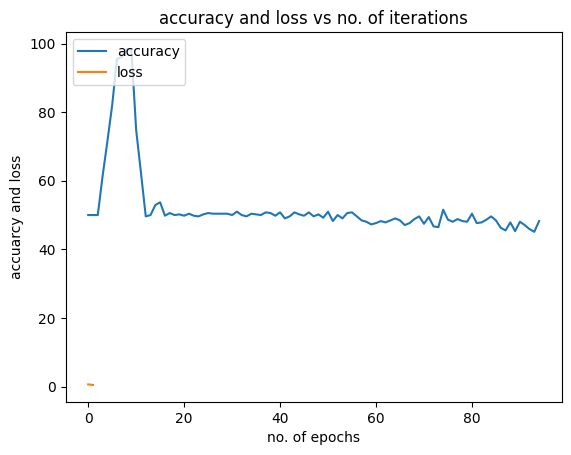

8/8 [==============================] - 0s 3ms/step


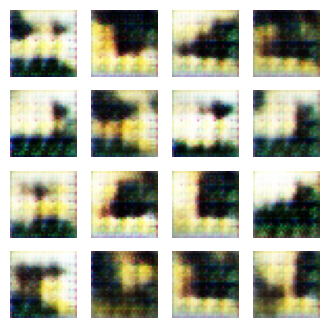

8/8 [==============================] - 0s 6ms/step
Iteration: 4751
8/8 [==============================] - 0s 5ms/step
Iteration: 4752
8/8 [==============================] - 0s 3ms/step
Iteration: 4753
8/8 [==============================] - 0s 3ms/step
Iteration: 4754
8/8 [==============================] - 0s 4ms/step
Iteration: 4755
8/8 [==============================] - 0s 4ms/step
Iteration: 4756
8/8 [==============================] - 0s 4ms/step
Iteration: 4757
8/8 [==============================] - 0s 3ms/step
Iteration: 4758
8/8 [==============================] - 0s 5ms/step
Iteration: 4759
8/8 [==============================] - 0s 4ms/step
Iteration: 4760
8/8 [==============================] - 0s 6ms/step
Iteration: 4761
8/8 [==============================] - 0s 3ms/step
Iteration: 4762
8/8 [==============================] - 0s 5ms/step
Iteration: 4763
8/8 [==============================] - 0s 4ms/step
Iteration: 4764
8/8 [==============================] - 0s 3ms/step
Iteration: 

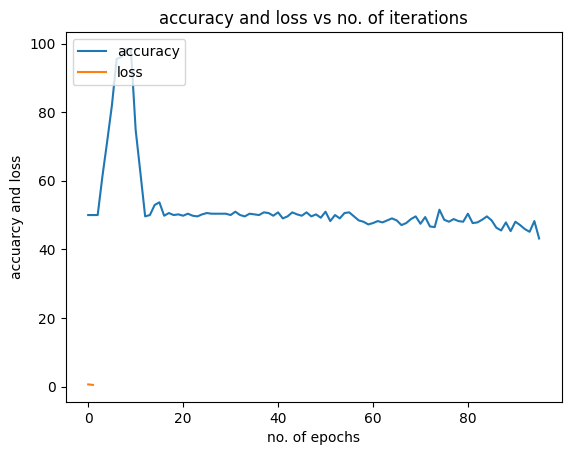

8/8 [==============================] - 0s 5ms/step


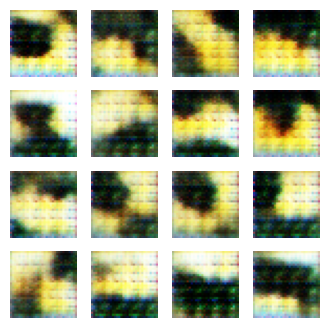

8/8 [==============================] - 0s 6ms/step
Iteration: 4801
8/8 [==============================] - 0s 4ms/step
Iteration: 4802
8/8 [==============================] - 0s 4ms/step
Iteration: 4803
8/8 [==============================] - 0s 3ms/step
Iteration: 4804
8/8 [==============================] - 0s 3ms/step
Iteration: 4805
8/8 [==============================] - 0s 3ms/step
Iteration: 4806
8/8 [==============================] - 0s 3ms/step
Iteration: 4807
8/8 [==============================] - 0s 4ms/step
Iteration: 4808
8/8 [==============================] - 0s 3ms/step
Iteration: 4809
8/8 [==============================] - 0s 3ms/step
Iteration: 4810
8/8 [==============================] - 0s 3ms/step
Iteration: 4811
8/8 [==============================] - 0s 3ms/step
Iteration: 4812
8/8 [==============================] - 0s 4ms/step
Iteration: 4813
8/8 [==============================] - 0s 3ms/step
Iteration: 4814
8/8 [==============================] - 0s 3ms/step
Iteration: 

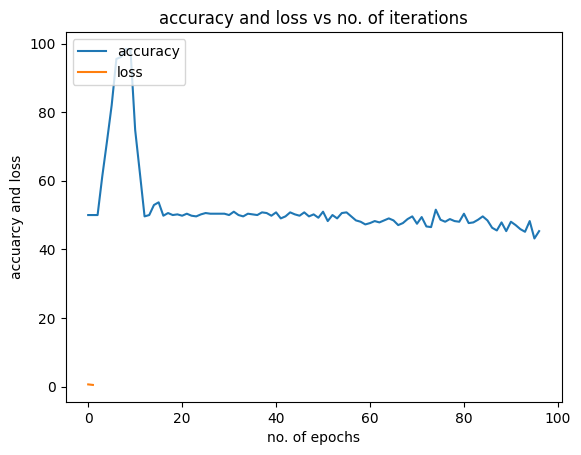

8/8 [==============================] - 0s 3ms/step


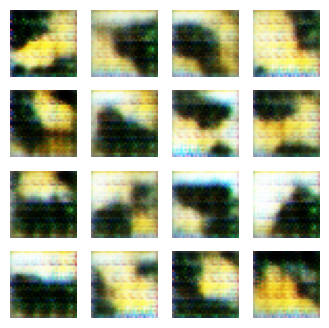

8/8 [==============================] - 0s 6ms/step
Iteration: 4851
8/8 [==============================] - 0s 4ms/step
Iteration: 4852
8/8 [==============================] - 0s 3ms/step
Iteration: 4853
8/8 [==============================] - 0s 3ms/step
Iteration: 4854
8/8 [==============================] - 0s 4ms/step
Iteration: 4855
8/8 [==============================] - 0s 5ms/step
Iteration: 4856
8/8 [==============================] - 0s 5ms/step
Iteration: 4857
8/8 [==============================] - 0s 3ms/step
Iteration: 4858
8/8 [==============================] - 0s 5ms/step
Iteration: 4859
8/8 [==============================] - 0s 5ms/step
Iteration: 4860
8/8 [==============================] - 0s 4ms/step
Iteration: 4861
8/8 [==============================] - 0s 4ms/step
Iteration: 4862
8/8 [==============================] - 0s 4ms/step
Iteration: 4863
8/8 [==============================] - 0s 3ms/step
Iteration: 4864
8/8 [==============================] - 0s 3ms/step
Iteration: 

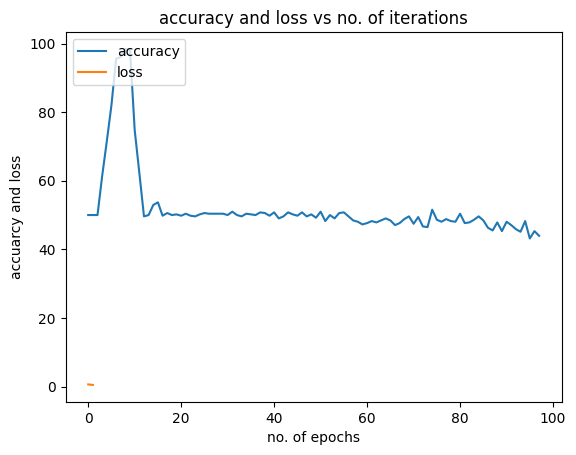

8/8 [==============================] - 0s 4ms/step


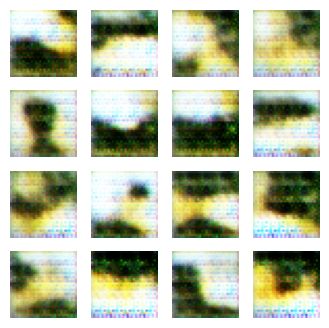

8/8 [==============================] - 0s 6ms/step
Iteration: 4901
8/8 [==============================] - 0s 4ms/step
Iteration: 4902
8/8 [==============================] - 0s 4ms/step
Iteration: 4903
8/8 [==============================] - 0s 4ms/step
Iteration: 4904
8/8 [==============================] - 0s 4ms/step
Iteration: 4905
8/8 [==============================] - 0s 4ms/step
Iteration: 4906
8/8 [==============================] - 0s 3ms/step
Iteration: 4907
8/8 [==============================] - 0s 3ms/step
Iteration: 4908
8/8 [==============================] - 0s 3ms/step
Iteration: 4909
8/8 [==============================] - 0s 3ms/step
Iteration: 4910
8/8 [==============================] - 0s 3ms/step
Iteration: 4911
8/8 [==============================] - 0s 4ms/step
Iteration: 4912
8/8 [==============================] - 0s 3ms/step
Iteration: 4913
8/8 [==============================] - 0s 3ms/step
Iteration: 4914
8/8 [==============================] - 0s 4ms/step
Iteration: 

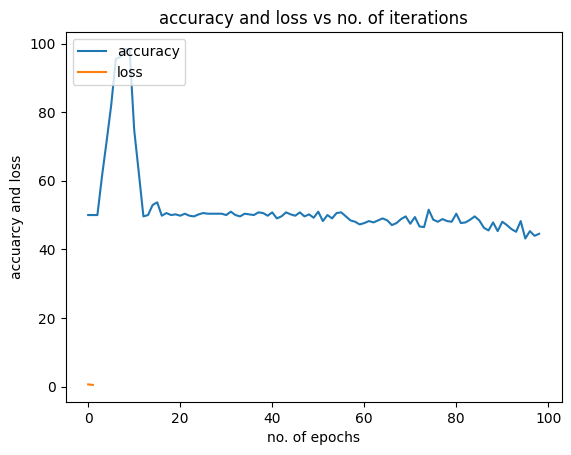

8/8 [==============================] - 0s 3ms/step


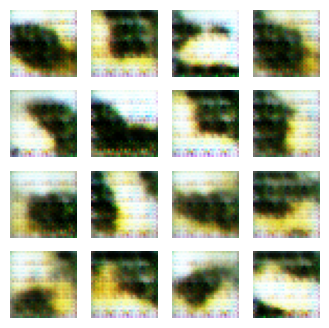

8/8 [==============================] - 0s 6ms/step
Iteration: 4951
8/8 [==============================] - 0s 3ms/step
Iteration: 4952
8/8 [==============================] - 0s 3ms/step
Iteration: 4953
8/8 [==============================] - 0s 5ms/step
Iteration: 4954
8/8 [==============================] - 0s 4ms/step
Iteration: 4955
8/8 [==============================] - 0s 4ms/step
Iteration: 4956
8/8 [==============================] - 0s 3ms/step
Iteration: 4957
8/8 [==============================] - 0s 3ms/step
Iteration: 4958
8/8 [==============================] - 0s 4ms/step
Iteration: 4959
8/8 [==============================] - 0s 3ms/step
Iteration: 4960
8/8 [==============================] - 0s 4ms/step
Iteration: 4961
8/8 [==============================] - 0s 3ms/step
Iteration: 4962
8/8 [==============================] - 0s 3ms/step
Iteration: 4963
8/8 [==============================] - 0s 3ms/step
Iteration: 4964
8/8 [==============================] - 0s 4ms/step
Iteration: 

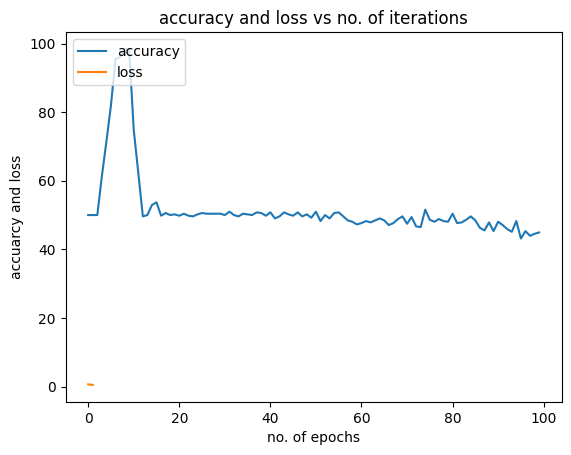

8/8 [==============================] - 0s 3ms/step


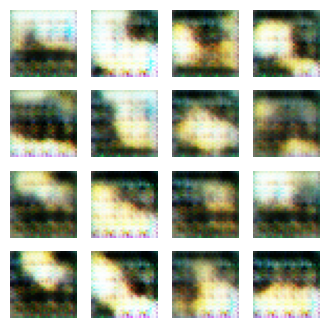

8/8 [==============================] - 0s 6ms/step
Iteration: 5001
8/8 [==============================] - 0s 4ms/step
Iteration: 5002
8/8 [==============================] - 0s 4ms/step
Iteration: 5003
8/8 [==============================] - 0s 4ms/step
Iteration: 5004
8/8 [==============================] - 0s 3ms/step
Iteration: 5005
8/8 [==============================] - 0s 3ms/step
Iteration: 5006
8/8 [==============================] - 0s 3ms/step
Iteration: 5007
8/8 [==============================] - 0s 4ms/step
Iteration: 5008
8/8 [==============================] - 0s 3ms/step
Iteration: 5009
8/8 [==============================] - 0s 3ms/step
Iteration: 5010
8/8 [==============================] - 0s 3ms/step
Iteration: 5011
8/8 [==============================] - 0s 4ms/step
Iteration: 5012
8/8 [==============================] - 0s 3ms/step
Iteration: 5013
8/8 [==============================] - 0s 4ms/step
Iteration: 5014
8/8 [==============================] - 0s 3ms/step
Iteration: 

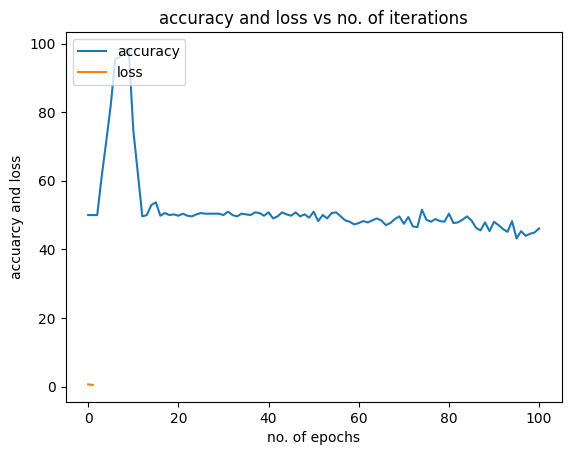

8/8 [==============================] - 0s 3ms/step


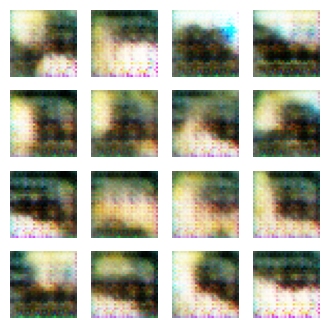

8/8 [==============================] - 0s 6ms/step
Iteration: 5051
8/8 [==============================] - 0s 3ms/step
Iteration: 5052
8/8 [==============================] - 0s 3ms/step
Iteration: 5053
8/8 [==============================] - 0s 4ms/step
Iteration: 5054
8/8 [==============================] - 0s 4ms/step
Iteration: 5055
8/8 [==============================] - 0s 4ms/step
Iteration: 5056
8/8 [==============================] - 0s 4ms/step
Iteration: 5057
8/8 [==============================] - 0s 3ms/step
Iteration: 5058
8/8 [==============================] - 0s 3ms/step
Iteration: 5059
8/8 [==============================] - 0s 4ms/step
Iteration: 5060
8/8 [==============================] - 0s 3ms/step
Iteration: 5061
8/8 [==============================] - 0s 3ms/step
Iteration: 5062
8/8 [==============================] - 0s 3ms/step
Iteration: 5063
8/8 [==============================] - 0s 3ms/step
Iteration: 5064
8/8 [==============================] - 0s 3ms/step
Iteration: 

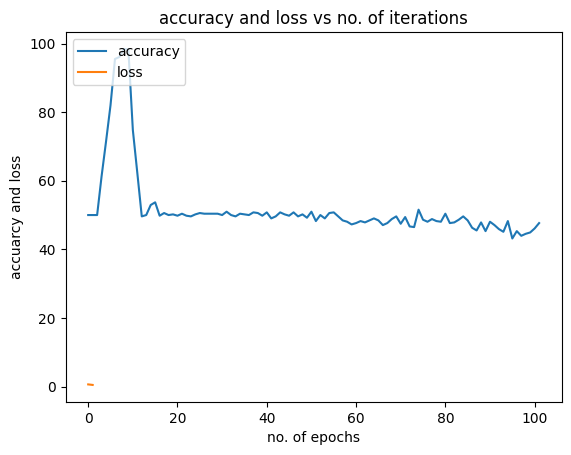

8/8 [==============================] - 0s 3ms/step


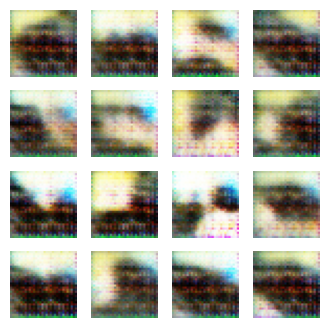

8/8 [==============================] - 0s 6ms/step
Iteration: 5101
8/8 [==============================] - 0s 4ms/step
Iteration: 5102
8/8 [==============================] - 0s 3ms/step
Iteration: 5103
8/8 [==============================] - 0s 5ms/step
Iteration: 5104
8/8 [==============================] - 0s 3ms/step
Iteration: 5105
8/8 [==============================] - 0s 3ms/step
Iteration: 5106
8/8 [==============================] - 0s 3ms/step
Iteration: 5107
8/8 [==============================] - 0s 4ms/step
Iteration: 5108
8/8 [==============================] - 0s 5ms/step
Iteration: 5109
8/8 [==============================] - 0s 3ms/step
Iteration: 5110
8/8 [==============================] - 0s 4ms/step
Iteration: 5111
8/8 [==============================] - 0s 3ms/step
Iteration: 5112
8/8 [==============================] - 0s 4ms/step
Iteration: 5113
8/8 [==============================] - 0s 3ms/step
Iteration: 5114
8/8 [==============================] - 0s 3ms/step
Iteration: 

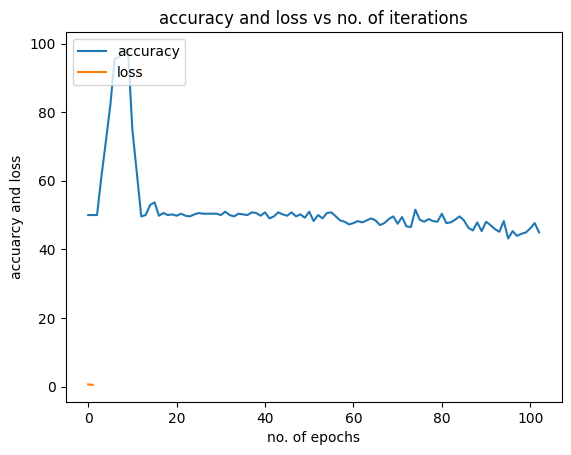

8/8 [==============================] - 0s 4ms/step


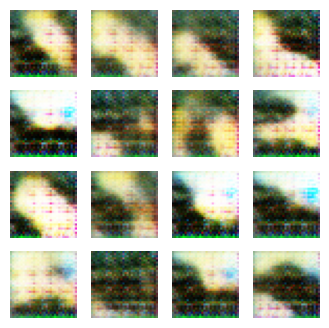

8/8 [==============================] - 0s 6ms/step
Iteration: 5151
8/8 [==============================] - 0s 5ms/step
Iteration: 5152
8/8 [==============================] - 0s 3ms/step
Iteration: 5153
8/8 [==============================] - 0s 3ms/step
Iteration: 5154
8/8 [==============================] - 0s 3ms/step
Iteration: 5155
8/8 [==============================] - 0s 4ms/step
Iteration: 5156
8/8 [==============================] - 0s 4ms/step
Iteration: 5157
8/8 [==============================] - 0s 4ms/step
Iteration: 5158
8/8 [==============================] - 0s 4ms/step
Iteration: 5159
8/8 [==============================] - 0s 3ms/step
Iteration: 5160
8/8 [==============================] - 0s 3ms/step
Iteration: 5161
8/8 [==============================] - 0s 3ms/step
Iteration: 5162
8/8 [==============================] - 0s 3ms/step
Iteration: 5163
8/8 [==============================] - 0s 3ms/step
Iteration: 5164
8/8 [==============================] - 0s 3ms/step
Iteration: 

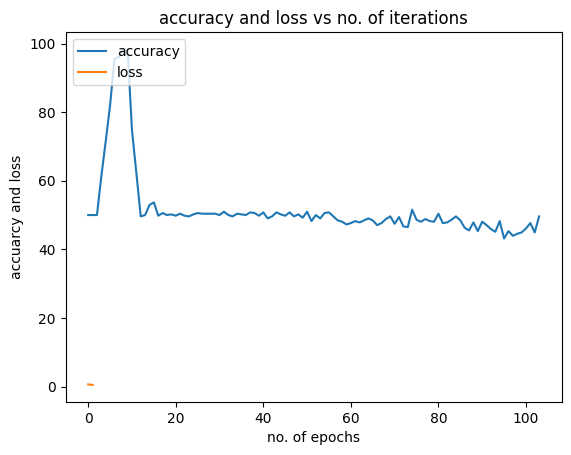

8/8 [==============================] - 0s 3ms/step


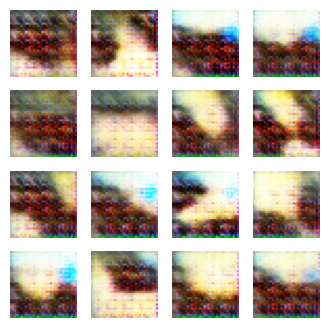

8/8 [==============================] - 0s 6ms/step
Iteration: 5201
8/8 [==============================] - 0s 4ms/step
Iteration: 5202
8/8 [==============================] - 0s 3ms/step
Iteration: 5203
8/8 [==============================] - 0s 3ms/step
Iteration: 5204
8/8 [==============================] - 0s 3ms/step
Iteration: 5205
8/8 [==============================] - 0s 4ms/step
Iteration: 5206
8/8 [==============================] - 0s 3ms/step
Iteration: 5207
8/8 [==============================] - 0s 3ms/step
Iteration: 5208
8/8 [==============================] - 0s 3ms/step
Iteration: 5209
8/8 [==============================] - 0s 4ms/step
Iteration: 5210
8/8 [==============================] - 0s 5ms/step
Iteration: 5211
8/8 [==============================] - 0s 5ms/step
Iteration: 5212
8/8 [==============================] - 0s 5ms/step
Iteration: 5213
8/8 [==============================] - 0s 4ms/step
Iteration: 5214
8/8 [==============================] - 0s 4ms/step
Iteration: 

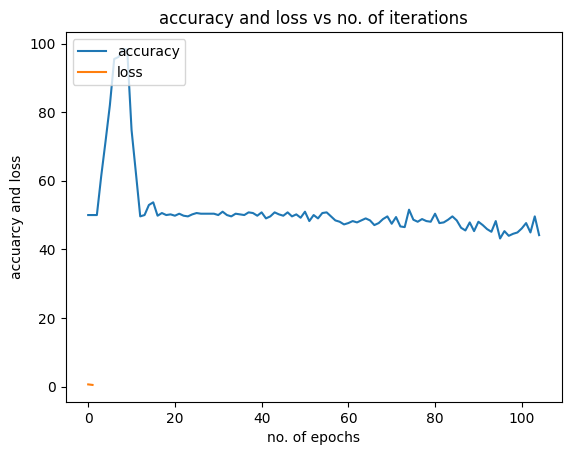

8/8 [==============================] - 0s 3ms/step


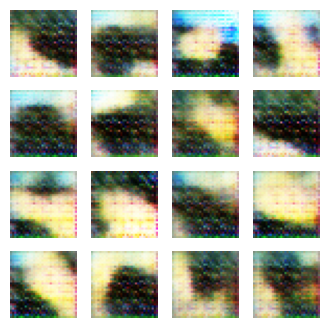

8/8 [==============================] - 0s 6ms/step
Iteration: 5251
8/8 [==============================] - 0s 3ms/step
Iteration: 5252
8/8 [==============================] - 0s 4ms/step
Iteration: 5253
8/8 [==============================] - 0s 4ms/step
Iteration: 5254
8/8 [==============================] - 0s 4ms/step
Iteration: 5255
8/8 [==============================] - 0s 3ms/step
Iteration: 5256
8/8 [==============================] - 0s 4ms/step
Iteration: 5257
8/8 [==============================] - 0s 4ms/step
Iteration: 5258
8/8 [==============================] - 0s 3ms/step
Iteration: 5259
8/8 [==============================] - 0s 4ms/step
Iteration: 5260
8/8 [==============================] - 0s 4ms/step
Iteration: 5261
8/8 [==============================] - 0s 3ms/step
Iteration: 5262
8/8 [==============================] - 0s 4ms/step
Iteration: 5263
8/8 [==============================] - 0s 3ms/step
Iteration: 5264
8/8 [==============================] - 0s 3ms/step
Iteration: 

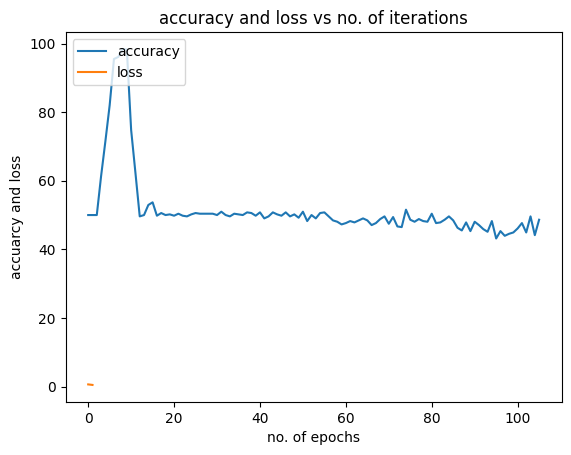

8/8 [==============================] - 0s 3ms/step


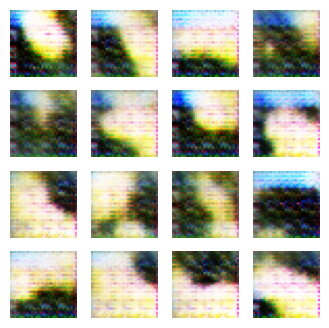

8/8 [==============================] - 0s 6ms/step
Iteration: 5301
8/8 [==============================] - 0s 4ms/step
Iteration: 5302
8/8 [==============================] - 0s 3ms/step
Iteration: 5303
8/8 [==============================] - 0s 5ms/step
Iteration: 5304
8/8 [==============================] - 0s 3ms/step
Iteration: 5305
8/8 [==============================] - 0s 3ms/step
Iteration: 5306
8/8 [==============================] - 0s 3ms/step
Iteration: 5307
8/8 [==============================] - 0s 3ms/step
Iteration: 5308
8/8 [==============================] - 0s 5ms/step
Iteration: 5309
8/8 [==============================] - 0s 4ms/step
Iteration: 5310
8/8 [==============================] - 0s 4ms/step
Iteration: 5311
8/8 [==============================] - 0s 5ms/step
Iteration: 5312
8/8 [==============================] - 0s 4ms/step
Iteration: 5313
8/8 [==============================] - 0s 3ms/step
Iteration: 5314
8/8 [==============================] - 0s 4ms/step
Iteration: 

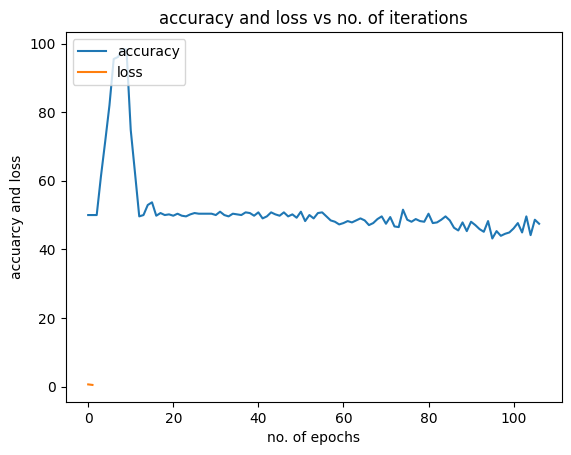

8/8 [==============================] - 0s 4ms/step


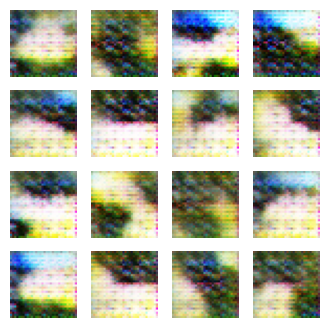

8/8 [==============================] - 0s 6ms/step
Iteration: 5351
8/8 [==============================] - 0s 4ms/step
Iteration: 5352
8/8 [==============================] - 0s 4ms/step
Iteration: 5353
8/8 [==============================] - 0s 4ms/step
Iteration: 5354
8/8 [==============================] - 0s 4ms/step
Iteration: 5355
8/8 [==============================] - 0s 3ms/step
Iteration: 5356
8/8 [==============================] - 0s 3ms/step
Iteration: 5357
8/8 [==============================] - 0s 4ms/step
Iteration: 5358
8/8 [==============================] - 0s 3ms/step
Iteration: 5359
8/8 [==============================] - 0s 3ms/step
Iteration: 5360
8/8 [==============================] - 0s 4ms/step
Iteration: 5361
8/8 [==============================] - 0s 3ms/step
Iteration: 5362
8/8 [==============================] - 0s 3ms/step
Iteration: 5363
8/8 [==============================] - 0s 4ms/step
Iteration: 5364
8/8 [==============================] - 0s 3ms/step
Iteration: 

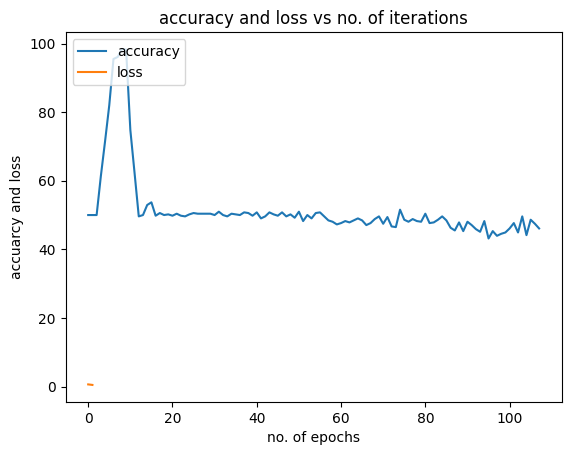

8/8 [==============================] - 0s 3ms/step


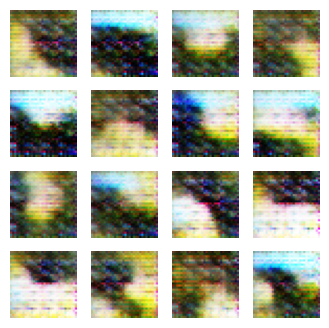

8/8 [==============================] - 0s 7ms/step
Iteration: 5401
8/8 [==============================] - 0s 4ms/step
Iteration: 5402
8/8 [==============================] - 0s 3ms/step
Iteration: 5403
8/8 [==============================] - 0s 3ms/step
Iteration: 5404
8/8 [==============================] - 0s 3ms/step
Iteration: 5405
8/8 [==============================] - 0s 3ms/step
Iteration: 5406
8/8 [==============================] - 0s 3ms/step
Iteration: 5407
8/8 [==============================] - 0s 4ms/step
Iteration: 5408
8/8 [==============================] - 0s 5ms/step
Iteration: 5409
8/8 [==============================] - 0s 6ms/step
Iteration: 5410
8/8 [==============================] - 0s 4ms/step
Iteration: 5411
8/8 [==============================] - 0s 5ms/step
Iteration: 5412
8/8 [==============================] - 0s 4ms/step
Iteration: 5413
8/8 [==============================] - 0s 5ms/step
Iteration: 5414
8/8 [==============================] - 0s 3ms/step
Iteration: 

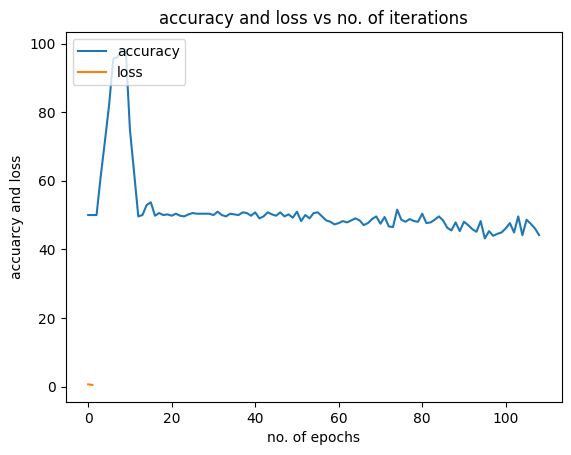

8/8 [==============================] - 0s 4ms/step


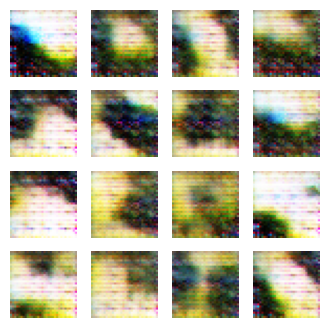

8/8 [==============================] - 0s 6ms/step
Iteration: 5451
8/8 [==============================] - 0s 4ms/step
Iteration: 5452
8/8 [==============================] - 0s 4ms/step
Iteration: 5453
8/8 [==============================] - 0s 3ms/step
Iteration: 5454
8/8 [==============================] - 0s 3ms/step
Iteration: 5455
8/8 [==============================] - 0s 3ms/step
Iteration: 5456
8/8 [==============================] - 0s 3ms/step
Iteration: 5457
8/8 [==============================] - 0s 4ms/step
Iteration: 5458
8/8 [==============================] - 0s 3ms/step
Iteration: 5459
8/8 [==============================] - 0s 3ms/step
Iteration: 5460
8/8 [==============================] - 0s 3ms/step
Iteration: 5461
8/8 [==============================] - 0s 3ms/step
Iteration: 5462
8/8 [==============================] - 0s 3ms/step
Iteration: 5463
8/8 [==============================] - 0s 3ms/step
Iteration: 5464
8/8 [==============================] - 0s 3ms/step
Iteration: 

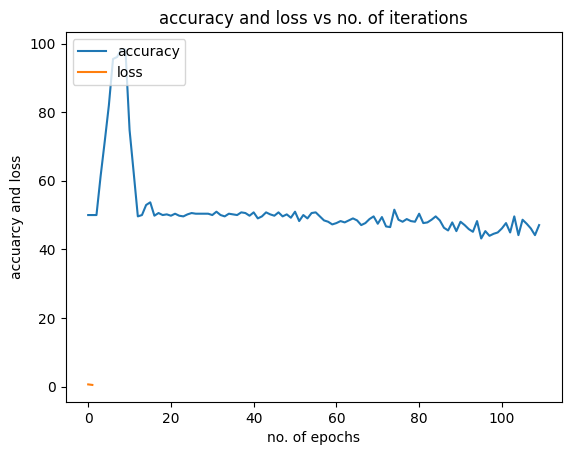

8/8 [==============================] - 0s 3ms/step


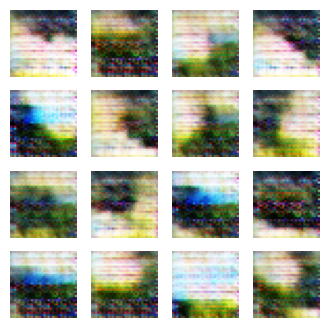

8/8 [==============================] - 0s 6ms/step
Iteration: 5501
8/8 [==============================] - 0s 4ms/step
Iteration: 5502
8/8 [==============================] - 0s 3ms/step
Iteration: 5503
8/8 [==============================] - 0s 3ms/step
Iteration: 5504
8/8 [==============================] - 0s 3ms/step
Iteration: 5505
8/8 [==============================] - 0s 4ms/step
Iteration: 5506
8/8 [==============================] - 0s 5ms/step
Iteration: 5507
8/8 [==============================] - 0s 4ms/step
Iteration: 5508
8/8 [==============================] - 0s 3ms/step
Iteration: 5509
8/8 [==============================] - 0s 4ms/step
Iteration: 5510
8/8 [==============================] - 0s 4ms/step
Iteration: 5511
8/8 [==============================] - 0s 4ms/step
Iteration: 5512
8/8 [==============================] - 0s 5ms/step
Iteration: 5513
8/8 [==============================] - 0s 4ms/step
Iteration: 5514
8/8 [==============================] - 0s 3ms/step
Iteration: 

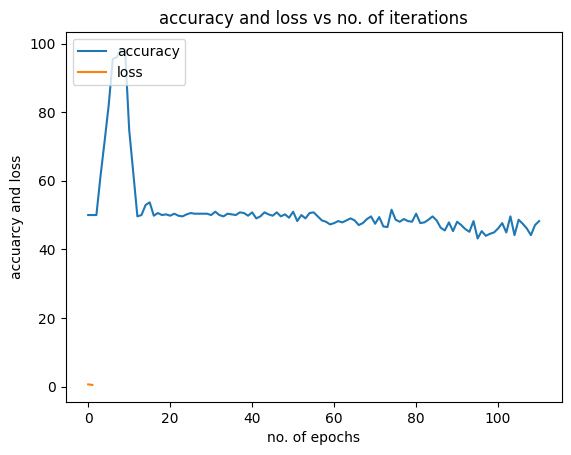

8/8 [==============================] - 0s 3ms/step


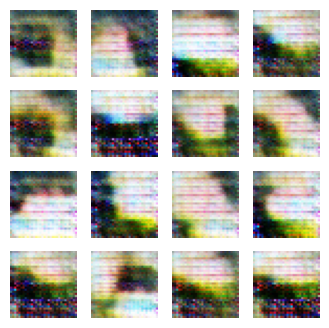

8/8 [==============================] - 0s 6ms/step
Iteration: 5551
8/8 [==============================] - 0s 4ms/step
Iteration: 5552
8/8 [==============================] - 0s 3ms/step
Iteration: 5553
8/8 [==============================] - 0s 4ms/step
Iteration: 5554
8/8 [==============================] - 0s 3ms/step
Iteration: 5555
8/8 [==============================] - 0s 3ms/step
Iteration: 5556
8/8 [==============================] - 0s 4ms/step
Iteration: 5557
8/8 [==============================] - 0s 4ms/step
Iteration: 5558
8/8 [==============================] - 0s 3ms/step
Iteration: 5559
8/8 [==============================] - 0s 3ms/step
Iteration: 5560
8/8 [==============================] - 0s 3ms/step
Iteration: 5561
8/8 [==============================] - 0s 4ms/step
Iteration: 5562
8/8 [==============================] - 0s 3ms/step
Iteration: 5563
8/8 [==============================] - 0s 4ms/step
Iteration: 5564
8/8 [==============================] - 0s 4ms/step
Iteration: 

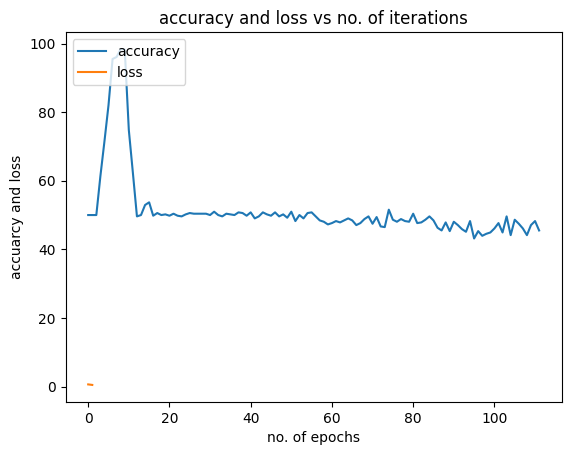

8/8 [==============================] - 0s 3ms/step


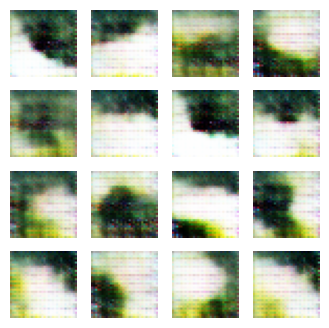

8/8 [==============================] - 0s 6ms/step
Iteration: 5601
8/8 [==============================] - 0s 3ms/step
Iteration: 5602
8/8 [==============================] - 0s 3ms/step
Iteration: 5603
8/8 [==============================] - 0s 3ms/step
Iteration: 5604
8/8 [==============================] - 0s 4ms/step
Iteration: 5605
8/8 [==============================] - 0s 3ms/step
Iteration: 5606
8/8 [==============================] - 0s 5ms/step
Iteration: 5607
8/8 [==============================] - 0s 4ms/step
Iteration: 5608
8/8 [==============================] - 0s 4ms/step
Iteration: 5609
8/8 [==============================] - 0s 4ms/step
Iteration: 5610
8/8 [==============================] - 0s 4ms/step
Iteration: 5611
8/8 [==============================] - 0s 4ms/step
Iteration: 5612
8/8 [==============================] - 0s 5ms/step
Iteration: 5613
8/8 [==============================] - 0s 4ms/step
Iteration: 5614
8/8 [==============================] - 0s 3ms/step
Iteration: 

In [ ]:
train_dcgan()